In [9]:
X_stream = df[features]
y_stream = df['Label_encoded']
dates_stream = df['Date'].reset_index(drop=True)
n_total = len(df)
window_size = 20

# ARF+ADWIN
arf_adwin = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
arf_adwin_pred = []

# ARF+ADWIN+Selective+Force Minor
arf_sel = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
arf_sel_pred = []
adwin_sel = drift.ADWIN()
y_true_window_sel = deque(maxlen=window_size)
y_pred_window_sel = deque(maxlen=window_size)
selective_mode = True  # Flag for selective update
cooldown = 30  # Optional: cooldown after drift

# Simpan untuk F1-score & plotting
rf_pred = []
arf_adwin_pred = []
arf_sel_pred = []
all_true = []
adwin_drift_point = []  # For visualization

for i, (x, y) in tqdm(enumerate(stream.iter_pandas(X_stream, y_stream)), total=n_total, desc='Streaming Models'):
    # --- Static RF ---
    x_df = pd.DataFrame([x])
    y_pred_rf = rf_model.predict(x_df)[0]
    rf_pred.append(y_pred_rf)

    # --- ARF+ADWIN (Standard) ---
    y_pred_adwin = arf_adwin.predict_one(x)
    arf_adwin_pred.append(int(y_pred_adwin) if y_pred_adwin is not None else 0)
    arf_adwin.learn_one(x, y)

    # --- ARF+ADWIN+Selective+Force Minor ---
    y_pred_sel = arf_sel.predict_one(x)
    arf_sel_pred.append(int(y_pred_sel) if y_pred_sel is not None else 0)
    y_true_window_sel.append(y)
    y_pred_window_sel.append(y_pred_sel if y_pred_sel is not None else 0)
    all_true.append(int(y))

    # --- Update Selective (rolling F1 window) ---
    f1_before = None
    f1_after = None
    import copy
    if len(y_true_window_sel) == window_size:
        metric = metrics.F1()
        for yt, yp in zip(y_true_window_sel, y_pred_window_sel):
            metric.update(yt, yp)
        f1_before = metric.get()

        arf_temp = copy.deepcopy(arf_sel)
        arf_temp.learn_one(x, y)
        y_pred_temp = arf_temp.predict_one(x)
        temp_pred_window = deque(list(y_pred_window_sel), maxlen=window_size)
        temp_pred_window[-1] = y_pred_temp if y_pred_temp is not None else 0
        metric_temp = metrics.F1()
        for yt, yp in zip(y_true_window_sel, temp_pred_window):
            metric_temp.update(yt, yp)
        f1_after = metric_temp.get()

    # --- Drift Detection ---
    error = int(y_pred_sel != y) if y_pred_sel is not None else 1
    adwin_sel.update(error)
    if adwin_sel.drift_detected:
        selective_mode = False
        drift_count = cooldown  # Non-s elective for 'cooldown' steps
        adwin_drift_point.append(i)
    if not selective_mode:
        arf_sel.learn_one(x, y)
        drift_count -= 1
        if drift_count <= 0:
            selective_mode = True
    else:
        # Hybrid update
        if y != 0:
            arf_sel.learn_one(x, y)
        elif f1_before is None or f1_after is None or f1_after >= f1_before:
            arf_sel.learn_one(x, y)
    # else: skip update


Streaming Models:   0%|          | 0/8267 [00:00<?, ?it/s]

Streaming Models:   1%|▏         | 109/8267 [00:02<03:01, 45.02it/s]


KeyboardInterrupt: 

In [ ]:
!pip install imblearn


Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [4]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from river import forest, drift, stream, metrics
from collections import deque
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE

In [ ]:


# Load & prepare data (sudah Anda lakukan)
df = pd.read_csv('C:\\Users\\geose\\Downloads\\ml\\df.csv')
df['Date'] = pd.to_datetime(df['Date'], format='%m/%d/%Y')
features = ['VA', 'EVA', 'VB', 'EVB', 'LF', 'E', 'MP', 'EMP', 'ETOT', 'kumulatif']
df[features] = df[features].fillna(0)
df['Label_encoded'] = df['Label'].map({'Non': 0, 'Efusif': 1, 'Eksplosif': 2})

# Cutoff for static training
cutoff = pd.to_datetime("1999-12-31")
X_train = df[df['Date'] <= cutoff][features]
y_train = df[df['Date'] <= cutoff]['Label_encoded']

# 1. Train Static RF
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# 2. Train RF + SMOTE (tanpa mengganggu streaming loop)
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

rf_smote_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_smote_model.fit(X_train_smote, y_train_smote)


RandomForestClassifier(random_state=42)

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from collections import deque, Counter
from tqdm import tqdm
import random

from river import forest, metrics, stream, drift
X_stream = df[features]                  # start from index 0
y_stream = df['Label_encoded']
dates_stream = df['Date'].reset_index(drop=True)
n_total = len(df)   

# Init ARF
arf_sel = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
arf_adwin = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
adwin_sel = drift.ADWIN()

arf_sel_pred, arf_adwin_pred = [], []
rf_pred, rf_smote_pred, all_true = [], [], []
minority_buffer = deque(maxlen=30)
y_window = deque(maxlen=100)

def closest_pair(buffer):
    X = [list(x.values()) for x in buffer]
    dists = [((i, j), np.linalg.norm(np.array(X[i]) - np.array(X[j])))
             for i in range(len(X)) for j in range(i + 1, len(X))]
    if not dists:
        return buffer[0], buffer[0]
    (i, j), _ = min(dists, key=lambda x: x[1])
    return buffer[i], buffer[j]

# Start streaming loop for each instance in the data stream
for i, (x, y) in tqdm(enumerate(stream.iter_pandas(X_stream, y_stream)), total=n_total):

    # Convert instance x to a DataFrame to allow static RF prediction
    x_df = pd.DataFrame([x])

    # === STATIC BASELINE PREDICTIONS ===
    # Predict using a static Random Forest trained up to cutoff (1999)
    rf_pred.append(rf_model.predict(x_df)[0])

    # Predict using a static RF model trained with SMOTE-balanced data
    rf_smote_pred.append(rf_smote_model.predict(x_df)[0])

    # === ADAPTIVE RANDOM FOREST WITH ADWIN ===
    # Predict class using ARF with ADWIN drift detector (no oversampling)
    y_pred_adwin = arf_adwin.predict_one(x)
    y_pred_adwin = int(y_pred_adwin) if y_pred_adwin is not None else 0
    arf_adwin_pred.append(y_pred_adwin)

    # Update ARF+ADWIN model with the true label
    arf_adwin.learn_one(x, y)

    # === ARF IV.A: CONFIDENCE-AWARE + ONLINE SMOTE ===
    # Predict class using ARF IV.A (selective oversampling + drift response)
    y_pred_sel = arf_sel.predict_one(x)
    y_pred_sel = int(y_pred_sel) if y_pred_sel is not None else 0
    arf_sel_pred.append(y_pred_sel)
    all_true.append(y)

    # Maintain a sliding window of true labels to identify the minority class dynamically
    y_window.append(y)
    if len(y_window) < y_window.maxlen:
        # Allow initial learning before confidence-aware logic activates
        arf_sel.learn_one(x, y)
        continue

    # Determine the current minority class from recent labels in the window
    y_counts = Counter(y_window)
    minority_class = min(y_counts, key=y_counts.get)

    # Train ARF IV.A model on the actual input instance
    arf_sel.learn_one(x, y)

    # === CONFIDENCE-AWARE SYNTHETIC OVERSAMPLING ===
    # Retrieve the class probability distribution (confidence scores)
    proba = arf_sel.predict_proba_one(x)
    conf = proba.get(y, 0)  # Confidence in the correct class

    # Only proceed if the instance belongs to the minority class AND the model lacks confidence
    if y == minority_class and conf < 0.8 and i % 10 == 0:

        # Add the instance to a memory buffer for the minority class
        minority_buffer.append(x)

        # Generate a synthetic sample only when at least two buffer elements are available
        if len(minority_buffer) >= 2:
            # Select the closest pair based on Euclidean distance
            x1, x2 = closest_pair(minority_buffer)

            # Interpolate between x1 and x2 to create a synthetic instance, with minor noise
            synthetic_sample = {
                k: (x1[k] + x2[k]) / 2 + random.gauss(0, 0.01)
                for k in x1
            }

            # Inject the synthetic sample into the ARF IV.A learner
            arf_sel.learn_one(synthetic_sample, y)

    # === DRIFT-AWARE LIGHT RETRAINING ===
    # Update drift detector based on prediction error
    error = int(y_pred_sel != y)
    if adwin_sel.update(error) and adwin_sel.drift_detected:
        # Upon drift detection, retrain model lightly using synthetic minority samples
        for s in random.sample(list(minority_buffer), min(5, len(minority_buffer))):
            arf_sel.learn_one(s, minority_class)

  0%|          | 16/8267 [00:00<01:48, 76.34it/s]


KeyboardInterrupt: 

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from collections import deque, Counter
from tqdm import tqdm
import random
import time
from imblearn.over_sampling import SMOTE

from river import forest, metrics, stream, drift, tree

# ===== UPDATED RETRAINING RF CLASS - PER INSTANCE RETRAINING =====
class RetrainingRFTracker:
    def __init__(self, use_smote=False, buffer_size=1000):
        self.use_smote = use_smote
        self.buffer_size = buffer_size
        self.model = RandomForestClassifier(n_estimators=100, random_state=42)
        self.smote = SMOTE(random_state=42) if use_smote else None
        
        # Training data buffer (rolling window)
        self.training_buffer = deque(maxlen=buffer_size)
        
        # Performance tracking
        self.total_retraining_time = 0
        self.retraining_count = 0
        self.predictions = []
        
        # Initial training
        self._initial_train()
        
    def _initial_train(self):
        start_time = time.time()
        if self.use_smote and len(np.unique(y_train)) > 1:
            X_resampled, y_resampled = self.smote.fit_resample(X_train, y_train)
            self.model.fit(X_resampled, y_resampled)
        else:
            self.model.fit(X_train, y_train)
        
        training_time = time.time() - start_time
        self.total_retraining_time += training_time
        self.retraining_count += 1
        print(f"Initial training ({'RF+SMOTE' if self.use_smote else 'RF'}): {training_time:.3f}s")
    
    def _retrain_on_buffer(self):
        """Retrain model using current buffer data"""
        if len(self.training_buffer) < 50:  # Need minimum samples
            return
            
        start_time = time.time()
        
        # Convert buffer to arrays
        X_buffer = np.array([list(x.values()) for x, _ in self.training_buffer])
        y_buffer = np.array([y for _, y in self.training_buffer])
        
        # Retrain model on buffer
        if self.use_smote and len(np.unique(y_buffer)) > 1:
            try:
                X_resampled, y_resampled = self.smote.fit_resample(X_buffer, y_buffer)
                self.model.fit(X_resampled, y_resampled)
            except:
                self.model.fit(X_buffer, y_buffer)
        else:
            self.model.fit(X_buffer, y_buffer)
        
        training_time = time.time() - start_time
        self.total_retraining_time += training_time
        self.retraining_count += 1
        
    def predict_and_learn(self, x, y_true, instance_count):
        # Convert to DataFrame for prediction
        x_df = pd.DataFrame([x])
        y_pred = self.model.predict(x_df)[0]
        self.predictions.append(y_pred)
        
        # Add new instance to training buffer
        self.training_buffer.append((x, y_true))
        
        # RETRAIN ON EVERY INSTANCE (per one row)
        if len(self.training_buffer) >= 50:  # Only start retraining after minimum buffer
            self._retrain_on_buffer()
            
        return y_pred
    
    def get_stats(self):
        return {
            'total_retraining_time': self.total_retraining_time,
            'retraining_count': self.retraining_count,
            'avg_retraining_time': self.total_retraining_time / self.retraining_count if self.retraining_count > 0 else 0
        }

# ===== INITIALIZE ALL MODELS WITH UPDATED RETRAINING =====
X_stream = df[features]
y_stream = df['Label_encoded']
dates_stream = df['Date'].reset_index(drop=True)
n_total = len(df)

# Static RF models (baseline)
rf_static = rf_model  # Already trained
rf_smote_static = rf_smote_model  # Already trained

# Retraining RF models - NOW RETRAINS PER INSTANCE
rf_retrain = RetrainingRFTracker(use_smote=False, buffer_size=500)  # Smaller buffer for efficiency
rf_smote_retrain = RetrainingRFTracker(use_smote=True, buffer_size=500)

# ARF models
arf_sel = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
arf_adwin = forest.ARFClassifier(n_models=10, drift_detector=drift.ADWIN(), seed=42)
adwin_sel = drift.ADWIN()

# HT models
ht_adwin = tree.HoeffdingTreeClassifier()
ht_sel = tree.HoeffdingTreeClassifier()
adwin_ht = drift.ADWIN()
adwin_ht_iv = drift.ADWIN()

# Prediction storage for ALL models
static_rf_pred = []
static_rf_smote_pred = []
retrain_rf_pred = []
retrain_rf_smote_pred = []
arf_sel_pred, arf_adwin_pred = [], []
ht_adwin_pred, ht_sel_pred = [], []
all_true = []

# Time tracking variables
arf_adwin_total_time = 0
arf_sel_total_time = 0
ht_adwin_total_time = 0
ht_sel_total_time = 0

# Buffers for minority class handling
minority_buffer = deque(maxlen=30)
minority_buffer_ht = deque(maxlen=30)
y_window = deque(maxlen=100)
y_window_ht = deque(maxlen=100)

def closest_pair(buffer):
    if len(buffer) < 2:
        return buffer[0], buffer[0] if buffer else ({}, {})
    X = [list(x.values()) for x in buffer]
    dists = [((i, j), np.linalg.norm(np.array(X[i]) - np.array(X[j])))
             for i in range(len(X)) for j in range(i + 1, len(X))]
    if not dists:
        return buffer[0], buffer[0]
    (i, j), _ = min(dists, key=lambda x: x[1])
    return buffer[i], buffer[j]

# ===== MAIN STREAMING LOOP =====
print("Starting streaming evaluation with ALL models...")
print("NOTE: Retraining RF models will retrain on EVERY INSTANCE after initial buffer")

for i, (x, y) in tqdm(enumerate(stream.iter_pandas(X_stream, y_stream)), total=n_total):
    
    # Convert instance x to a DataFrame
    x_df = pd.DataFrame([x])
    all_true.append(y)

    # === STATIC RF PREDICTIONS ===
    static_rf_pred.append(rf_static.predict(x_df)[0])
    static_rf_smote_pred.append(rf_smote_static.predict(x_df)[0])

    # === RETRAINING RF PREDICTIONS (PER INSTANCE) ===
    retrain_rf_pred.append(rf_retrain.predict_and_learn(x, y, i))
    retrain_rf_smote_pred.append(rf_smote_retrain.predict_and_learn(x, y, i))

    # === ARF + ADWIN (with timing) ===
    start_time = time.time()
    y_pred_adwin = arf_adwin.predict_one(x)
    y_pred_adwin = int(y_pred_adwin) if y_pred_adwin is not None else 0
    arf_adwin_pred.append(y_pred_adwin)
    arf_adwin.learn_one(x, y)
    arf_adwin_total_time += time.time() - start_time

    # === ARF IV.A: CONFIDENCE-AWARE + ONLINE SMOTE (with timing) ===
    start_time = time.time()
    y_pred_sel = arf_sel.predict_one(x)
    y_pred_sel = int(y_pred_sel) if y_pred_sel is not None else 0
    arf_sel_pred.append(y_pred_sel)

    y_window.append(y)
    if len(y_window) < y_window.maxlen:
        arf_sel.learn_one(x, y)
    else:
        minority_class = min(Counter(y_window), key=Counter(y_window).get)
        arf_sel.learn_one(x, y)
        
        # === CONFIDENCE-AWARE SYNTHETIC OVERSAMPLING ===
        proba = arf_sel.predict_proba_one(x)
        conf = proba.get(y, 0)
        if y == minority_class and conf < 0.6 and i % 10 == 0:
            minority_buffer.append(x)
            if len(minority_buffer) >= 2:
                x1, x2 = closest_pair(minority_buffer)
                synthetic_sample = {k: (x1[k] + x2[k]) / 2 + random.gauss(0, 0.01) for k in x1}
                arf_sel.learn_one(synthetic_sample, y)
        
        # === DRIFT-AWARE LIGHT RETRAINING ===
        if adwin_sel.update(int(y_pred_sel != y)) and adwin_sel.drift_detected:
            for s in random.sample(list(minority_buffer), min(5, len(minority_buffer))):
                arf_sel.learn_one(s, minority_class)
    
    arf_sel_total_time += time.time() - start_time

    # === HT + ADWIN (with timing) ===
    start_time = time.time()
    y_pred_ht = ht_adwin.predict_one(x)
    y_pred_ht = int(y_pred_ht) if y_pred_ht is not None else 0
    ht_adwin_pred.append(y_pred_ht)
    ht_adwin.learn_one(x, y)
    if adwin_ht.update(int(y_pred_ht != y)) and adwin_ht.drift_detected:
        ht_adwin = tree.HoeffdingTreeClassifier()
    ht_adwin_total_time += time.time() - start_time

    # === HT IV.A (with timing) ===
    start_time = time.time()
    y_pred_ht_iv = ht_sel.predict_one(x)
    y_pred_ht_iv = int(y_pred_ht_iv) if y_pred_ht_iv is not None else 0
    ht_sel_pred.append(y_pred_ht_iv)

    y_window_ht.append(y)
    if len(y_window_ht) < y_window_ht.maxlen:
        ht_sel.learn_one(x, y)
    else:
        minority_class_ht = min(Counter(y_window_ht), key=Counter(y_window_ht).get)
        ht_sel.learn_one(x, y)
        proba_ht = ht_sel.predict_proba_one(x)
        conf_ht = proba_ht.get(y, 0)
        if y == minority_class_ht and conf_ht < 0.6 and i % 10 == 0:
            minority_buffer_ht.append(x)
            if len(minority_buffer_ht) >= 2:
                x1, x2 = closest_pair(minority_buffer_ht)
                synthetic_sample_ht = {k: (x1[k] + x2[k]) / 2 + random.gauss(0, 0.01) for k in x1}
                ht_sel.learn_one(synthetic_sample_ht, y)
        if adwin_ht_iv.update(int(y_pred_ht_iv != y)) and adwin_ht_iv.drift_detected:
            for s in random.sample(list(minority_buffer_ht), min(5, len(minority_buffer_ht))):
                ht_sel.learn_one(s, minority_class_ht)
    
    ht_sel_total_time += time.time() - start_time

print("\n✅ Streaming evaluation complete!")

# ===== PERFORMANCE SUMMARY WITH TIMING =====
print("\n" + "="*80)
print("COMPREHENSIVE PERFORMANCE & EFFICIENCY COMPARISON")
print("="*80)

# Get retraining statistics
rf_stats = rf_retrain.get_stats()
rf_smote_stats = rf_smote_retrain.get_stats()

print(f"\n📊 RETRAINING STATISTICS (PER INSTANCE):")
print(f"RF Retraining Count: {rf_stats['retraining_count']}")
print(f"RF+SMOTE Retraining Count: {rf_smote_stats['retraining_count']}")

print(f"\n⏱️  TOTAL TRAINING/LEARNING TIME:")
print(f"Retraining RF Total Time: {rf_stats['total_retraining_time']:.3f}s")
print(f"Retraining RF+SMOTE Total Time: {rf_smote_stats['total_retraining_time']:.3f}s")
print(f"ARF+ADWIN Total Time: {arf_adwin_total_time:.3f}s")
print(f"ARF IV.A Total Time: {arf_sel_total_time:.3f}s")
print(f"HT+ADWIN Total Time: {ht_adwin_total_time:.3f}s")
print(f"HT IV.A Total Time: {ht_sel_total_time:.3f}s")

print(f"\n📈 AVERAGE TIME PER INSTANCE:")
print(f"Retraining RF: ~{(rf_stats['total_retraining_time']/n_total)*1000:.3f}ms per instance")
print(f"Retraining RF+SMOTE: ~{(rf_smote_stats['total_retraining_time']/n_total)*1000:.3f}ms per instance")
print(f"ARF+ADWIN: ~{(arf_adwin_total_time/n_total)*1000:.3f}ms per instance")
print(f"ARF IV.A: ~{(arf_sel_total_time/n_total)*1000:.3f}ms per instance")
print(f"HT+ADWIN: ~{(ht_adwin_total_time/n_total)*1000:.3f}ms per instance")
print(f"HT IV.A: ~{(ht_sel_total_time/n_total)*1000:.3f}ms per instance")

print(f"\n🎯 EFFICIENCY RATIO (Incremental vs Batch Per-Instance):")
rf_total_time = rf_stats['total_retraining_time']
if rf_total_time > 0:
    print(f"ARF+ADWIN is {rf_total_time/arf_adwin_total_time:.1f}x faster than Per-Instance Retraining RF")
    print(f"ARF IV.A is {rf_total_time/arf_sel_total_time:.1f}x faster than Per-Instance Retraining RF")
    print(f"HT+ADWIN is {rf_total_time/ht_adwin_total_time:.1f}x faster than Per-Instance Retraining RF")
    print(f"HT IV.A is {rf_total_time/ht_sel_total_time:.1f}x faster than Per-Instance Retraining RF")

# Final F1 scores
models_data = {
    'Static RF': static_rf_pred,
    'Static RF + SMOTE': static_rf_smote_pred,
    'Per-Instance Retraining RF': retrain_rf_pred,
    'Per-Instance Retraining RF + SMOTE': retrain_rf_smote_pred,
    'ARF + ADWIN': arf_adwin_pred,
    'ARF IV.A': arf_sel_pred,
    'HT + ADWIN': ht_adwin_pred,
    'HT IV.A': ht_sel_pred
}

print("\n🎯 FINAL F1-SCORE COMPARISON:")
for model_name, predictions in models_data.items():
    f1 = f1_score(all_true, predictions, average='weighted')
    print(f"{model_name}: {f1:.4f}")

# Update variable names for compatibility with existing plotting code
rf_pred = static_rf_pred
rf_smote_pred = static_rf_smote_pred

print("\n✅ All models ready for analysis and plotting!")
print("Variables available: rf_pred, rf_smote_pred, retrain_rf_pred, retrain_rf_smote_pred")
print("                    arf_adwin_pred, arf_sel_pred, ht_adwin_pred, ht_sel_pred")
print("\n⚠️  NOTE: Per-instance retraining will be MUCH slower than incremental methods!")

Initial training (RF): 0.489s
Initial training (RF+SMOTE): 1.630s
Starting streaming evaluation with ALL models...
NOTE: Retraining RF models will retrain on EVERY INSTANCE after initial buffer


  1%|          | 49/8267 [00:01<03:27, 39.55it/s]c:\Users\geose\anaconda3\envs\rivera\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
c:\Users\geose\anaconda3\envs\rivera\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
c:\Users\geose\anaconda3\envs\rivera\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
c:\Users\geose\anaconda3\envs\rivera\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
c:\Users\geose\anaconda3\envs\rivera\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
c:\Users\geose\a


✅ Streaming evaluation complete!

COMPREHENSIVE PERFORMANCE & EFFICIENCY COMPARISON

📊 RETRAINING STATISTICS (PER INSTANCE):
RF Retraining Count: 8219
RF+SMOTE Retraining Count: 8219

⏱️  TOTAL TRAINING/LEARNING TIME:
Retraining RF Total Time: 1151.484s
Retraining RF+SMOTE Total Time: 1255.438s
ARF+ADWIN Total Time: 13.580s
ARF IV.A Total Time: 14.902s
HT+ADWIN Total Time: 1.336s
HT IV.A Total Time: 2.140s

📈 AVERAGE TIME PER INSTANCE:
Retraining RF: ~139.287ms per instance
Retraining RF+SMOTE: ~151.861ms per instance
ARF+ADWIN: ~1.643ms per instance
ARF IV.A: ~1.803ms per instance
HT+ADWIN: ~0.162ms per instance
HT IV.A: ~0.259ms per instance

🎯 EFFICIENCY RATIO (Incremental vs Batch Per-Instance):
ARF+ADWIN is 84.8x faster than Per-Instance Retraining RF
ARF IV.A is 77.3x faster than Per-Instance Retraining RF
HT+ADWIN is 862.0x faster than Per-Instance Retraining RF
HT IV.A is 538.1x faster than Per-Instance Retraining RF

🎯 FINAL F1-SCORE COMPARISON:
Static RF: 0.9353
Static RF + 

In [ ]:
import river
print(river.__version__)

import sklearn
print(sklearn.__version__)


0.19.0
1.3.2


In [5]:
import pandas as pd
from sklearn.metrics import classification_report
import numpy as np

# This code assumes that the following variables are already available in your notebook's environment:
# 'dates_stream', 'all_true', 'rf_pred', 'rf_smote_pred',
# 'arf_adwin_pred', 'arf_sel_pred', 'ht_adwin_pred', and 'ht_sel_pred'

# 1. Create a DataFrame with your data
data = {
    'Date': dates_stream,
    'y_true': all_true,
    'Static RF': rf_pred,
    'RF + SMOTE': rf_smote_pred,
    'ARF + ADWIN': arf_adwin_pred,
    'ARF IV.A': arf_sel_pred,
    'HT + ADWIN': ht_adwin_pred,
    'HT IV.A': ht_sel_pred
}
results_df = pd.DataFrame(data)

# 2. Convert the 'Date' column to datetime objects and set it as the DataFrame index
results_df['Date'] = pd.to_datetime(results_df['Date'])
results_df.set_index('Date', inplace=True)

# 3. Define a function to calculate the F1-score for each class
def calculate_f1_per_class(group):
    if len(group) == 0:
        return None
    
    unique_labels = sorted(np.unique(all_true))
    model_names = ['Static RF', 'RF + SMOTE', 'ARF + ADWIN', 'ARF IV.A', 'HT + ADWIN', 'HT IV.A']
    all_scores = {}

    for model in model_names:
        report = classification_report(
            group['y_true'], 
            group[model], 
            output_dict=True, 
            labels=unique_labels, 
            zero_division=0
        )
        for label in unique_labels:
            class_key = str(label)
            column_name = f"{model}_F1_Class_{class_key}"
            all_scores[column_name] = report[class_key]['f1-score']
            
    return pd.Series(all_scores)

# 4. Resample the data into 3-month periods and apply the calculation
quarterly_f1_per_class = results_df.resample('3M').apply(calculate_f1_per_class)

# 5. Clean up the final DataFrame and display it
final_table = quarterly_f1_per_class.round(3).dropna(how='all')
print("F1-Score For Every 3 Months (Per Class)")
print(final_table)

# 6. Save the DataFrame to a CSV file
final_table.to_csv('f1_scores_per_class_quarterly.csv')

print("\nSuccessfully saved the table to 'f1_scores_per_class_quarterly.csv'")

F1-Score For Every 3 Months (Per Class)
            Static RF_F1_Class_0  Static RF_F1_Class_1  Static RF_F1_Class_2  \
Date                                                                           
1991-01-31                 1.000                   0.0                   0.0   
1991-04-30                 1.000                   0.0                   0.0   
1991-07-31                 1.000                   0.0                   0.0   
1991-10-31                 1.000                   0.0                   0.0   
1992-01-31                 1.000                   1.0                   0.0   
...                          ...                   ...                   ...   
2012-10-31                 0.972                   0.0                   0.0   
2013-01-31                 0.983                   0.0                   0.0   
2013-04-30                 1.000                   0.0                   0.0   
2013-07-31                 0.955                   0.0                   0.0   


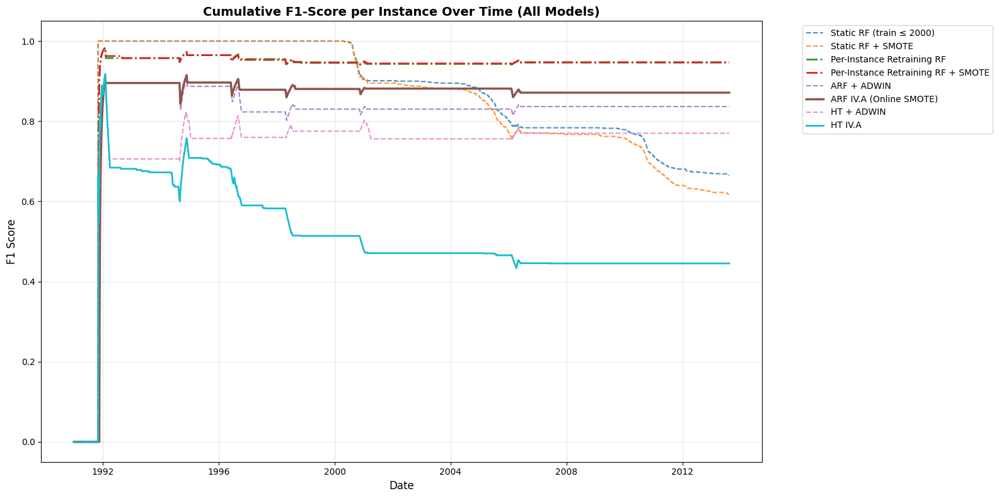


🎯 FINAL CUMULATIVE F1-SCORES:
Static RF (train ≤ 2000): 0.6652
Static RF + SMOTE: 0.6176
Per-Instance Retraining RF: 0.9463
Per-Instance Retraining RF + SMOTE: 0.9472
ARF + ADWIN: 0.8366
ARF IV.A (Online SMOTE): 0.8712
HT + ADWIN: 0.7700
HT IV.A: 0.4452


In [6]:
def cumulative_f1(y_true_list, y_pred_list):
    f1_scores = []
    f1_metric = metrics.F1()
    for yt, yp in zip(y_true_list, y_pred_list):
        f1_metric.update(yt, yp)
        f1_scores.append(f1_metric.get())
    return f1_scores

# Hitung semua cumulative F1 - INCLUDING RETRAINING MODELS
cum_f1_rf = cumulative_f1(all_true, rf_pred)
cum_f1_rf_smote = cumulative_f1(all_true, rf_smote_pred)
cum_f1_retrain_rf = cumulative_f1(all_true, retrain_rf_pred)
cum_f1_retrain_rf_smote = cumulative_f1(all_true, retrain_rf_smote_pred)
cum_f1_arf_adwin = cumulative_f1(all_true, arf_adwin_pred)
cum_f1_arf_iva = cumulative_f1(all_true, arf_sel_pred)
cum_f1_ht_adwin = cumulative_f1(all_true, ht_adwin_pred)
cum_f1_ht_iva = cumulative_f1(all_true, ht_sel_pred)

plt.figure(figsize=(16, 8))
# Definisikan warna untuk tiap model
color_rf = '#1f77b4'           # blue
color_rf_smote = '#ff7f0e'     # orange
color_retrain_rf = '#2ca02c'   # green
color_retrain_rf_smote = '#d62728'  # red
color_arf_adwin = '#9467bd'    # purple
color_arf_iva = '#8c564b'      # brown
color_ht_adwin = '#e377c2'     # pink
color_ht_iva = '#17becf'       # cyan

# Plot semua model - Static baselines
plt.plot(dates_stream, cum_f1_rf, label='Static RF (train ≤ 2000)', linestyle='--', color=color_rf, alpha=0.8)
plt.plot(dates_stream, cum_f1_rf_smote, label='Static RF + SMOTE', linestyle='--', color=color_rf_smote, alpha=0.8)

# Plot retraining models
plt.plot(dates_stream, cum_f1_retrain_rf, label='Per-Instance Retraining RF', linestyle='-.', color=color_retrain_rf, linewidth=2)
plt.plot(dates_stream, cum_f1_retrain_rf_smote, label='Per-Instance Retraining RF + SMOTE', linestyle='-.', color=color_retrain_rf_smote, linewidth=2)

# Plot incremental learning models
plt.plot(dates_stream, cum_f1_arf_adwin, label='ARF + ADWIN', linestyle='--', color=color_arf_adwin, alpha=0.8)
plt.plot(dates_stream, cum_f1_arf_iva, label='ARF IV.A (Online SMOTE)', linestyle='-', color=color_arf_iva, linewidth=2.5)  # Highlight proposed method
plt.plot(dates_stream, cum_f1_ht_adwin, label='HT + ADWIN', linestyle='--', color=color_ht_adwin, alpha=0.8)
plt.plot(dates_stream, cum_f1_ht_iva, label='HT IV.A', linestyle='-', color=color_ht_iva, linewidth=2)

# Improve legend positioning and readability
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.grid(True, alpha=0.3)
plt.title("Cumulative F1-Score per Instance Over Time (All Models)", fontsize=14, fontweight='bold')
plt.xlabel("Date", fontsize=12)
plt.ylabel("F1 Score", fontsize=12)
plt.tight_layout()
plt.show()

# Print final scores for comparison
print("\n🎯 FINAL CUMULATIVE F1-SCORES:")
models_cum_f1 = {
    'Static RF (train ≤ 2000)': cum_f1_rf[-1],
    'Static RF + SMOTE': cum_f1_rf_smote[-1],
    'Per-Instance Retraining RF': cum_f1_retrain_rf[-1],
    'Per-Instance Retraining RF + SMOTE': cum_f1_retrain_rf_smote[-1],
    'ARF + ADWIN': cum_f1_arf_adwin[-1],
    'ARF IV.A (Online SMOTE)': cum_f1_arf_iva[-1],
    'HT + ADWIN': cum_f1_ht_adwin[-1],
    'HT IV.A': cum_f1_ht_iva[-1]
}

for model_name, final_f1 in models_cum_f1.items():
    print(f"{model_name}: {final_f1:.4f}")

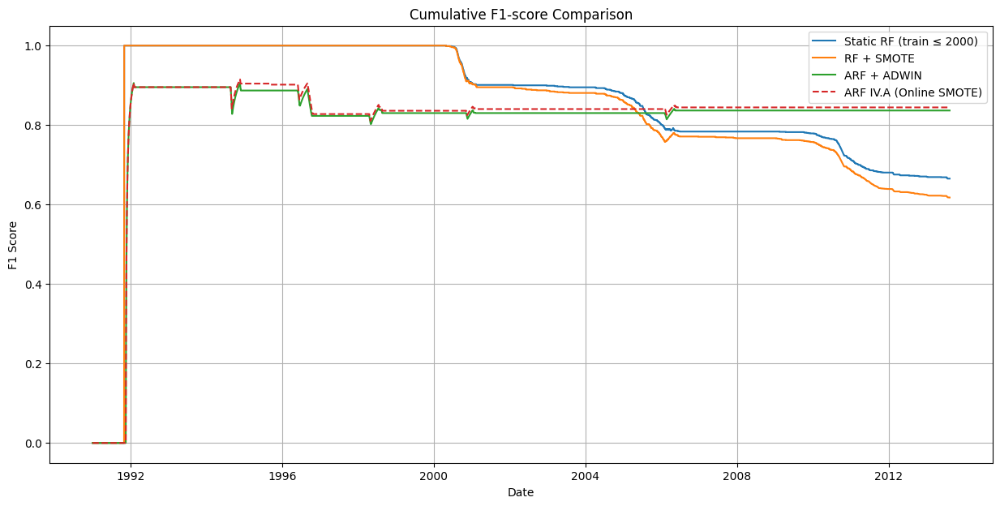

In [ ]:
def cumulative_f1(y_true_list, y_pred_list):
    f1_scores = []
    metric = metrics.F1()
    for yt, yp in zip(y_true_list, y_pred_list):
        metric.update(yt, yp)
        f1_scores.append(metric.get())
    return f1_scores

f1_rf = cumulative_f1(all_true, rf_pred)
f1_adwin = cumulative_f1(all_true, arf_adwin_pred)
f1_smote = cumulative_f1(all_true, arf_sel_pred)

plt.figure(figsize=(15, 7))
plt.plot(dates_stream, cum_f1_rf, label='Static RF (train ≤ 2000)')
plt.plot(dates_stream, cum_f1_rf_smote, label='RF + SMOTE')
plt.plot(dates_stream, cum_f1_arf_adwin, label='ARF + ADWIN')
plt.plot(dates_stream, cum_f1_arf_iva, label='ARF IV.A (Online SMOTE)', linestyle='--')

plt.legend()
plt.title("Cumulative F1-score Comparison")
plt.xlabel("Date")
plt.ylabel("F1 Score")
plt.grid(True)
plt.show()


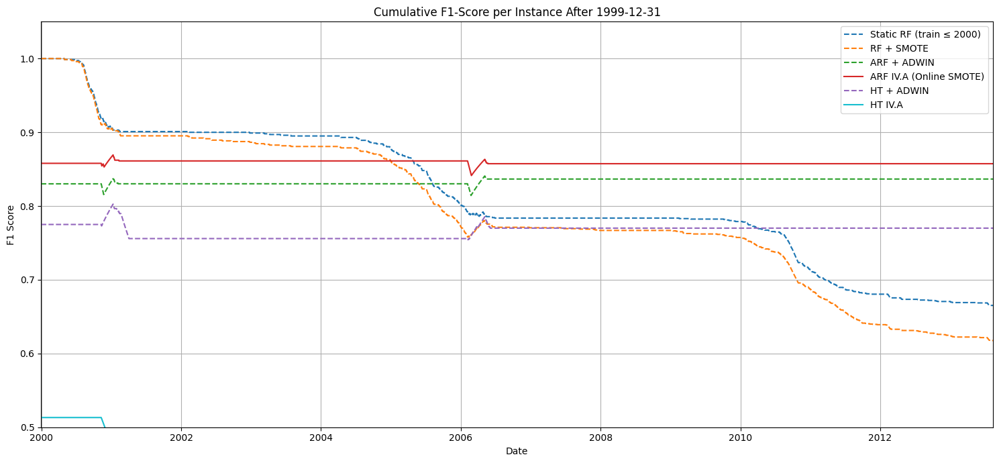

In [ ]:
import datetime

# Definisikan tanggal batas bawah
threshold_date = datetime.datetime.strptime('1999-12-31', '%Y-%m-%d')

# Temukan index pertama yang memenuhi syarat
start_index = next(i for i, date in enumerate(dates_stream) if date >= threshold_date)

# Potong semua data dari index tersebut
dates_cut = dates_stream[start_index:]
cum_f1_rf_cut = cum_f1_rf[start_index:]
cum_f1_rf_smote_cut = cum_f1_rf_smote[start_index:]
cum_f1_arf_adwin_cut = cum_f1_arf_adwin[start_index:]
cum_f1_arf_iva_cut = cum_f1_arf_iva[start_index:]
cum_f1_ht_adwin_cut = cum_f1_ht_adwin[start_index:]
cum_f1_ht_iva_cut = cum_f1_ht_iva[start_index:]

# Plot
plt.figure(figsize=(15, 7))

plt.plot(dates_cut, cum_f1_rf_cut, label='Static RF (train ≤ 2000)', linestyle='--', color=color_rf)
plt.plot(dates_cut, cum_f1_rf_smote_cut, label='RF + SMOTE', linestyle='--', color=color_rf_smote)
plt.plot(dates_cut, cum_f1_arf_adwin_cut, label='ARF + ADWIN', linestyle='--', color=color_arf_adwin)
plt.plot(dates_cut, cum_f1_arf_iva_cut, label='ARF IV.A (Online SMOTE)', linestyle='-', color=color_arf_iva)
plt.plot(dates_cut, cum_f1_ht_adwin_cut, label='HT + ADWIN', linestyle='--', color=color_ht_adwin)
plt.plot(dates_cut, cum_f1_ht_iva_cut, label='HT IV.A', linestyle='-', color=color_ht_iva)

plt.legend()
plt.grid(True)
plt.title("Cumulative F1-Score per Instance After 1999-12-31")
plt.xlabel("Date")
plt.ylabel("F1 Score")
plt.xlim([threshold_date, max(dates_stream)])
plt.ylim(0.5, 1.05)
plt.tight_layout()
plt.show()


Rolling F1 (window=100): 100%|██████████| 8167/8167 [00:09<00:00, 838.00it/s]


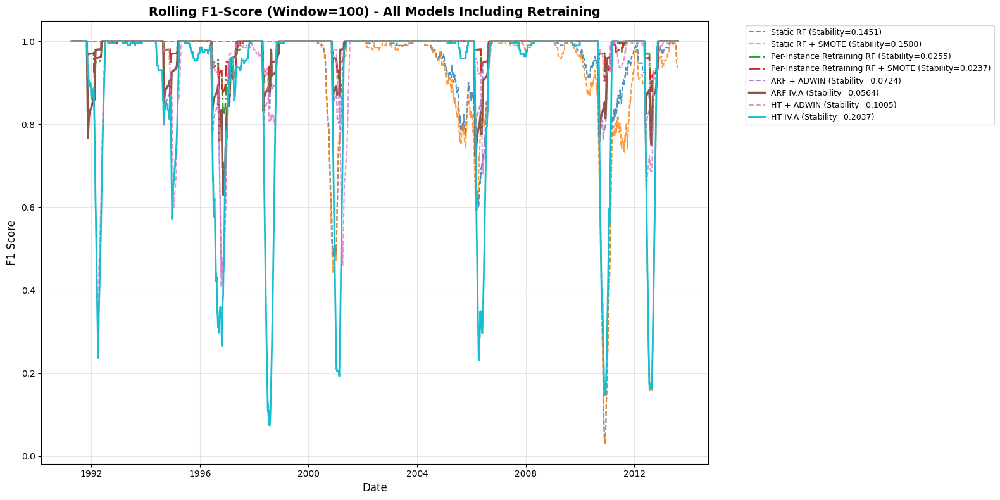


📊 ROLLING F1-SCORE STABILITY ANALYSIS (Lower = More Stable)
Static RF:                    0.1451
Static RF + SMOTE:            0.1500
Per-Instance Retraining RF:   0.0255
Per-Instance Retraining RF+SMOTE: 0.0237
ARF + ADWIN:                  0.0724
ARF IV.A:                     0.0564
HT + ADWIN:                   0.1005
HT IV.A:                      0.2037

🏆 MOST STABLE MODEL: Per-Instance Retraining RF + SMOTE (σ = 0.0237)
⚠️  LEAST STABLE MODEL: HT IV.A (σ = 0.2037)


In [7]:
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm  # Tambahkan tqdm

# Fungsi rolling F1-score dengan tqdm
def rolling_f1(y_true, y_pred, window=100):
    scores = [None] * window  # padding awal
    for i in tqdm(range(window, len(y_true)), desc=f"Rolling F1 (window={window})"):
        score = f1_score(y_true[i-window:i], y_pred[i-window:i], average='weighted', zero_division=0)
        scores.append(score)
    return scores

# Hitung Rolling F1-score untuk setiap model dengan menggunakan jendela pergeseran (rolling window) sepanjang 100 data
# Fungsi rolling_f1 akan menghitung skor F1 setiap 100 data terbaru, seiring waktu berjalan (online evaluation)

roll_f1_rf = rolling_f1(all_true, rf_pred, window=100)                           # Rolling F1 untuk model Random Forest tanpa SMOTE
roll_f1_rf_smote = rolling_f1(all_true, rf_smote_pred, window=100)               # Rolling F1 untuk Random Forest dengan SMOTE
roll_f1_retrain_rf = rolling_f1(all_true, retrain_rf_pred, window=100)           # Rolling F1 untuk Per-Instance Retraining RF
roll_f1_retrain_rf_smote = rolling_f1(all_true, retrain_rf_smote_pred, window=100) # Rolling F1 untuk Per-Instance Retraining RF + SMOTE
roll_f1_arf_adwin = rolling_f1(all_true, arf_adwin_pred, window=100)             # ARF dengan deteksi concept drift menggunakan ADWIN
roll_f1_arf_iva = rolling_f1(all_true, arf_sel_pred, window=100)                 # ARF versi IVA yang menggunakan strategi seleksi adaptif
roll_f1_ht_adwin = rolling_f1(all_true, ht_adwin_pred, window=100)               # Hoeffding Tree dengan ADWIN
roll_f1_ht_iva = rolling_f1(all_true, ht_sel_pred, window=100)                   # Hoeffding Tree versi IVA dengan strategi pemilihan adaptif

# Hitung stabilitas model berdasarkan standar deviasi dari skor F1 yang dihitung secara rolling
# Semakin kecil standar deviasi, semakin stabil performa model dari waktu ke waktu
# Digunakan np.nanstd untuk menghindari nilai None di awal window yang tidak valid

stability_rf = np.nanstd([x for x in roll_f1_rf if x is not None])                           # Stabilitas RF tanpa SMOTE
stability_rf_smote = np.nanstd([x for x in roll_f1_rf_smote if x is not None])               # Stabilitas RF dengan SMOTE
stability_retrain_rf = np.nanstd([x for x in roll_f1_retrain_rf if x is not None])           # Stabilitas Per-Instance Retraining RF
stability_retrain_rf_smote = np.nanstd([x for x in roll_f1_retrain_rf_smote if x is not None]) # Stabilitas Per-Instance Retraining RF + SMOTE
stability_arf_adwin = np.nanstd([x for x in roll_f1_arf_adwin if x is not None])             # Stabilitas ARF + ADWIN
stability_arf_iva = np.nanstd([x for x in roll_f1_arf_iva if x is not None])                 # Stabilitas ARF + IVA
stability_ht_adwin = np.nanstd([x for x in roll_f1_ht_adwin if x is not None])               # Stabilitas HT + ADWIN
stability_ht_iva = np.nanstd([x for x in roll_f1_ht_iva if x is not None])                   # Stabilitas HT + IVA

# Mengatur ukuran figure untuk plot yang lebih besar untuk menampilkan semua model
plt.figure(figsize=(16, 8))

# Definisikan warna untuk tiap model
color_rf = '#1f77b4'           # blue
color_rf_smote = '#ff7f0e'     # orange
color_retrain_rf = '#2ca02c'   # green
color_retrain_rf_smote = '#d62728'  # red
color_arf_adwin = '#9467bd'    # purple
color_arf_iva = '#8c564b'      # brown
color_ht_adwin = '#e377c2'     # pink
color_ht_iva = '#17becf'       # cyan

# Membuat plot untuk memvisualisasikan F1-score bergulir (rolling F1-score) dari waktu ke waktu.
# Setiap garis merepresentasikan satu model, dengan warna dan gaya garis yang berbeda.
# Label pada setiap garis juga menyertakan skor stabilitas (Stability) dari model tersebut.

# === STATIC BASELINES ===
plt.plot(dates_stream, roll_f1_rf, label=f'Static RF (Stability={stability_rf:.4f})', 
         linestyle='--', color=color_rf, alpha=0.8)
plt.plot(dates_stream, roll_f1_rf_smote, label=f'Static RF + SMOTE (Stability={stability_rf_smote:.4f})', 
         linestyle='--', color=color_rf_smote, alpha=0.8)

# === RETRAINING MODELS ===
plt.plot(dates_stream, roll_f1_retrain_rf, label=f'Per-Instance Retraining RF (Stability={stability_retrain_rf:.4f})', 
         linestyle='-.', color=color_retrain_rf, linewidth=2)
plt.plot(dates_stream, roll_f1_retrain_rf_smote, label=f'Per-Instance Retraining RF + SMOTE (Stability={stability_retrain_rf_smote:.4f})', 
         linestyle='-.', color=color_retrain_rf_smote, linewidth=2)

# === INCREMENTAL LEARNING MODELS ===
plt.plot(dates_stream, roll_f1_arf_adwin, label=f'ARF + ADWIN (Stability={stability_arf_adwin:.4f})', 
         linestyle='--', color=color_arf_adwin, alpha=0.8)
plt.plot(dates_stream, roll_f1_arf_iva, label=f'ARF IV.A (Stability={stability_arf_iva:.4f})', 
         linestyle='-', color=color_arf_iva, linewidth=2.5)  # Highlight proposed method
plt.plot(dates_stream, roll_f1_ht_adwin, label=f'HT + ADWIN (Stability={stability_ht_adwin:.4f})', 
         linestyle='--', color=color_ht_adwin, alpha=0.8)
plt.plot(dates_stream, roll_f1_ht_iva, label=f'HT IV.A (Stability={stability_ht_iva:.4f})', 
         linestyle='-', color=color_ht_iva, linewidth=2)

# === Pengaturan Layout dan Tampilan Plot ===
plt.title('Rolling F1-Score (Window=100) - All Models Including Retraining', fontsize=14, fontweight='bold')
plt.xlabel('Date', fontsize=12)
plt.ylabel('F1 Score', fontsize=12)

# Position legend outside plot area to avoid overlapping
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=9)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# === PRINT STABILITY SUMMARY ===
print("\n📊 ROLLING F1-SCORE STABILITY ANALYSIS (Lower = More Stable)")
print("="*70)
print(f"Static RF:                    {stability_rf:.4f}")
print(f"Static RF + SMOTE:            {stability_rf_smote:.4f}")
print(f"Per-Instance Retraining RF:   {stability_retrain_rf:.4f}")
print(f"Per-Instance Retraining RF+SMOTE: {stability_retrain_rf_smote:.4f}")
print(f"ARF + ADWIN:                  {stability_arf_adwin:.4f}")
print(f"ARF IV.A:                     {stability_arf_iva:.4f}")
print(f"HT + ADWIN:                   {stability_ht_adwin:.4f}")
print(f"HT IV.A:                      {stability_ht_iva:.4f}")

# Find most stable model
stabilities = {
    'Static RF': stability_rf,
    'Static RF + SMOTE': stability_rf_smote,
    'Per-Instance Retraining RF': stability_retrain_rf,
    'Per-Instance Retraining RF + SMOTE': stability_retrain_rf_smote,
    'ARF + ADWIN': stability_arf_adwin,
    'ARF IV.A': stability_arf_iva,
    'HT + ADWIN': stability_ht_adwin,
    'HT IV.A': stability_ht_iva
}

most_stable = min(stabilities, key=stabilities.get)
least_stable = max(stabilities, key=stabilities.get)

print(f"\n🏆 MOST STABLE MODEL: {most_stable} (σ = {stabilities[most_stable]:.4f})")
print(f"⚠️  LEAST STABLE MODEL: {least_stable} (σ = {stabilities[least_stable]:.4f})")

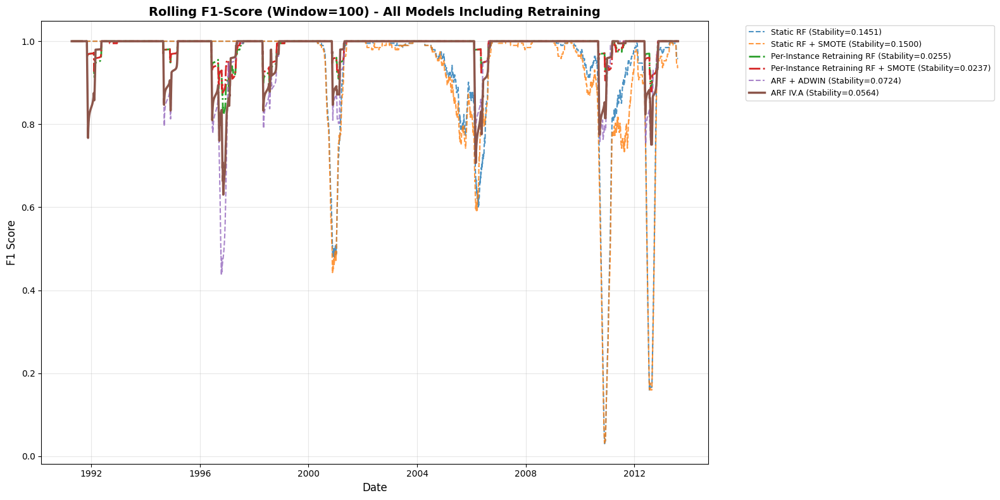


📊 ROLLING F1-SCORE STABILITY ANALYSIS (Lower = More Stable)
Per-Instance Retraining RF:   0.0255
Per-Instance Retraining RF+SMOTE: 0.0237
ARF + ADWIN:                  0.0724
ARF IV.A:                     0.0564

🏆 MOST STABLE MODEL: Per-Instance Retraining RF + SMOTE (σ = 0.0237)
⚠️  LEAST STABLE MODEL: ARF + ADWIN (σ = 0.0724)


In [12]:
# Mengatur ukuran figure untuk plot yang lebih besar untuk menampilkan semua model
plt.figure(figsize=(16, 8))

# Definisikan warna untuk tiap model
color_rf = '#1f77b4'           # blue
color_rf_smote = '#ff7f0e'     # orange
color_retrain_rf = '#2ca02c'   # green
color_retrain_rf_smote = '#d62728'  # red
color_arf_adwin = '#9467bd'    # purple
color_arf_iva = '#8c564b'      # brown
color_ht_adwin = '#e377c2'     # pink
color_ht_iva = '#17becf'       # cyan

# Membuat plot untuk memvisualisasikan F1-score bergulir (rolling F1-score) dari waktu ke waktu.
# Setiap garis merepresentasikan satu model, dengan warna dan gaya garis yang berbeda.
# Label pada setiap garis juga menyertakan skor stabilitas (Stability) dari model tersebut.

# === STATIC BASELINES ===
plt.plot(dates_stream, roll_f1_rf, label=f'Static RF (Stability={stability_rf:.4f})', 
         linestyle='--', color=color_rf, alpha=0.8)
plt.plot(dates_stream, roll_f1_rf_smote, label=f'Static RF + SMOTE (Stability={stability_rf_smote:.4f})', 
         linestyle='--', color=color_rf_smote, alpha=0.8)

# === RETRAINING MODELS ===
plt.plot(dates_stream, roll_f1_retrain_rf, label=f'Per-Instance Retraining RF (Stability={stability_retrain_rf:.4f})', 
         linestyle='-.', color=color_retrain_rf, linewidth=2)
plt.plot(dates_stream, roll_f1_retrain_rf_smote, label=f'Per-Instance Retraining RF + SMOTE (Stability={stability_retrain_rf_smote:.4f})', 
         linestyle='-.', color=color_retrain_rf_smote, linewidth=2)

# === INCREMENTAL LEARNING MODELS ===
plt.plot(dates_stream, roll_f1_arf_adwin, label=f'ARF + ADWIN (Stability={stability_arf_adwin:.4f})', 
         linestyle='--', color=color_arf_adwin, alpha=0.8)
plt.plot(dates_stream, roll_f1_arf_iva, label=f'ARF IV.A (Stability={stability_arf_iva:.4f})', 
         linestyle='-', color=color_arf_iva, linewidth=2.5)  # Highlight proposed method
# plt.plot(dates_stream, roll_f1_ht_adwin, label=f'HT + ADWIN (Stability={stability_ht_adwin:.4f})', 
#          linestyle='--', color=color_ht_adwin, alpha=0.8)
# plt.plot(dates_stream, roll_f1_ht_iva, label=f'HT IV.A (Stability={stability_ht_iva:.4f})', 
#          linestyle='-', color=color_ht_iva, linewidth=2)

# === Pengaturan Layout dan Tampilan Plot ===
plt.title('Rolling F1-Score (Window=100) - All Models Including Retraining', fontsize=14, fontweight='bold')
plt.xlabel('Date', fontsize=12)
plt.ylabel('F1 Score', fontsize=12)

# Position legend outside plot area to avoid overlapping
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=9)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# === PRINT STABILITY SUMMARY ===
print("\n📊 ROLLING F1-SCORE STABILITY ANALYSIS (Lower = More Stable)")
print("="*70)
# print(f"Static RF:                    {stability_rf:.4f}")
# print(f"Static RF + SMOTE:            {stability_rf_smote:.4f}")
print(f"Per-Instance Retraining RF:   {stability_retrain_rf:.4f}")
print(f"Per-Instance Retraining RF+SMOTE: {stability_retrain_rf_smote:.4f}")
print(f"ARF + ADWIN:                  {stability_arf_adwin:.4f}")
print(f"ARF IV.A:                     {stability_arf_iva:.4f}")
# print(f"HT + ADWIN:                   {stability_ht_adwin:.4f}")
# print(f"HT IV.A:                      {stability_ht_iva:.4f}")

# Find most stable model
stabilities = {
    # 'Static RF': stability_rf,
    # 'Static RF + SMOTE': stability_rf_smote,
    'Per-Instance Retraining RF': stability_retrain_rf,
    'Per-Instance Retraining RF + SMOTE': stability_retrain_rf_smote,
    'ARF + ADWIN': stability_arf_adwin,
    'ARF IV.A': stability_arf_iva,
    # 'HT + ADWIN': stability_ht_adwin,
    # 'HT IV.A': stability_ht_iva
}

most_stable = min(stabilities, key=stabilities.get)
least_stable = max(stabilities, key=stabilities.get)

print(f"\n🏆 MOST STABLE MODEL: {most_stable} (σ = {stabilities[most_stable]:.4f})")
print(f"⚠️  LEAST STABLE MODEL: {least_stable} (σ = {stabilities[least_stable]:.4f})")

In [ ]:
from scipy.stats import wilcoxon
import numpy as np

# --- utilities ---
def to_float_array(seq):
    """Convert list with None to float array with NaNs."""
    return np.array([np.nan if x is None else x for x in seq], dtype=float)

def wilcoxon_compare(a, b, name_a, name_b, alternative='greater'):
    """
    Paired Wilcoxon (signed-rank) test after removing NaNs.
    alternative: 'greater' tests median(a - b) > 0
                 use 'two-sided' if you prefer non-directional.
    """
    a = to_float_array(a)
    b = to_float_array(b)
    mask = ~np.isnan(a) & ~np.isnan(b)
    n = int(mask.sum())
    if n < 10:
        print(f"[WARN] Too few paired points for {name_a} vs {name_b}: n={n}")
        return None, None, n
    stat, p = wilcoxon(a[mask], b[mask], zero_method='wilcox', alternative=alternative)
    print(f"Wilcoxon ({alternative}) — {name_a} > {name_b}: W={stat:.0f}, p={p:.4g}, n={n}")
    return stat, p, n

# --- run comparisons: ARF IV.A vs baselines ---
name_arf_iva = "ARF IV.A"
pairs = [
    (roll_f1_arf_iva, roll_f1_arf_adwin, "ARF + ADWIN"),
    (roll_f1_arf_iva, roll_f1_ht_adwin, "HT + ADWIN"),
    (roll_f1_arf_iva, roll_f1_ht_iva,   "HT IV.A"),
    (roll_f1_arf_iva, roll_f1_rf,       "Static RF"),
    (roll_f1_arf_iva, roll_f1_rf_smote, "Static RF + SMOTE"),
]

for a, b, name_b in pairs:
    wilcoxon_compare(a, b, name_arf_iva, name_b, alternative='greater')

# --- (optional) also test cumulative curves if you want ---
# stat_cum, p_cum, n_cum = wilcoxon_compare(cum_f1_arf_iva, cum_f1_arf_adwin, "ARF IV.A (cum.)", "ARF + ADWIN (cum.)")


In [ ]:
from scipy.stats import wilcoxon
import numpy as np

# --- utilities ---
def to_float_array(seq):
    """Convert list with None to float array with NaNs."""
    return np.array([np.nan if x is None else x for x in seq], dtype=float)

def wilcoxon_compare(a, b, name_a, name_b, alternative='greater'):
    """
    Paired Wilcoxon (signed-rank) test after removing NaNs.
    alternative: 'greater' tests median(a - b) > 0
                 use 'two-sided' if you prefer non-directional.
    """
    a = to_float_array(a)
    b = to_float_array(b)
    mask = ~np.isnan(a) & ~np.isnan(b)
    n = int(mask.sum())
    if n < 10:
        print(f"[WARN] Too few paired points for {name_a} vs {name_b}: n={n}")
        return None, None, n
    stat, p = wilcoxon(a[mask], b[mask], zero_method='wilcox', alternative=alternative)
    print(f"Wilcoxon ({alternative}) — {name_a} > {name_b}: W={stat:.0f}, p={p:.4g}, n={n}")
    return stat, p, n

# --- run comparisons: ARF IV.A vs baselines ---
name_arf_iva = "ARF IV.A"
pairs = [
    (roll_f1_arf_iva, roll_f1_arf_adwin, "ARF + ADWIN"),
    (roll_f1_arf_iva, roll_f1_ht_adwin, "HT + ADWIN"),
    (roll_f1_arf_iva, roll_f1_ht_iva,   "HT IV.A"),
    (roll_f1_arf_iva, roll_f1_rf,       "Static RF"),
    (roll_f1_arf_iva, roll_f1_rf_smote, "Static RF + SMOTE"),
]

for a, b, name_b in pairs:
    wilcoxon_compare(a, b, name_arf_iva, name_b, alternative='greater')

# --- (optional) also test cumulative curves if you want ---
# stat_cum, p_cum, n_cum = wilcoxon_compare(cum_f1_arf_iva, cum_f1_arf_adwin, "ARF IV.A (cum.)", "ARF + ADWIN (cum.)")


Wilcoxon (greater) — ARF IV.A > ARF + ADWIN: W=674581, p=2.551e-06, n=8167
Wilcoxon (greater) — ARF IV.A > HT + ADWIN: W=2049856, p=1.219e-10, n=8167
Wilcoxon (greater) — ARF IV.A > HT IV.A: W=5814540, p=0, n=8167
Wilcoxon (greater) — ARF IV.A > Static RF: W=6351828, p=1.294e-91, n=8167
Wilcoxon (greater) — ARF IV.A > Static RF + SMOTE: W=9198609, p=2.286e-174, n=8167


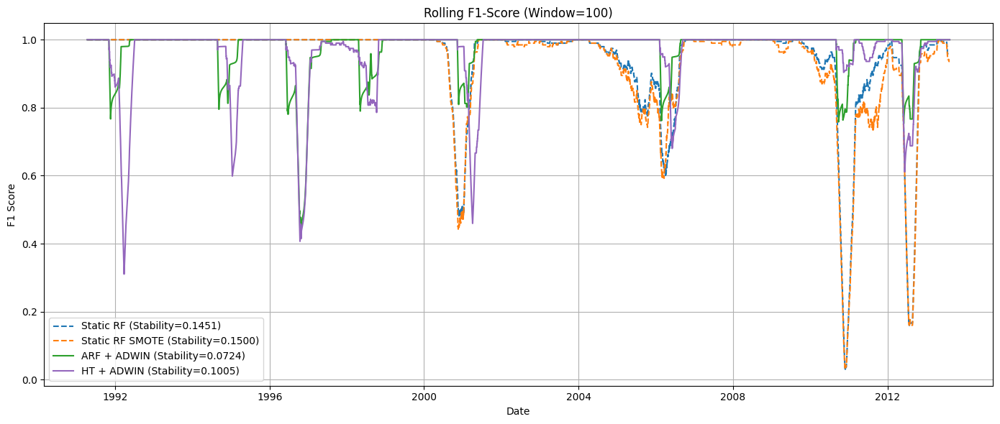

In [ ]:
# Mengatur ukuran figure untuk plot.
plt.figure(figsize=(14, 6))

plt.plot(dates_stream, roll_f1_rf, label=f'Static RF (Stability={stability_rf:.4f})', linestyle='--', color=color_rf)
plt.plot(dates_stream, roll_f1_rf_smote, label=f'Static RF SMOTE (Stability={stability_rf_smote:.4f})', linestyle='--', color=color_rf_smote)
plt.plot(dates_stream, roll_f1_arf_adwin, label=f'ARF + ADWIN (Stability={stability_arf_adwin:.4f})', linestyle='-', color=color_arf_adwin)
# plt.plot(dates_stream, roll_f1_arf_iva, label=f'ARF IV.A (Stability={stability_arf_iva:.4f})', linestyle='-', color=color_arf_iva) # Garis solid untuk model usulan
plt.plot(dates_stream, roll_f1_ht_adwin, label=f'HT + ADWIN (Stability={stability_ht_adwin:.4f})', linestyle='-', color=color_ht_adwin)
# plt.plot(dates_stream, roll_f1_ht_iva, label=f'HT IV.A (Stability={stability_ht_iva:.4f})', linestyle='-', color=color_ht_iva) # Garis solid untuk model usulan

# === Pengaturan Layout dan Tampilan Plot ===
# Memberikan judul pada plot.
plt.title('Rolling F1-Score (Window=100)')
# Memberikan label untuk sumbu X.
plt.xlabel('Date')
# Memberikan label untuk sumbu Y.
plt.ylabel('F1 Score')
# Menampilkan legenda untuk mengidentifikasi setiap garis model.
plt.legend()
# Menambahkan grid untuk mempermudah pembacaan nilai pada plot.
plt.grid(True)
# Menyesuaikan layout secara otomatis agar tidak ada teks yang tumpang tindih.
plt.tight_layout()
# Menampilkan hasil akhir plot.
plt.show()

Rolling F1 (window=100): 100%|████████████████████████████████████████████████████| 4881/4881 [00:06<00:00, 724.18it/s]


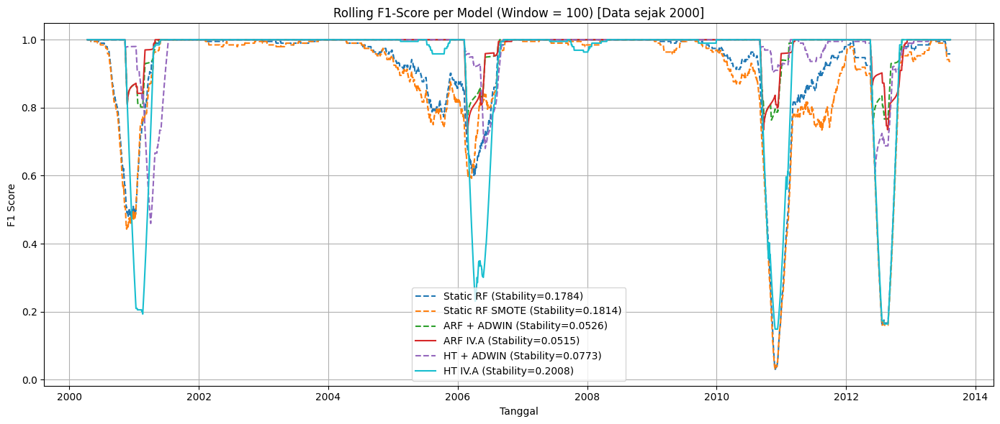

In [ ]:
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm  # Progress bar

# ==== STEP 1: Siapkan DataFrame dan Filter dari Tahun 2000 ====
df_eval = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_IV.A': arf_sel_pred,
    'HT_ADWIN': ht_adwin_pred,
    'HT_IV.A': ht_sel_pred
})

# Filter hanya data dari tahun 2000 ke atas
df_eval = df_eval[df_eval['Date'].dt.year >= 2000].reset_index(drop=True)

# Update variabel untuk evaluasi
dates_stream = df_eval['Date']
all_true = df_eval['True']
rf_pred = df_eval['RF']
rf_smote_pred = df_eval['RF_SMOTE']
arf_adwin_pred = df_eval['ARF_ADWIN']
arf_sel_pred = df_eval['ARF_IV.A']
ht_adwin_pred = df_eval['HT_ADWIN']
ht_sel_pred = df_eval['HT_IV.A']

# ==== STEP 2: Definisikan Fungsi Rolling F1 ====
def rolling_f1(y_true, y_pred, window=180):
    scores = [None] * window  # padding awal
    for i in tqdm(range(window, len(y_true)), desc=f"Rolling F1 (window={window})"):
        score = f1_score(y_true[i-window:i], y_pred[i-window:i], average='weighted', zero_division=0)
        scores.append(score)
    return scores

# ==== STEP 3: Hitung Rolling F1 per Model ====
roll_f1_rf = rolling_f1(all_true, rf_pred, window=100)
roll_f1_rf_smote = rolling_f1(all_true, rf_smote_pred, window=100)
roll_f1_arf_adwin = rolling_f1(all_true, arf_adwin_pred, window=100)
roll_f1_arf_iva = rolling_f1(all_true, arf_sel_pred, window=100)
roll_f1_ht_adwin = rolling_f1(all_true, ht_adwin_pred, window=100)
roll_f1_ht_iva = rolling_f1(all_true, ht_sel_pred, window=100)

# ==== STEP 4: Hitung Stabilitas (Standar Deviasi Rolling F1) ====
stability_rf = np.nanstd([x for x in roll_f1_rf if x is not None])
stability_rf_smote = np.nanstd([x for x in roll_f1_rf_smote if x is not None])
stability_arf_adwin = np.nanstd([x for x in roll_f1_arf_adwin if x is not None])
stability_arf_iva = np.nanstd([x for x in roll_f1_arf_iva if x is not None])
stability_ht_adwin = np.nanstd([x for x in roll_f1_ht_adwin if x is not None])
stability_ht_iva = np.nanstd([x for x in roll_f1_ht_iva if x is not None])

# ==== STEP 5: Plot Rolling F1 Score ====
# Tentukan warna untuk masing-masing model (ganti sesuai preferensi)
# Definisikan warna yang kontras dan tidak menggunakan brown
color_rf = '#1f77b4'           # blue
color_rf_smote = '#ff7f0e'     # orange
color_arf_adwin = '#2ca02c'    # green
color_arf_iva = '#d62728'      # red (ARF IV.A)
color_ht_adwin = '#9467bd'     # purple
color_ht_iva = '#17becf'       # cyan/teal 

plt.figure(figsize=(14, 6))
plt.plot(dates_stream, roll_f1_rf, label=f'Static RF (Stability={stability_rf:.4f})', linestyle='--', color=color_rf)
plt.plot(dates_stream, roll_f1_rf_smote, label=f'Static RF SMOTE (Stability={stability_rf_smote:.4f})', linestyle='--', color=color_rf_smote)
plt.plot(dates_stream, roll_f1_arf_adwin, label=f'ARF + ADWIN (Stability={stability_arf_adwin:.4f})', linestyle='--', color=color_arf_adwin)
plt.plot(dates_stream, roll_f1_arf_iva, label=f'ARF IV.A (Stability={stability_arf_iva:.4f})', linestyle='-', color=color_arf_iva)
plt.plot(dates_stream, roll_f1_ht_adwin, label=f'HT + ADWIN (Stability={stability_ht_adwin:.4f})', linestyle='--', color=color_ht_adwin)
plt.plot(dates_stream, roll_f1_ht_iva, label=f'HT IV.A (Stability={stability_ht_iva:.4f})', linestyle='-', color=color_ht_iva)

plt.title('Rolling F1-Score per Model (Window = 100) [Data sejak 2000]')
plt.xlabel('Tanggal')
plt.ylabel('F1 Score')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
from sklearn.metrics import classification_report
import numpy as np # Import numpy for np.nan if you prefer

# Siapkan dataframe evaluasi (asumsi variabel-variabel ini sudah ada)
eval_df = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_IV.A': arf_sel_pred,
    'HT_ADWIN': ht_adwin_pred,
    'HT_IV.A': ht_sel_pred
})

# Tambahkan kolom periodik triwulan
eval_df['Period'] = eval_df['Date'].dt.to_period('Q')

# Ambil semua period unik setelah tahun 2000
periods = sorted(eval_df[eval_df['Date'].dt.year >= 2000]['Period'].unique())

# Daftar model untuk diiterasi
models = ['RF', 'RF_SMOTE', 'ARF_ADWIN', 'ARF_IV.A', 'HT_ADWIN', 'HT_IV.A']
labels = ['Non', 'Efusif', 'Eksplosif']

# Siapkan list untuk menampung hasil
all_f1_scores = []

# Loop tiap periode
for period in periods:
    quarter_data = eval_df[eval_df['Period'] == period]

    if quarter_data.empty:
        continue

    # Loop tiap model
    for model in models:
        # Hasilkan classification report dalam bentuk dictionary
        report = classification_report(
            quarter_data['True'],
            quarter_data[model],
            labels=[0, 1, 2],
            output_dict=True,
            zero_division=0
        )

        period_scores = {'Period': period, 'Model': model}

        # Ambil F1-score untuk setiap kelas
        for i, label in enumerate(labels):
            class_key = str(i)
            
            # --- THIS IS THE FIX ---
            # Cek apakah kelas ada di dalam report sebelum mengaksesnya
            if class_key in report:
                period_scores[f'F1_{label}'] = report[class_key]['f1-score']
            else:
                # Jika tidak ada, F1-score dianggap 0 untuk periode ini
                period_scores[f'F1_{label}'] = 0.0
        
        # Tambahkan ke list hasil
        all_f1_scores.append(period_scores)

# Konversi list hasil menjadi DataFrame untuk tampilan yang rapi
f1_df = pd.DataFrame(all_f1_scores)

# Tampilkan tabel F1-score
print("F1-Score per Class for Every 3 Months")
print(f1_df.round(3))

# Jika Anda ingin menyimpannya ke CSV
f1_df.to_csv('quarterly_f1_scores_ret.csv', index=False)

F1-Score per Class for Every 3 Months
     Period      Model  F1_Non  F1_Efusif  F1_Eksplosif
0    2000Q1         RF   1.000        0.0           0.0
1    2000Q1   RF_SMOTE   1.000        0.0           0.0
2    2000Q1  ARF_ADWIN   1.000        0.0           0.0
3    2000Q1   ARF_IV.A   1.000        0.0           0.0
4    2000Q1   HT_ADWIN   1.000        0.0           0.0
..      ...        ...     ...        ...           ...
325  2013Q3   RF_SMOTE   0.868        0.0           0.0
326  2013Q3  ARF_ADWIN   1.000        0.0           0.0
327  2013Q3   ARF_IV.A   1.000        0.0           0.0
328  2013Q3   HT_ADWIN   1.000        0.0           0.0
329  2013Q3    HT_IV.A   1.000        0.0           0.0

[330 rows x 5 columns]


In [13]:
import pandas as pd
from sklearn.metrics import classification_report
import numpy as np

# Siapkan dataframe evaluasi (asumsi variabel-variabel ini sudah ada)
eval_df = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'RETRAIN_RF': retrain_rf_pred,  # Add retraining RF
    'RETRAIN_RF_SMOTE': retrain_rf_smote_pred,  # Add retraining RF + SMOTE
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_IV.A': arf_sel_pred,
    'HT_ADWIN': ht_adwin_pred,
    'HT_IV.A': ht_sel_pred
})

# Tambahkan kolom periodik triwulan
eval_df['Period'] = eval_df['Date'].dt.to_period('Q')

# Ambil semua period unik setelah tahun 2000
periods = sorted(eval_df[eval_df['Date'].dt.year >= 2000]['Period'].unique())

# Daftar model untuk diiterasi - INCLUDING RETRAINING MODELS
models = [
    'RF', 'RF_SMOTE', 
    'RETRAIN_RF', 'RETRAIN_RF_SMOTE',  # Add retraining models
    'ARF_ADWIN', 'ARF_IV.A', 
    'HT_ADWIN', 'HT_IV.A'
]
labels = ['Non', 'Efusif', 'Eksplosif']

# Siapkan list untuk menampung hasil
all_f1_scores = []

# Loop tiap periode
for period in periods:
    quarter_data = eval_df[eval_df['Period'] == period]

    if quarter_data.empty:
        continue

    # Loop tiap model
    for model in models:
        # Hasilkan classification report dalam bentuk dictionary
        report = classification_report(
            quarter_data['True'],
            quarter_data[model],
            labels=[0, 1, 2],
            output_dict=True,
            zero_division=0
        )

        period_scores = {'Period': period, 'Model': model}

        # Ambil F1-score untuk setiap kelas
        for i, label in enumerate(labels):
            class_key = str(i)
            
            # --- THIS IS THE FIX ---
            # Cek apakah kelas ada di dalam report sebelum mengaksesnya
            if class_key in report:
                period_scores[f'F1_{label}'] = report[class_key]['f1-score']
            else:
                # Jika tidak ada, F1-score dianggap 0 untuk periode ini
                period_scores[f'F1_{label}'] = 0.0
        
        # Tambahkan ke list hasil
        all_f1_scores.append(period_scores)

# Konversi list hasil menjadi DataFrame untuk tampilan yang rapi
f1_df = pd.DataFrame(all_f1_scores)

# Tampilkan tabel F1-score
print("F1-Score per Class for Every 3 Months (INCLUDING RETRAINING MODELS)")
print("="*80)
print(f1_df.round(3))

# Jika Anda ingin menyimpannya ke CSV
f1_df.to_csv('quarterly_f1_scores_with_retraining.csv', index=False)
print(f"\n✅ Saved to 'quarterly_f1_scores_with_retraining.csv'")

# === SUMMARY ANALYSIS ===
print("\n📊 QUARTERLY F1-SCORE SUMMARY BY MODEL:")
print("="*50)

# Calculate average F1-scores per model across all quarters
model_summary = f1_df.groupby('Model')[['F1_Non', 'F1_Efusif', 'F1_Eksplosif']].mean().round(4)
print("\nAverage F1-Score per Class across All Quarters:")
print(model_summary)

# Calculate overall weighted average F1-score per model
# Weight by class frequency in the dataset
class_counts = pd.Series(all_true).value_counts().sort_index()
weights = class_counts / class_counts.sum()

print(f"\nClass Distribution in Dataset:")
print(f"Non (0): {class_counts[0]} samples ({weights[0]:.3f})")
print(f"Efusif (1): {class_counts[1]} samples ({weights[1]:.3f})")
print(f"Eksplosif (2): {class_counts[2]} samples ({weights[2]:.3f})")

# Calculate weighted average F1-score
model_summary['Weighted_Avg_F1'] = (
    model_summary['F1_Non'] * weights[0] + 
    model_summary['F1_Efusif'] * weights[1] + 
    model_summary['F1_Eksplosif'] * weights[2]
).round(4)

print("\n🎯 OVERALL PERFORMANCE RANKING (Weighted Average F1):")
ranked_models = model_summary.sort_values('Weighted_Avg_F1', ascending=False)
for i, (model, scores) in enumerate(ranked_models.iterrows(), 1):
    print(f"{i}. {model}: {scores['Weighted_Avg_F1']:.4f}")

# === DETAILED COMPARISON ===
print("\n📈 DETAILED MODEL COMPARISON:")
print("-" * 70)
for model in models:
    model_data = model_summary.loc[model]
    print(f"{model:20} | Non: {model_data['F1_Non']:.3f} | Efusif: {model_data['F1_Efusif']:.3f} | Eksplosif: {model_data['F1_Eksplosif']:.3f} | Avg: {model_data['Weighted_Avg_F1']:.3f}")

F1-Score per Class for Every 3 Months (INCLUDING RETRAINING MODELS)
     Period             Model  F1_Non  F1_Efusif  F1_Eksplosif
0    2000Q1                RF     1.0        0.0           0.0
1    2000Q1          RF_SMOTE     1.0        0.0           0.0
2    2000Q1        RETRAIN_RF     1.0        0.0           0.0
3    2000Q1  RETRAIN_RF_SMOTE     1.0        0.0           0.0
4    2000Q1         ARF_ADWIN     1.0        0.0           0.0
..      ...               ...     ...        ...           ...
435  2013Q3  RETRAIN_RF_SMOTE     1.0        0.0           0.0
436  2013Q3         ARF_ADWIN     1.0        0.0           0.0
437  2013Q3          ARF_IV.A     1.0        0.0           0.0
438  2013Q3          HT_ADWIN     1.0        0.0           0.0
439  2013Q3           HT_IV.A     1.0        0.0           0.0

[440 rows x 5 columns]

✅ Saved to 'quarterly_f1_scores_with_retraining.csv'

📊 QUARTERLY F1-SCORE SUMMARY BY MODEL:

Average F1-Score per Class across All Quarters:
         

📊 Generating confusion matrices for 55 quarters...
🔍 Models included: 8 total (Static, Retraining, Incremental)


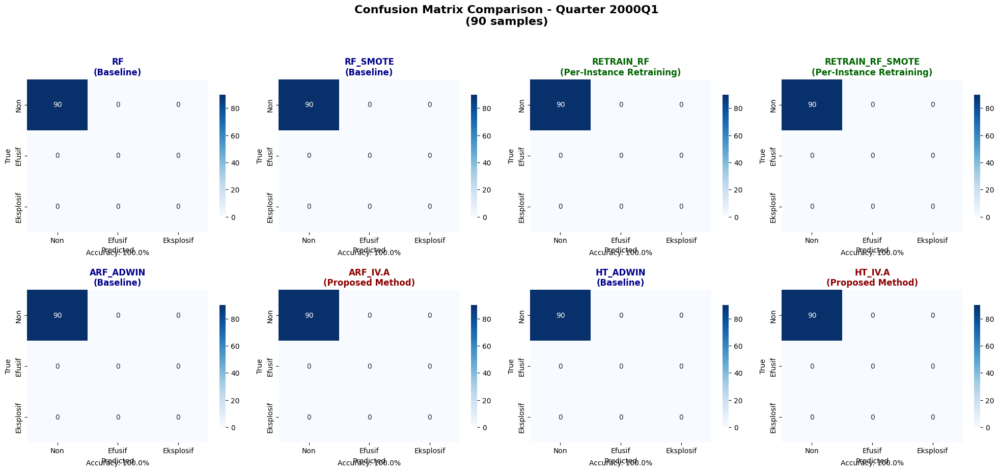


📈 Quarter 2000Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




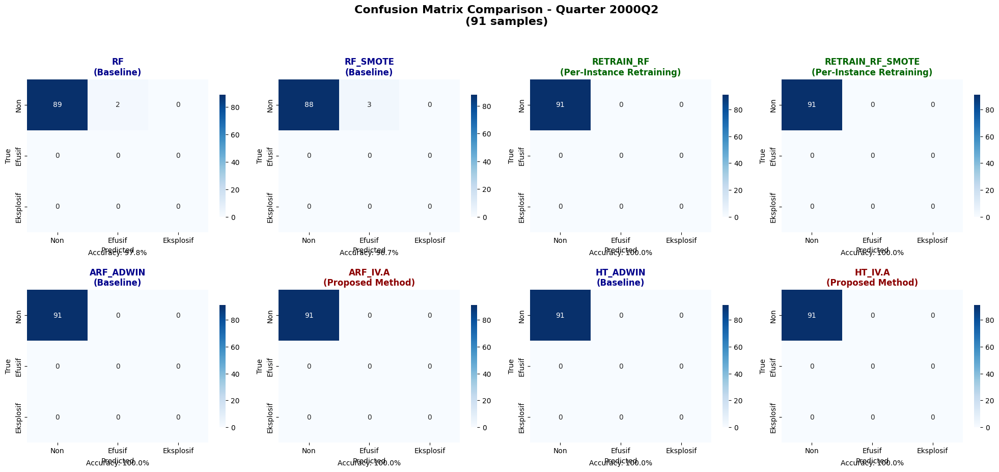


📈 Quarter 2000Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  97.8%
RF_SMOTE             [BASELINE]      Accuracy:  96.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




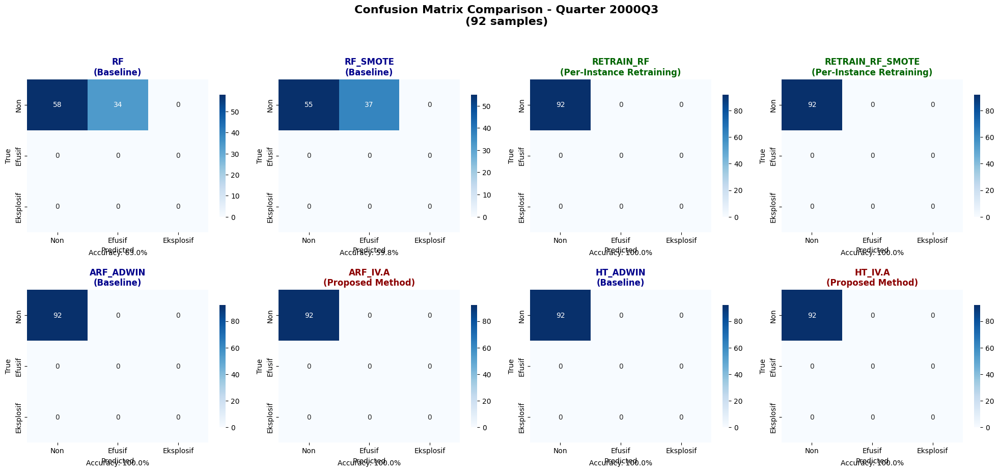


📈 Quarter 2000Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  63.0%
RF_SMOTE             [BASELINE]      Accuracy:  59.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




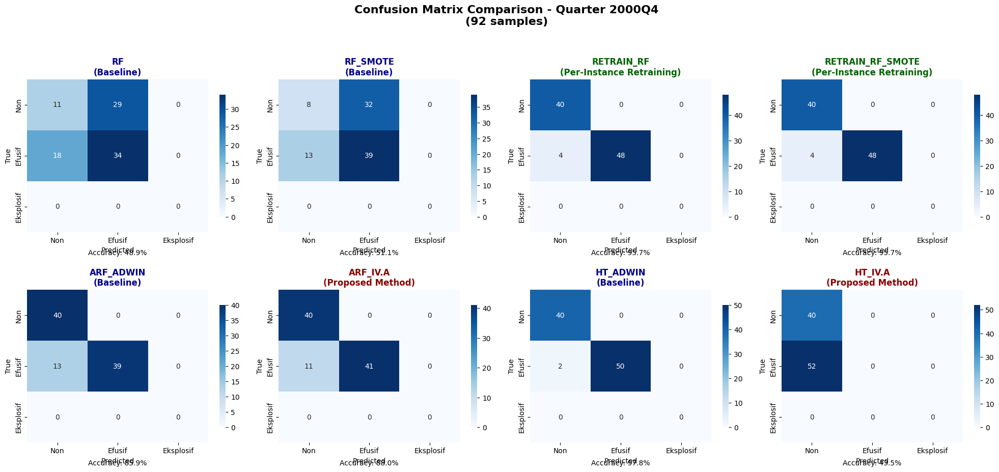


📈 Quarter 2000Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  48.9%
RF_SMOTE             [BASELINE]      Accuracy:  51.1%
RETRAIN_RF           [RETRAINING]    Accuracy:  95.7%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  95.7%
ARF_ADWIN            [BASELINE]      Accuracy:  85.9%
ARF_IV.A             [PROPOSED]      Accuracy:  88.0%
HT_ADWIN             [BASELINE]      Accuracy:  97.8%
HT_IV.A              [PROPOSED]      Accuracy:  43.5%




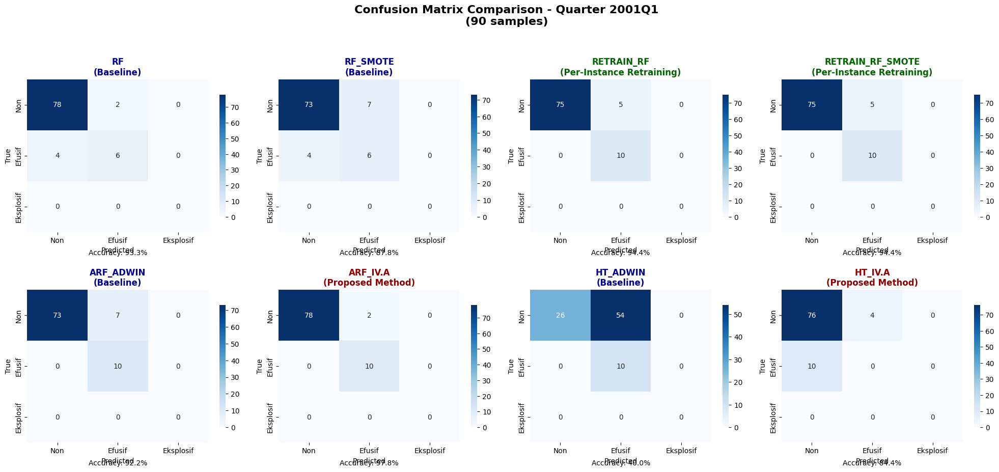


📈 Quarter 2001Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  93.3%
RF_SMOTE             [BASELINE]      Accuracy:  87.8%
RETRAIN_RF           [RETRAINING]    Accuracy:  94.4%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  94.4%
ARF_ADWIN            [BASELINE]      Accuracy:  92.2%
ARF_IV.A             [PROPOSED]      Accuracy:  97.8%
HT_ADWIN             [BASELINE]      Accuracy:  40.0%
HT_IV.A              [PROPOSED]      Accuracy:  84.4%




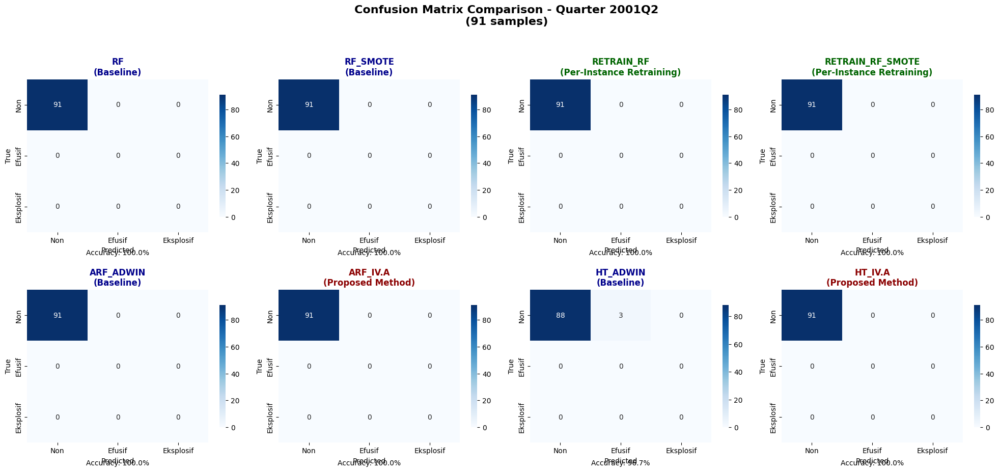


📈 Quarter 2001Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy:  96.7%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




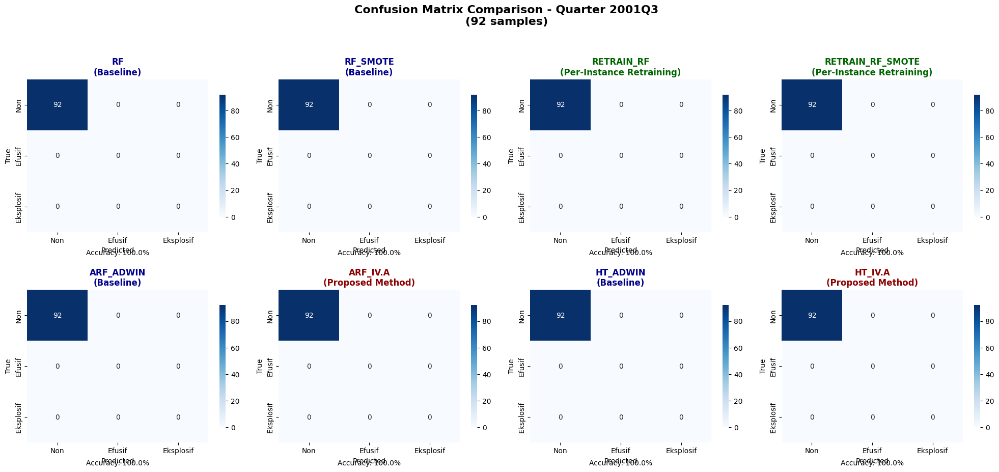


📈 Quarter 2001Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




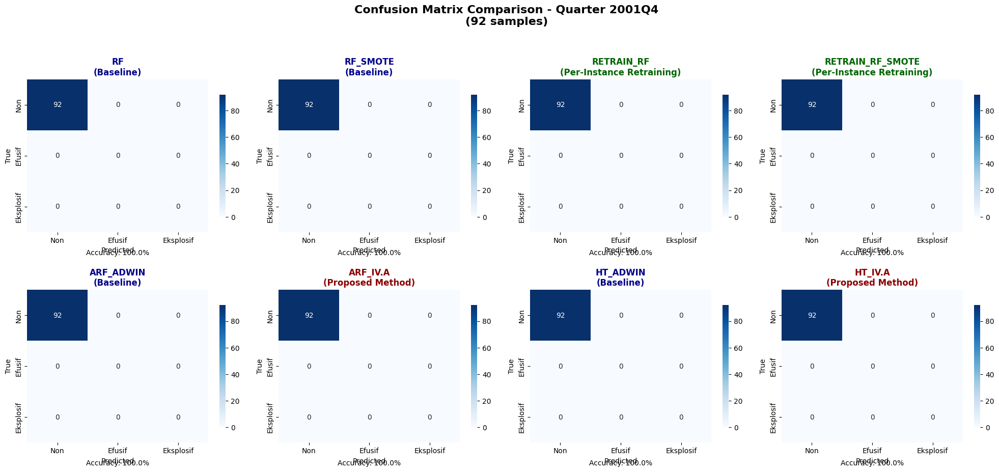


📈 Quarter 2001Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




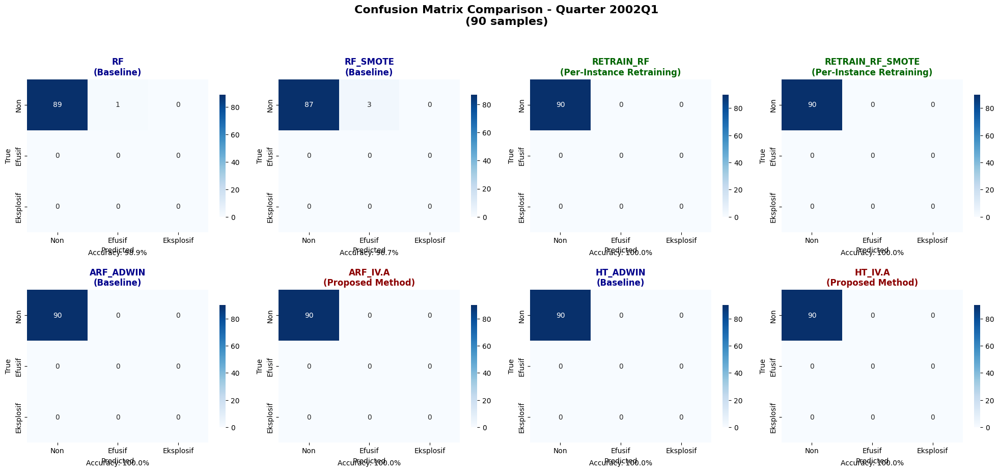


📈 Quarter 2002Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  96.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




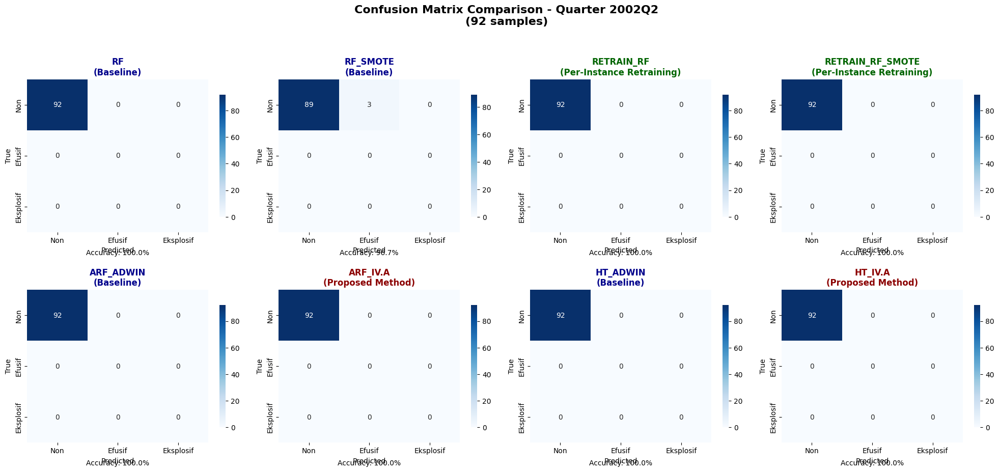


📈 Quarter 2002Q2 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  96.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




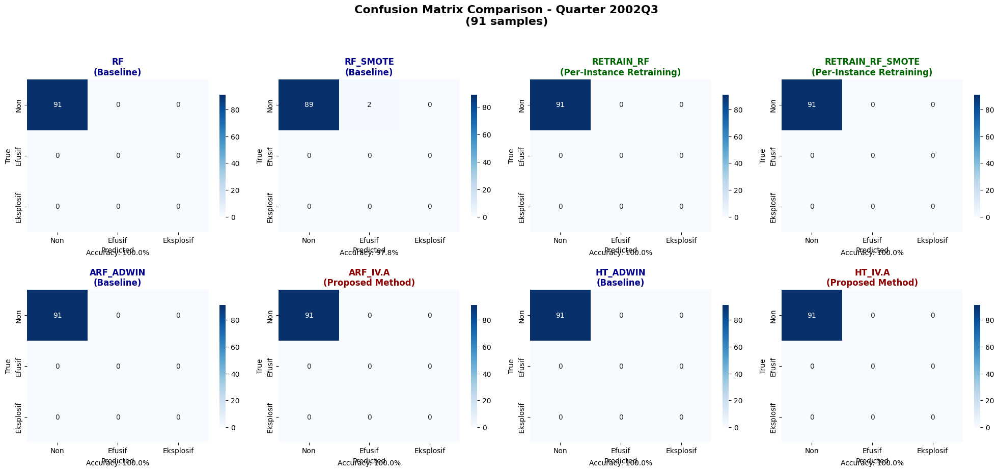


📈 Quarter 2002Q3 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




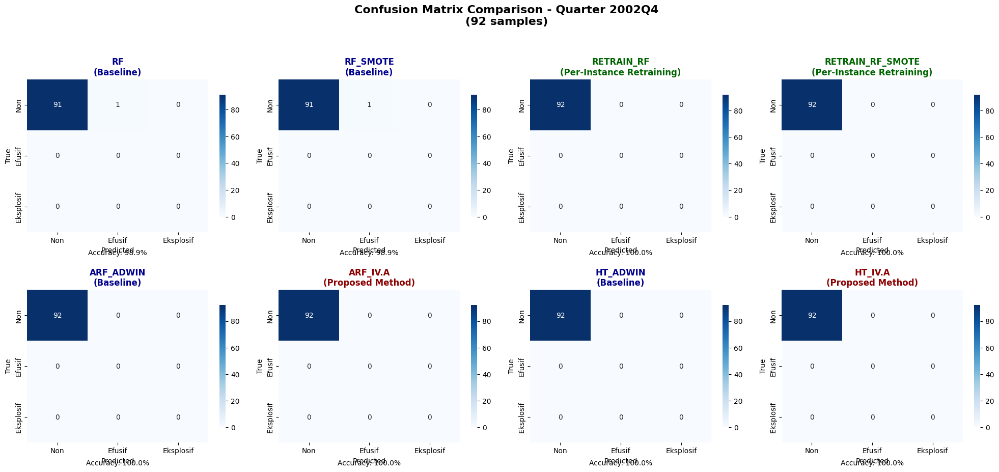


📈 Quarter 2002Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  98.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




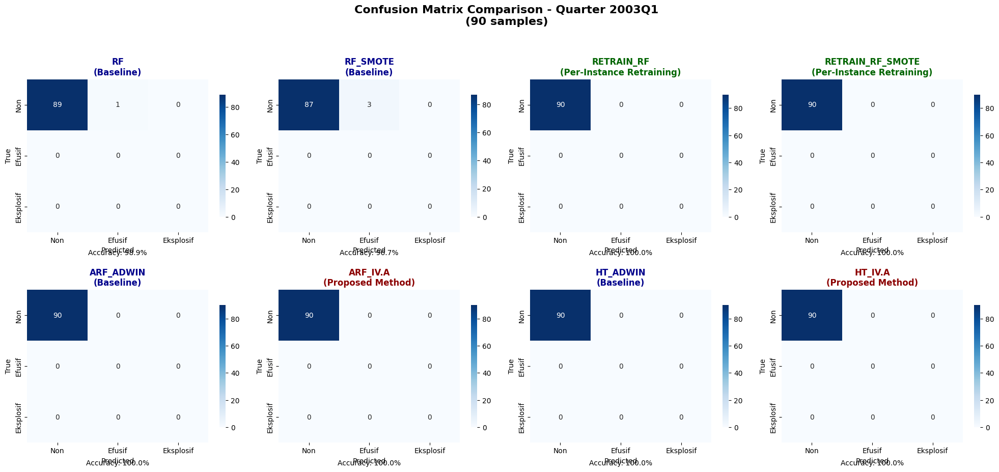


📈 Quarter 2003Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  96.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




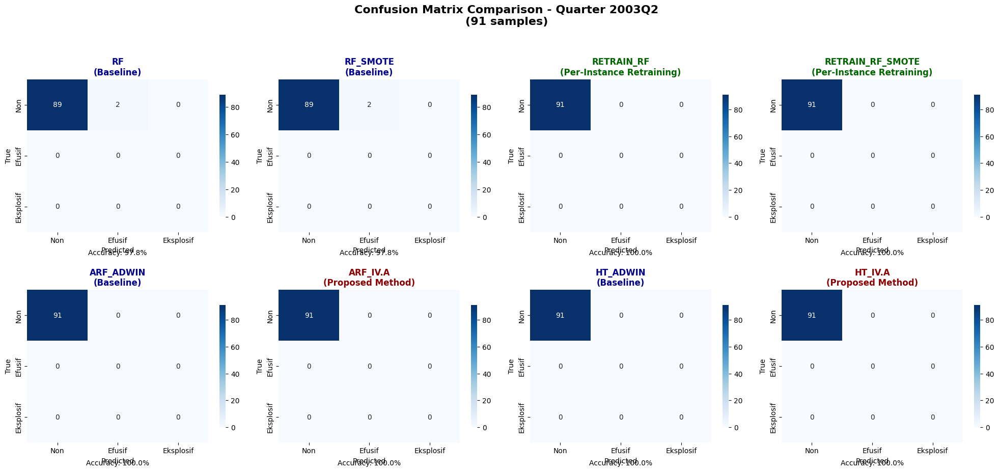


📈 Quarter 2003Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  97.8%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




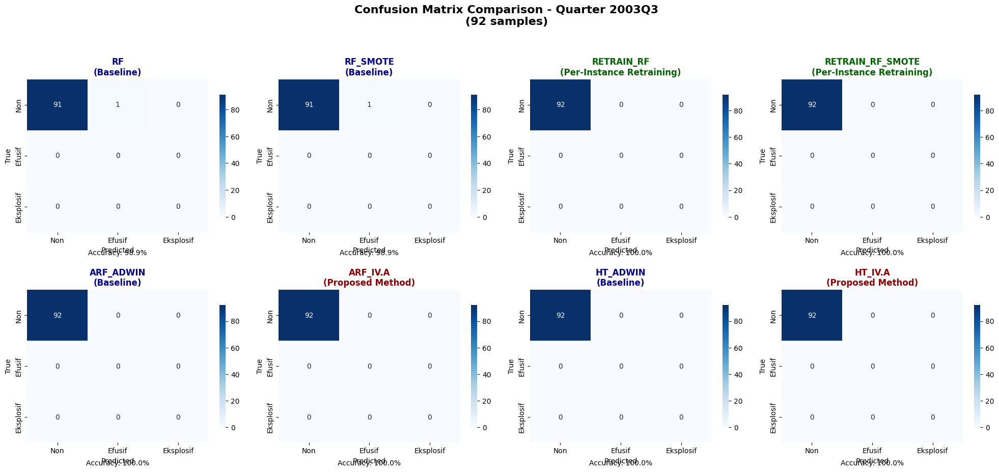


📈 Quarter 2003Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  98.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




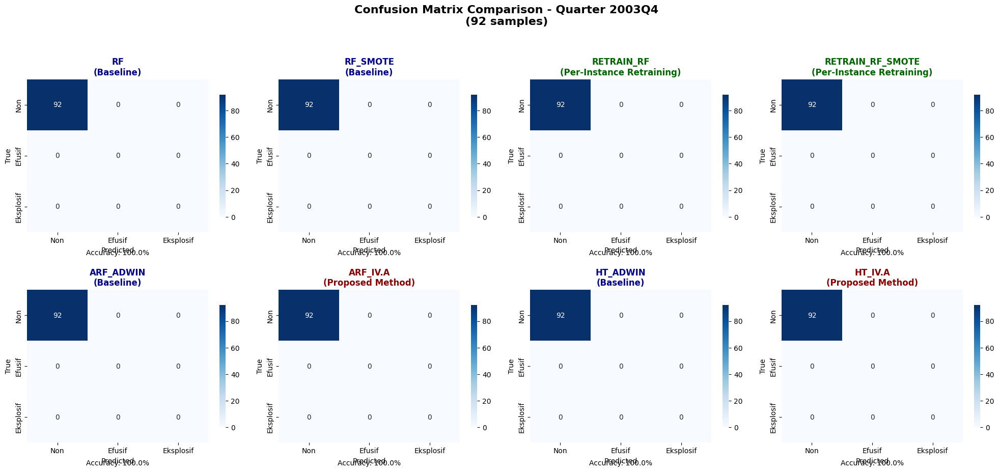


📈 Quarter 2003Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




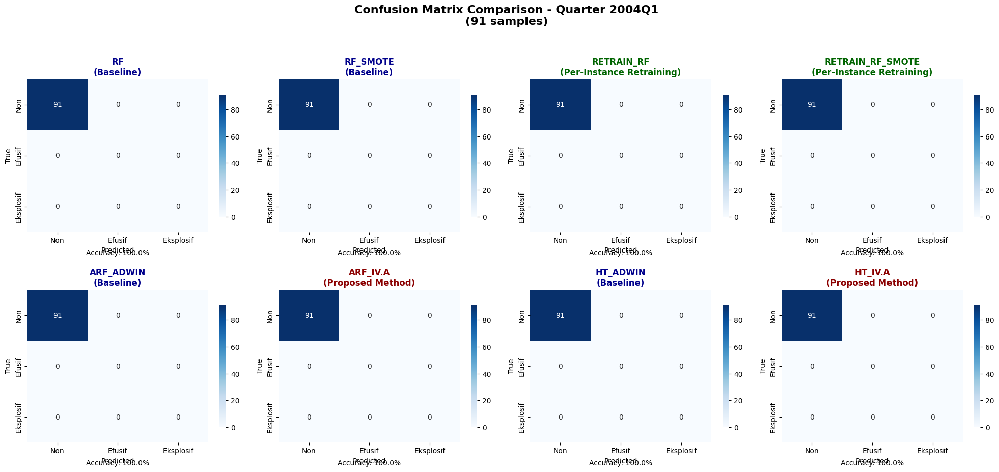


📈 Quarter 2004Q1 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




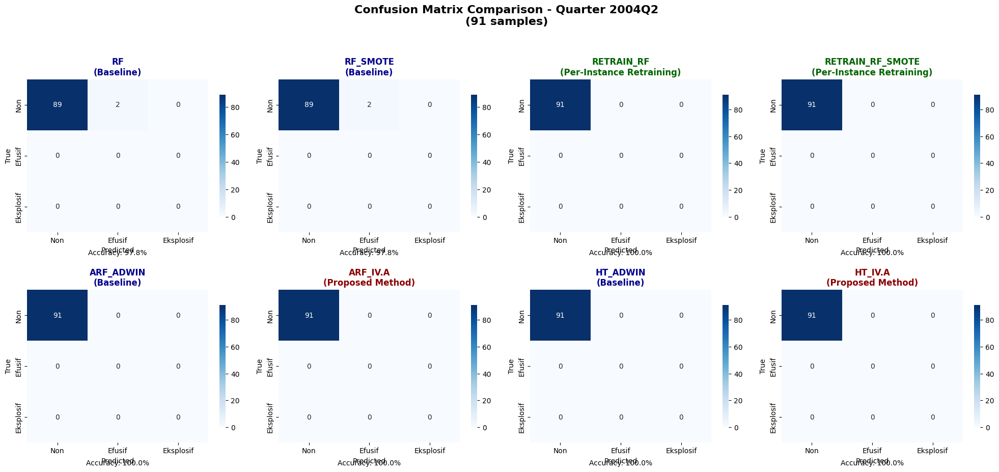


📈 Quarter 2004Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  97.8%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




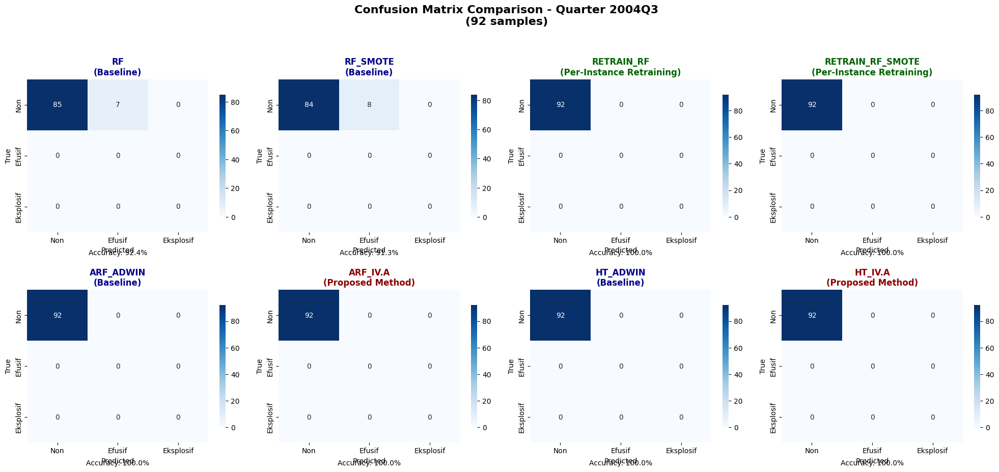


📈 Quarter 2004Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  92.4%
RF_SMOTE             [BASELINE]      Accuracy:  91.3%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




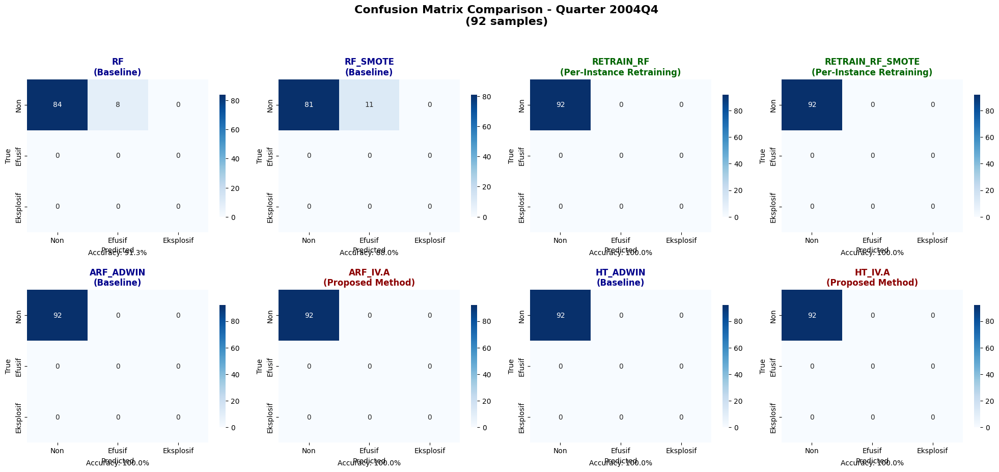


📈 Quarter 2004Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  91.3%
RF_SMOTE             [BASELINE]      Accuracy:  88.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




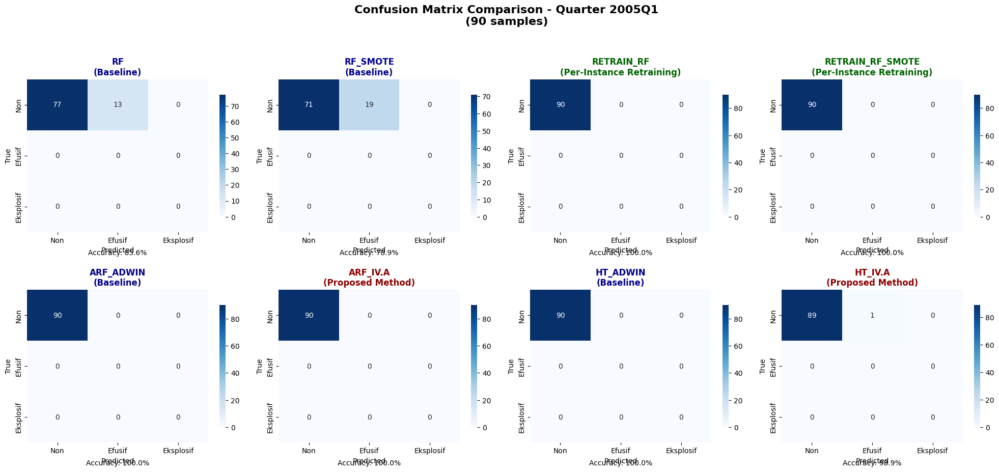


📈 Quarter 2005Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  85.6%
RF_SMOTE             [BASELINE]      Accuracy:  78.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  98.9%




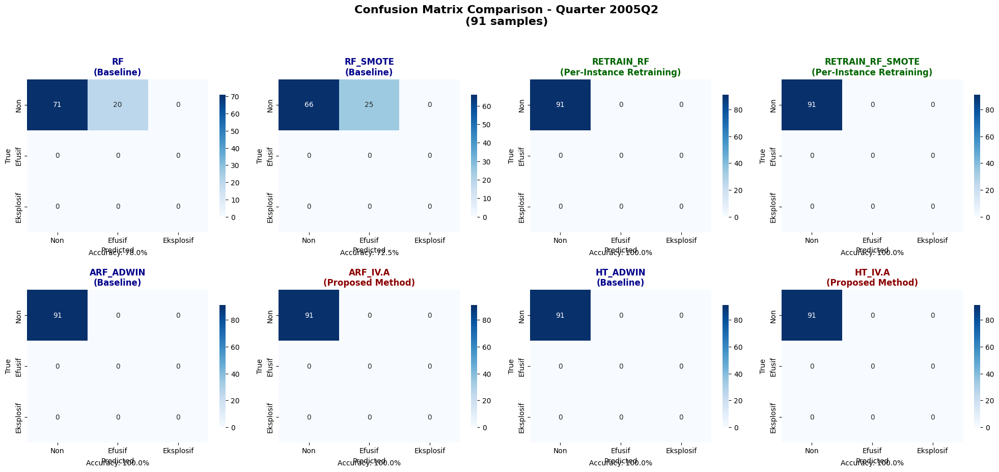


📈 Quarter 2005Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  78.0%
RF_SMOTE             [BASELINE]      Accuracy:  72.5%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




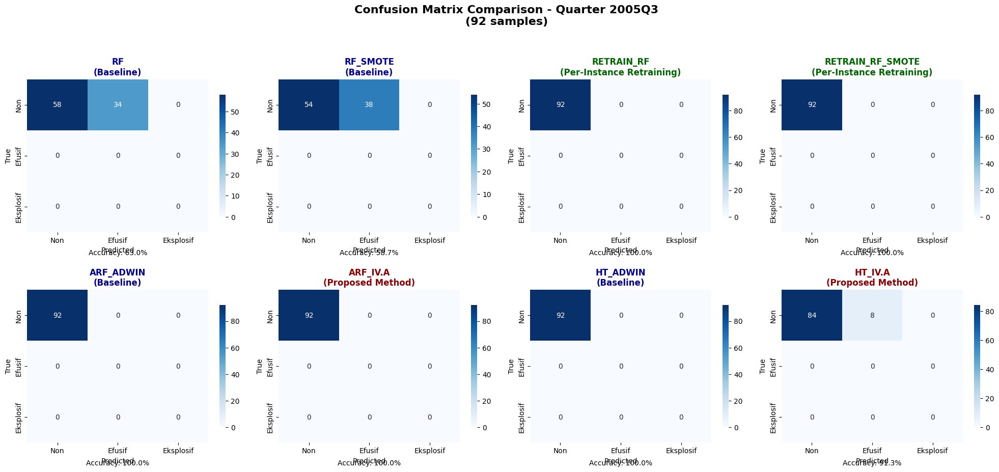


📈 Quarter 2005Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  63.0%
RF_SMOTE             [BASELINE]      Accuracy:  58.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  91.3%




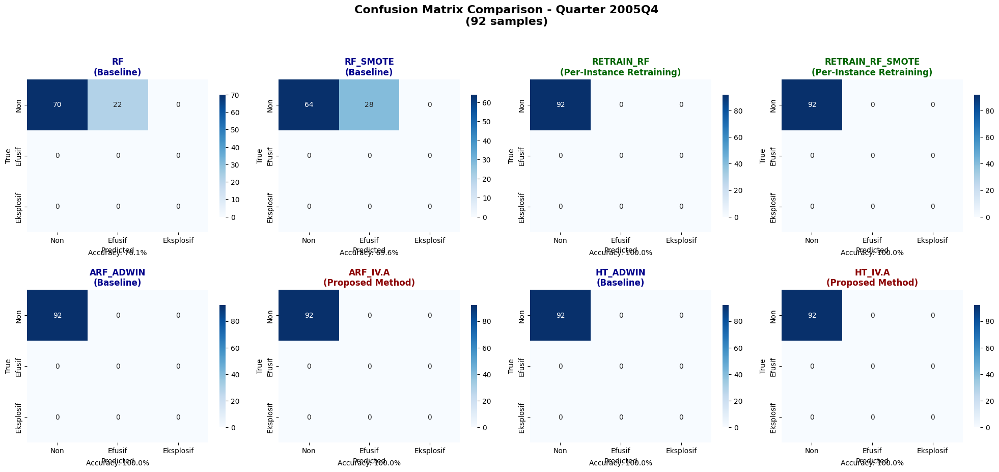


📈 Quarter 2005Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  76.1%
RF_SMOTE             [BASELINE]      Accuracy:  69.6%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




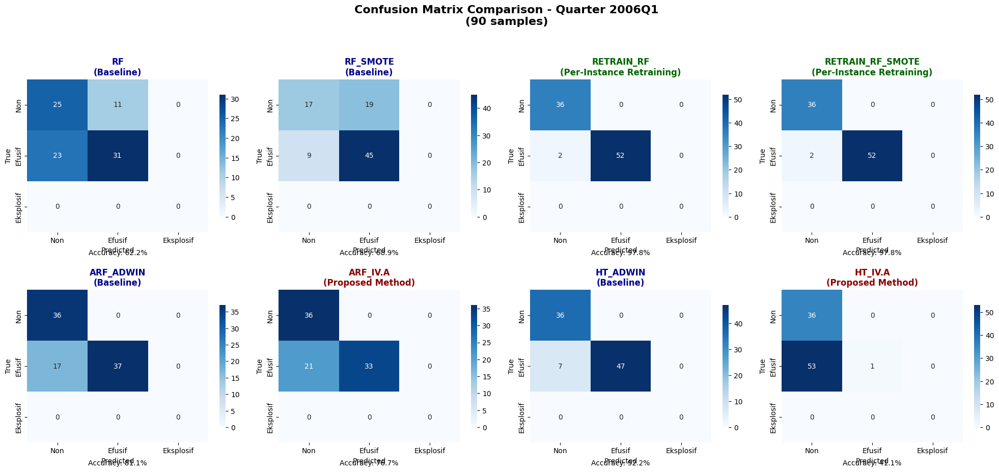


📈 Quarter 2006Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  62.2%
RF_SMOTE             [BASELINE]      Accuracy:  68.9%
RETRAIN_RF           [RETRAINING]    Accuracy:  97.8%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  97.8%
ARF_ADWIN            [BASELINE]      Accuracy:  81.1%
ARF_IV.A             [PROPOSED]      Accuracy:  76.7%
HT_ADWIN             [BASELINE]      Accuracy:  92.2%
HT_IV.A              [PROPOSED]      Accuracy:  41.1%




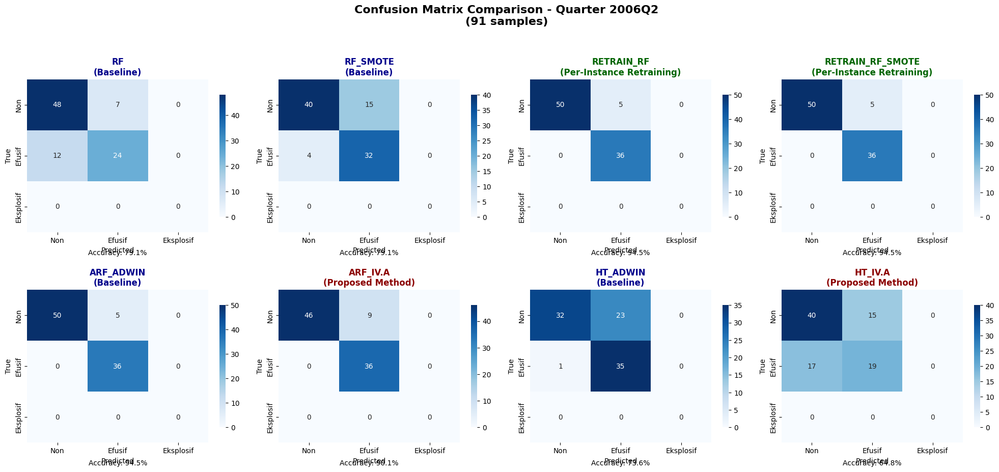


📈 Quarter 2006Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  79.1%
RF_SMOTE             [BASELINE]      Accuracy:  79.1%
RETRAIN_RF           [RETRAINING]    Accuracy:  94.5%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  94.5%
ARF_ADWIN            [BASELINE]      Accuracy:  94.5%
ARF_IV.A             [PROPOSED]      Accuracy:  90.1%
HT_ADWIN             [BASELINE]      Accuracy:  73.6%
HT_IV.A              [PROPOSED]      Accuracy:  64.8%




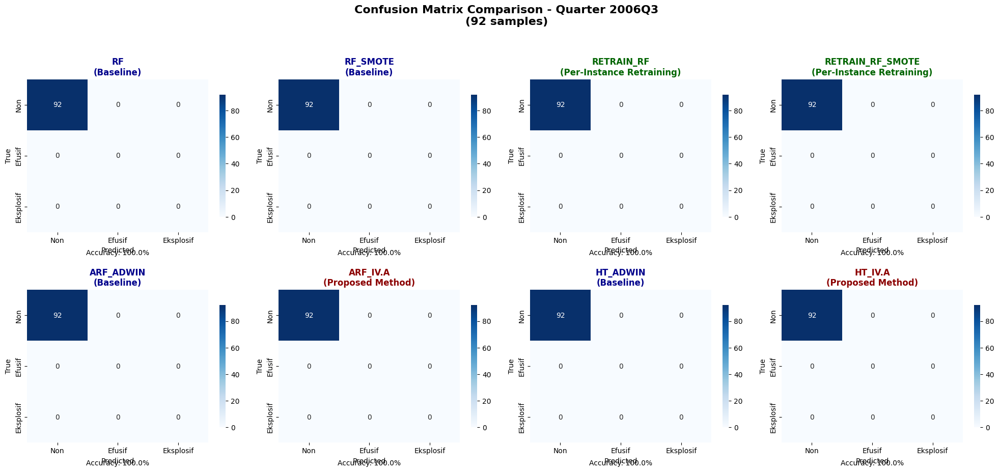


📈 Quarter 2006Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




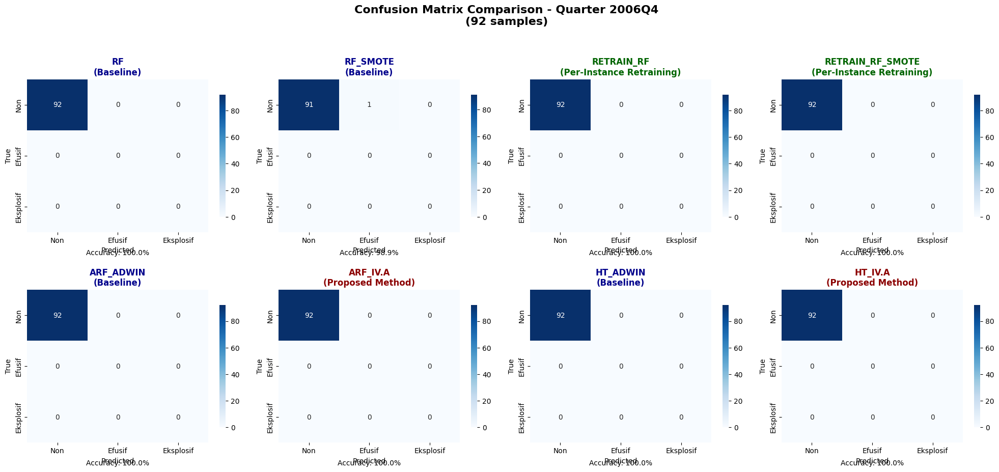


📈 Quarter 2006Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  98.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




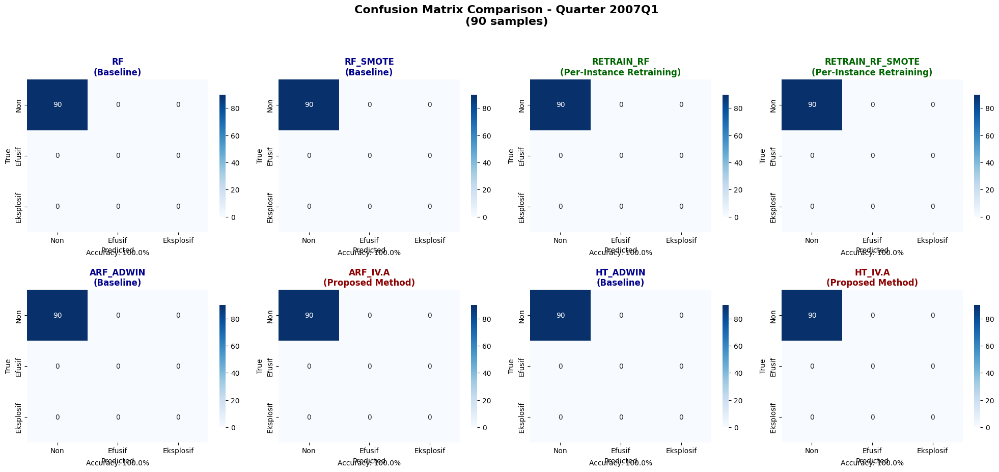


📈 Quarter 2007Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




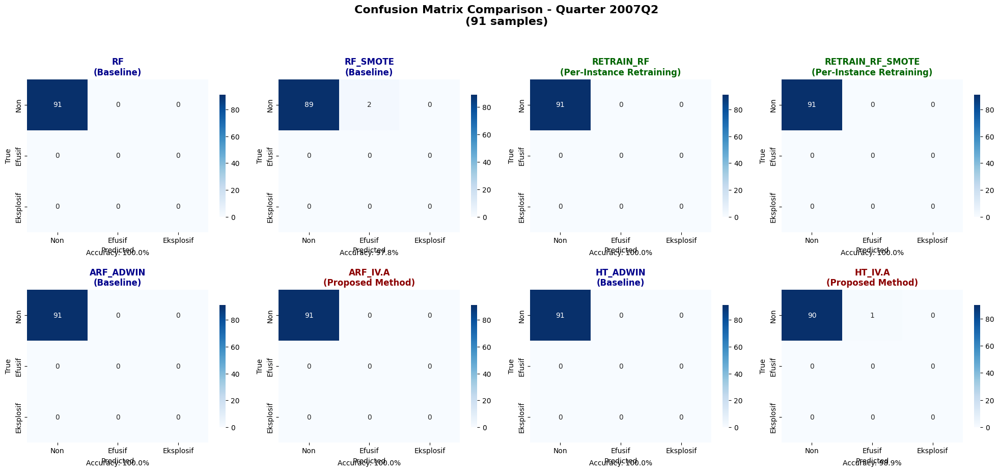


📈 Quarter 2007Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  98.9%




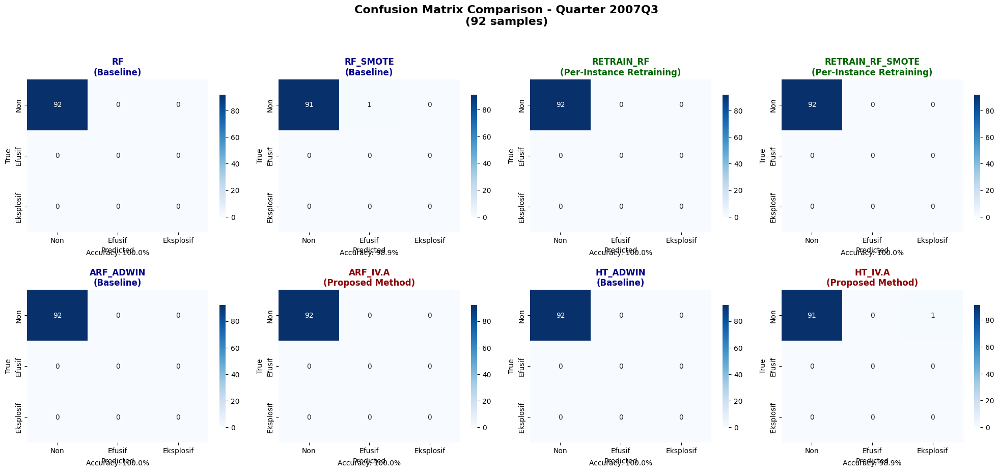


📈 Quarter 2007Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  98.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  98.9%




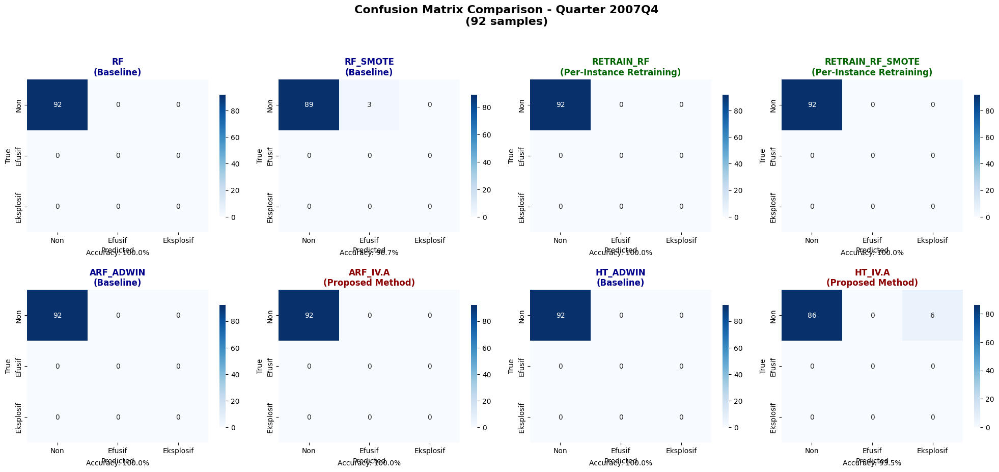


📈 Quarter 2007Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  96.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  93.5%




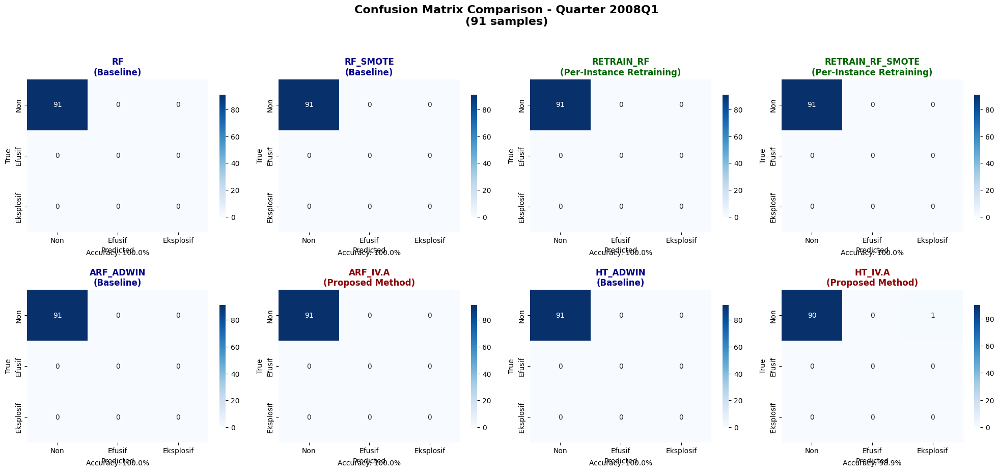


📈 Quarter 2008Q1 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  98.9%




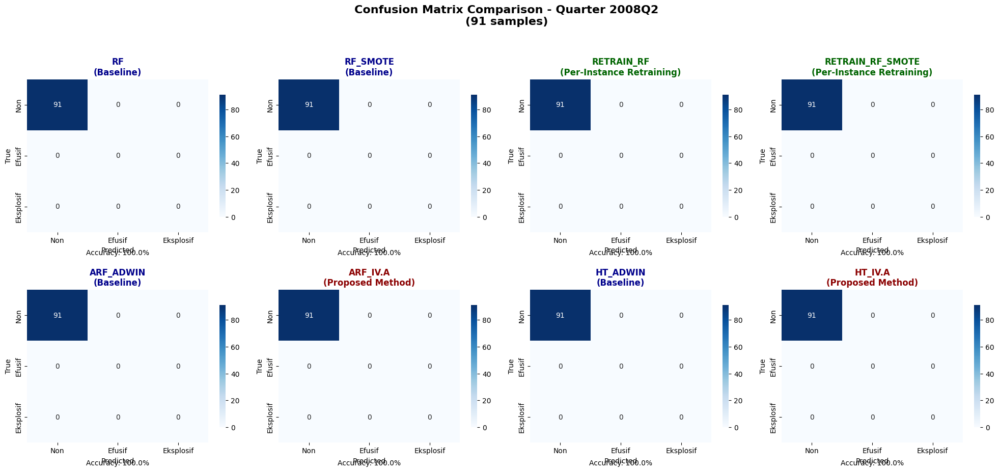


📈 Quarter 2008Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




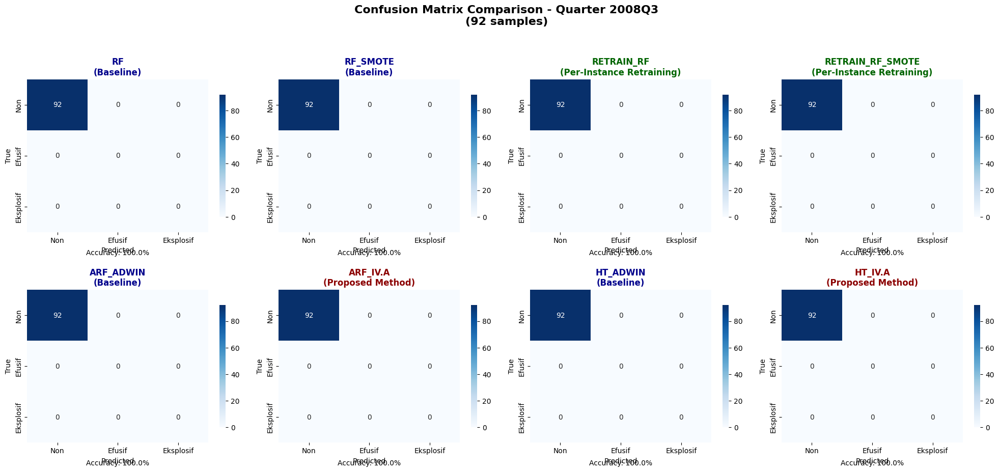


📈 Quarter 2008Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




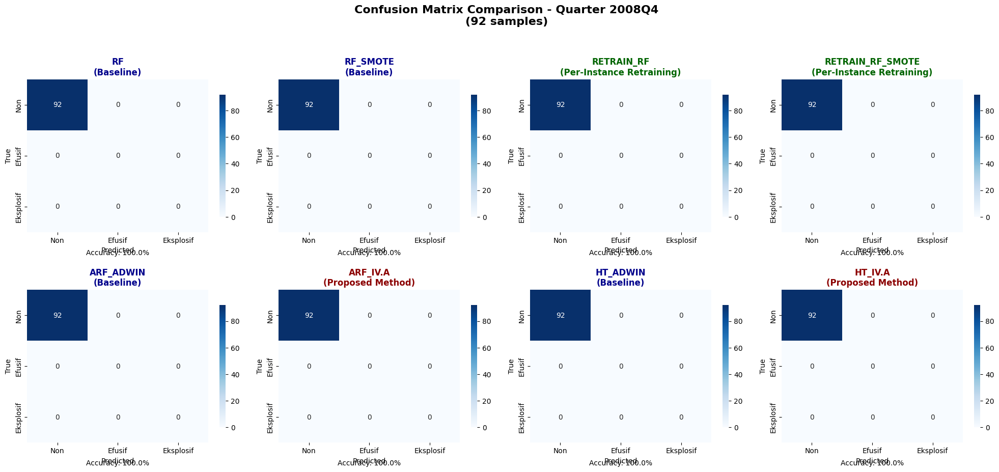


📈 Quarter 2008Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy: 100.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




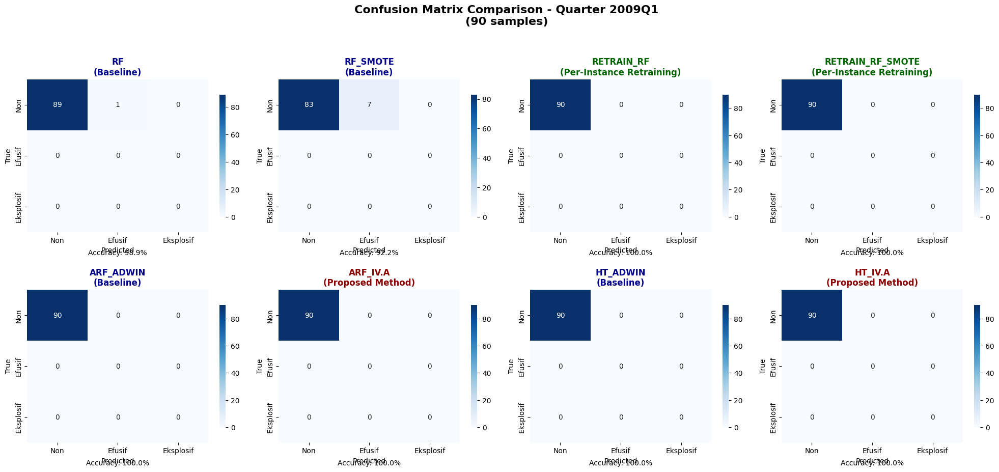


📈 Quarter 2009Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  92.2%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




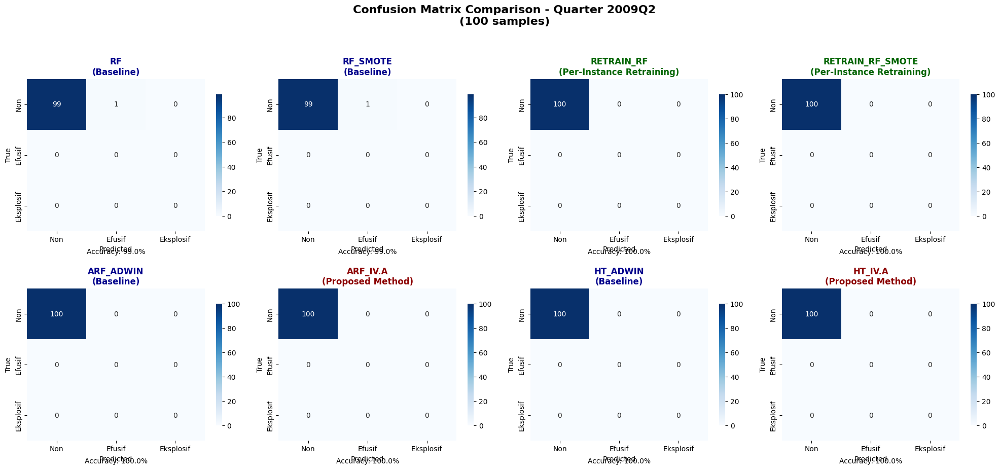


📈 Quarter 2009Q2 Summary (100 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  99.0%
RF_SMOTE             [BASELINE]      Accuracy:  99.0%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




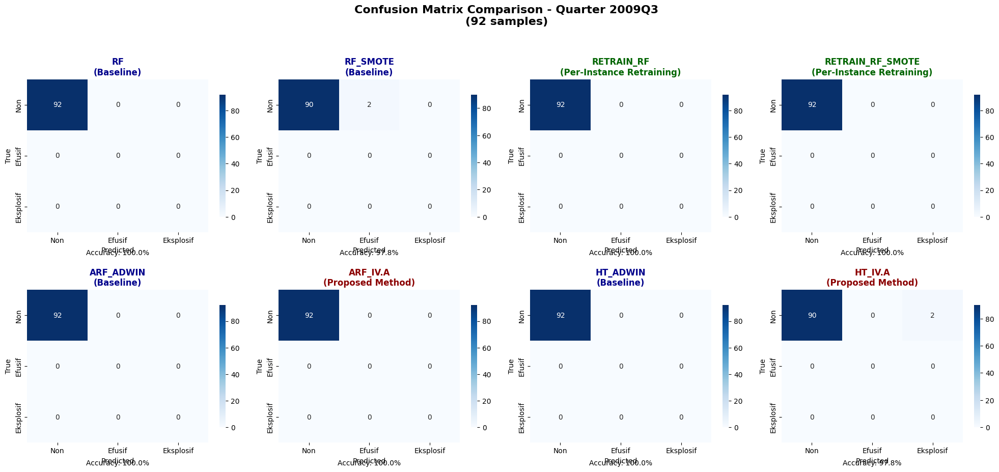


📈 Quarter 2009Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy: 100.0%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy:  97.8%




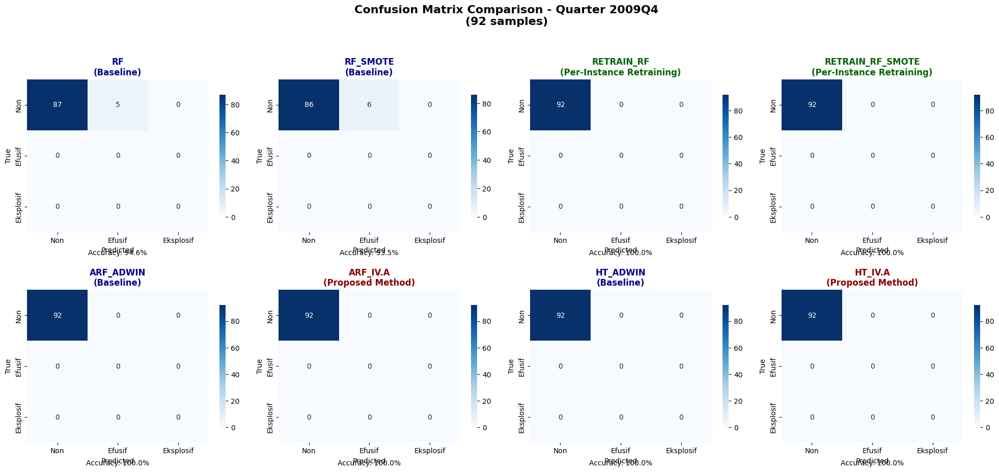


📈 Quarter 2009Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  94.6%
RF_SMOTE             [BASELINE]      Accuracy:  93.5%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




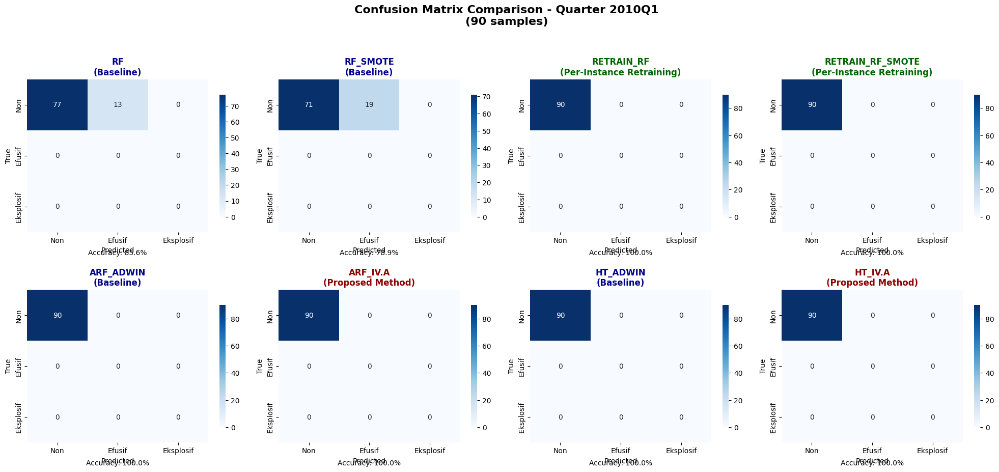


📈 Quarter 2010Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  85.6%
RF_SMOTE             [BASELINE]      Accuracy:  78.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




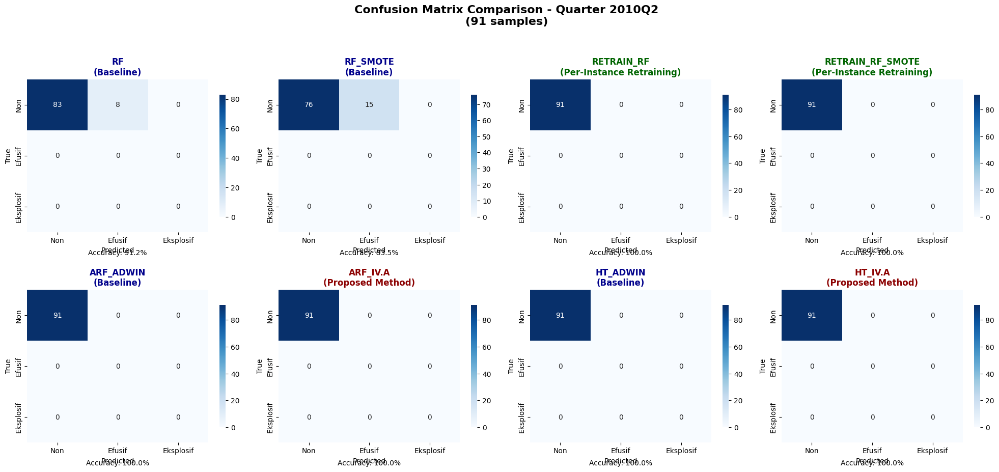


📈 Quarter 2010Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  91.2%
RF_SMOTE             [BASELINE]      Accuracy:  83.5%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




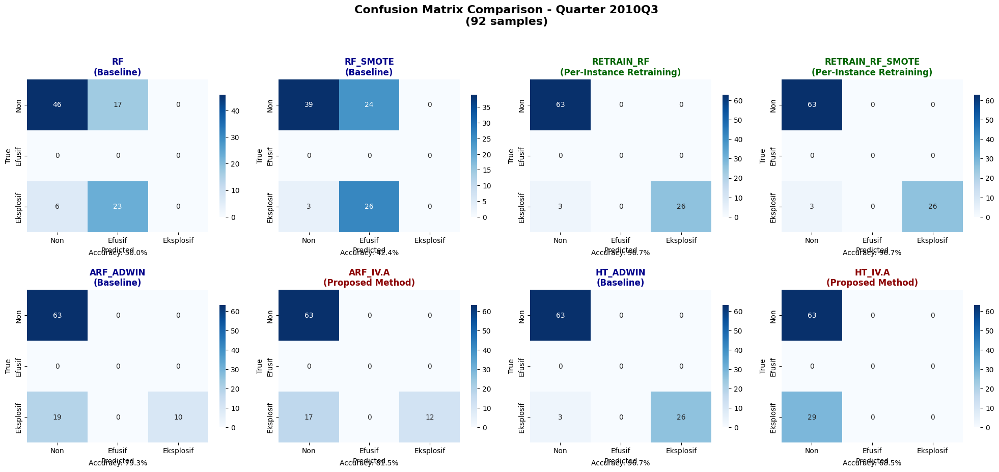


📈 Quarter 2010Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  50.0%
RF_SMOTE             [BASELINE]      Accuracy:  42.4%
RETRAIN_RF           [RETRAINING]    Accuracy:  96.7%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  96.7%
ARF_ADWIN            [BASELINE]      Accuracy:  79.3%
ARF_IV.A             [PROPOSED]      Accuracy:  81.5%
HT_ADWIN             [BASELINE]      Accuracy:  96.7%
HT_IV.A              [PROPOSED]      Accuracy:  68.5%




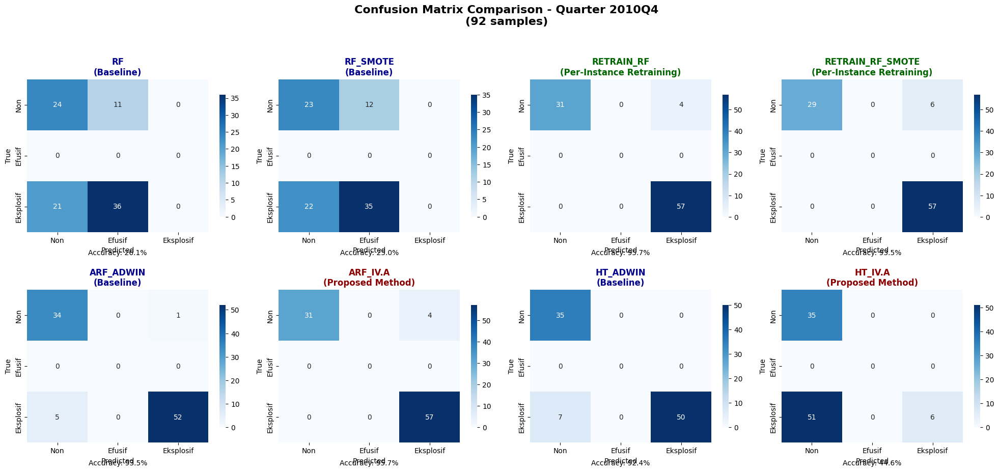


📈 Quarter 2010Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  26.1%
RF_SMOTE             [BASELINE]      Accuracy:  25.0%
RETRAIN_RF           [RETRAINING]    Accuracy:  95.7%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  93.5%
ARF_ADWIN            [BASELINE]      Accuracy:  93.5%
ARF_IV.A             [PROPOSED]      Accuracy:  95.7%
HT_ADWIN             [BASELINE]      Accuracy:  92.4%
HT_IV.A              [PROPOSED]      Accuracy:  44.6%




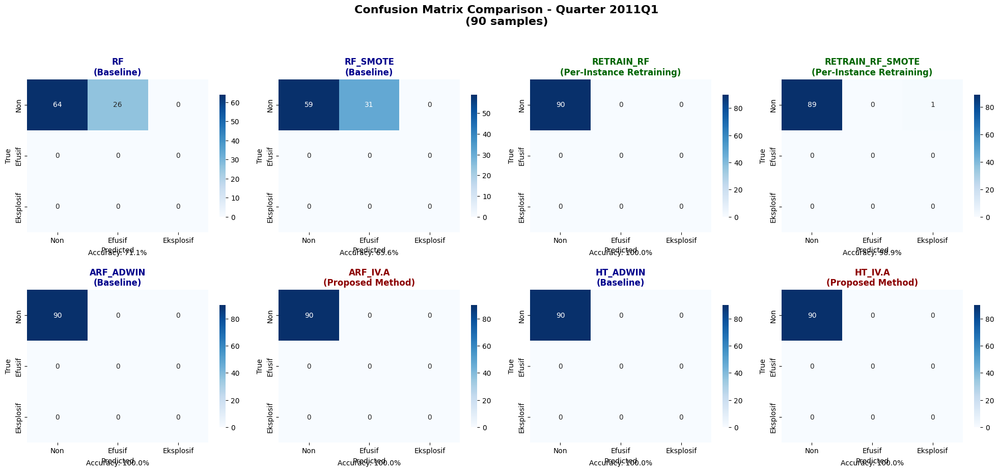


📈 Quarter 2011Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  71.1%
RF_SMOTE             [BASELINE]      Accuracy:  65.6%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  98.9%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




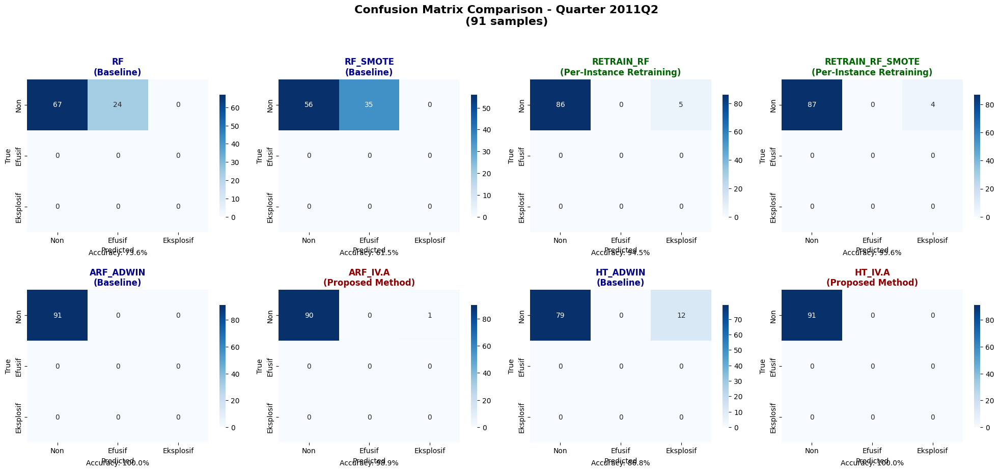


📈 Quarter 2011Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  73.6%
RF_SMOTE             [BASELINE]      Accuracy:  61.5%
RETRAIN_RF           [RETRAINING]    Accuracy:  94.5%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  95.6%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy:  98.9%
HT_ADWIN             [BASELINE]      Accuracy:  86.8%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




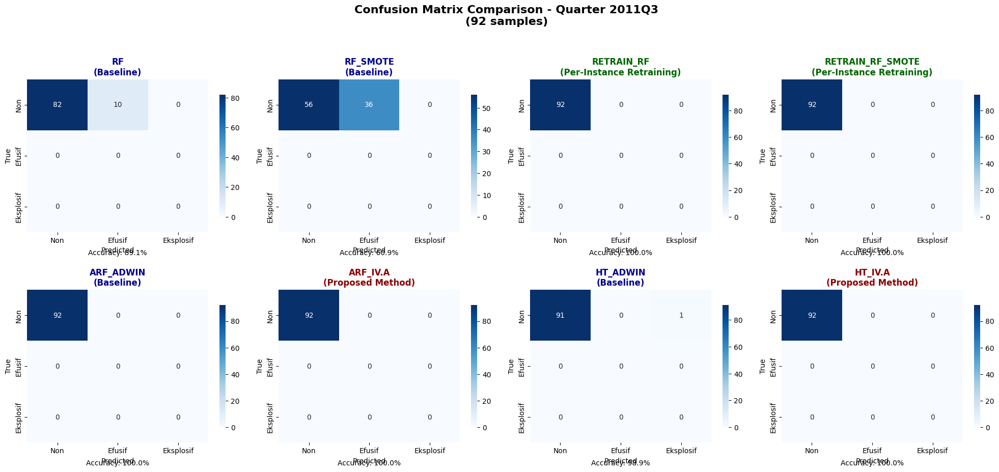


📈 Quarter 2011Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  89.1%
RF_SMOTE             [BASELINE]      Accuracy:  60.9%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy:  98.9%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




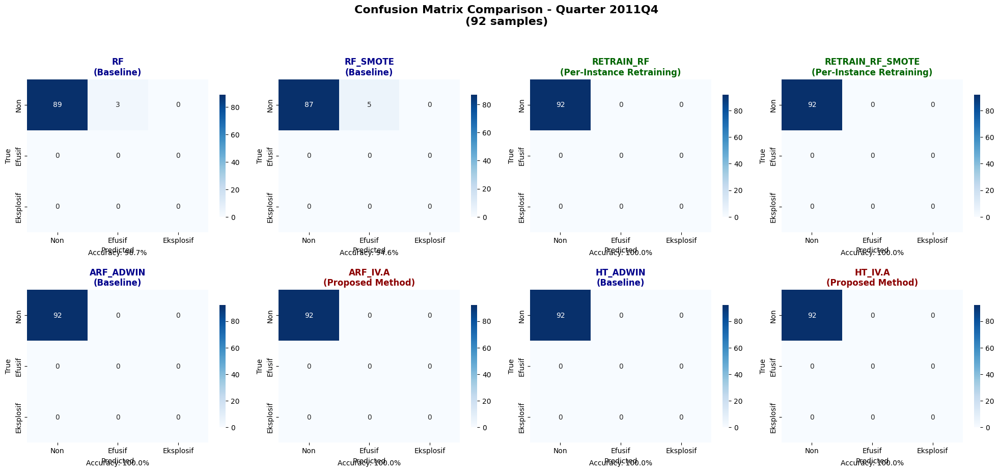


📈 Quarter 2011Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  96.7%
RF_SMOTE             [BASELINE]      Accuracy:  94.6%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




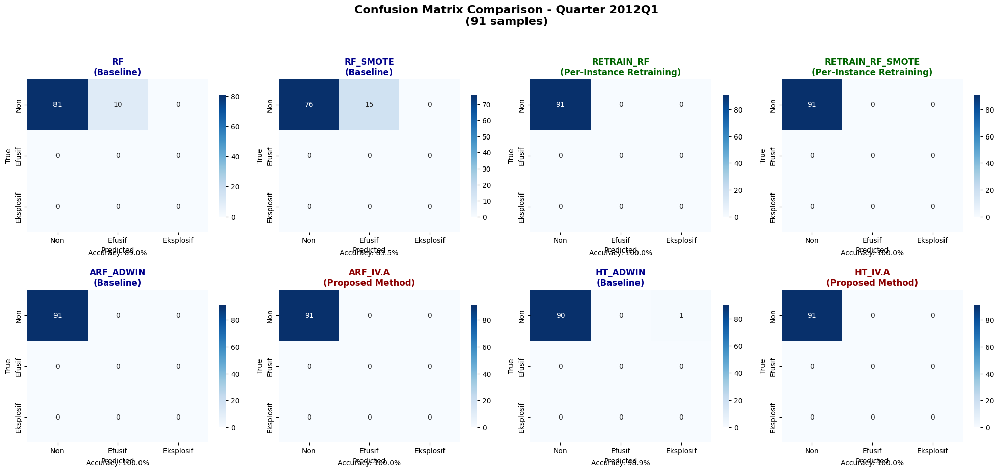


📈 Quarter 2012Q1 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  89.0%
RF_SMOTE             [BASELINE]      Accuracy:  83.5%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy:  98.9%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




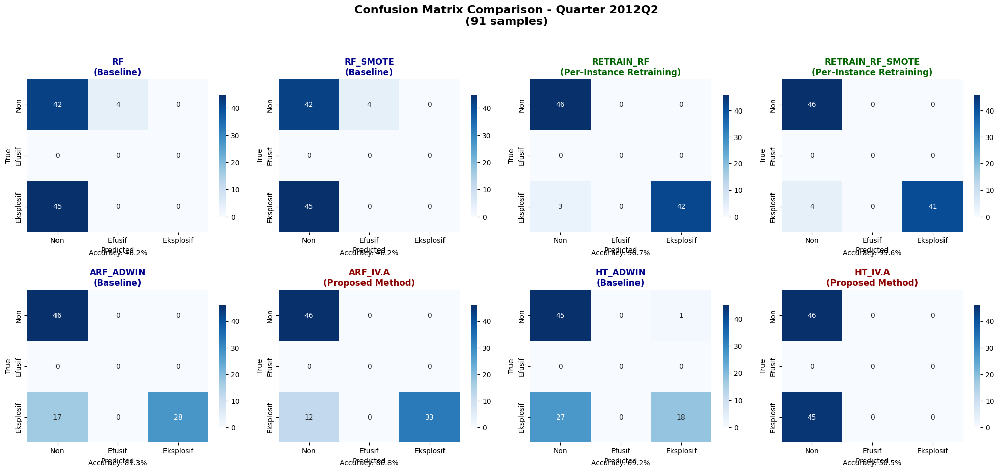


📈 Quarter 2012Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  46.2%
RF_SMOTE             [BASELINE]      Accuracy:  46.2%
RETRAIN_RF           [RETRAINING]    Accuracy:  96.7%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  95.6%
ARF_ADWIN            [BASELINE]      Accuracy:  81.3%
ARF_IV.A             [PROPOSED]      Accuracy:  86.8%
HT_ADWIN             [BASELINE]      Accuracy:  69.2%
HT_IV.A              [PROPOSED]      Accuracy:  50.5%




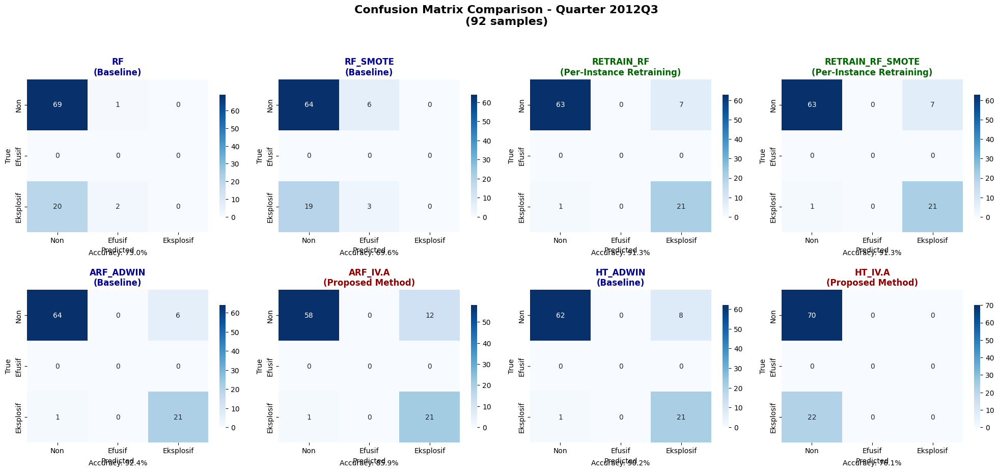


📈 Quarter 2012Q3 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  75.0%
RF_SMOTE             [BASELINE]      Accuracy:  69.6%
RETRAIN_RF           [RETRAINING]    Accuracy:  91.3%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy:  91.3%
ARF_ADWIN            [BASELINE]      Accuracy:  92.4%
ARF_IV.A             [PROPOSED]      Accuracy:  85.9%
HT_ADWIN             [BASELINE]      Accuracy:  90.2%
HT_IV.A              [PROPOSED]      Accuracy:  76.1%




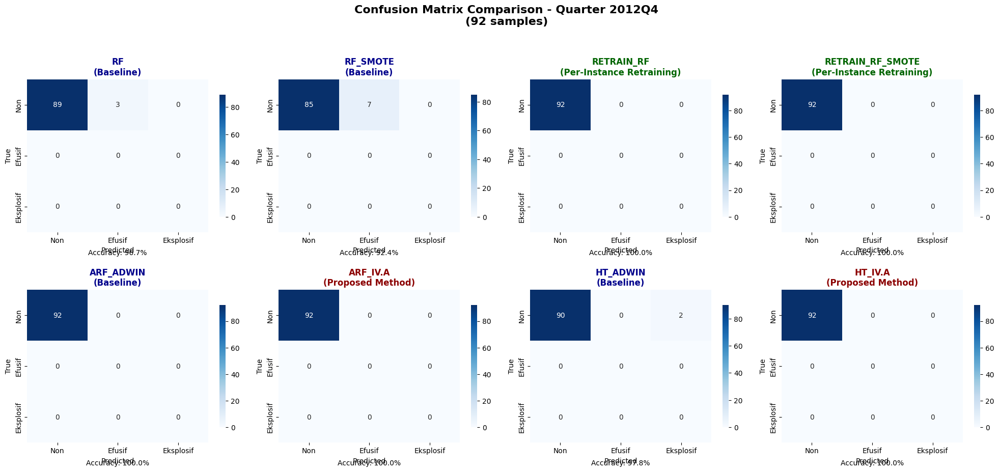


📈 Quarter 2012Q4 Summary (92 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  96.7%
RF_SMOTE             [BASELINE]      Accuracy:  92.4%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy:  97.8%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




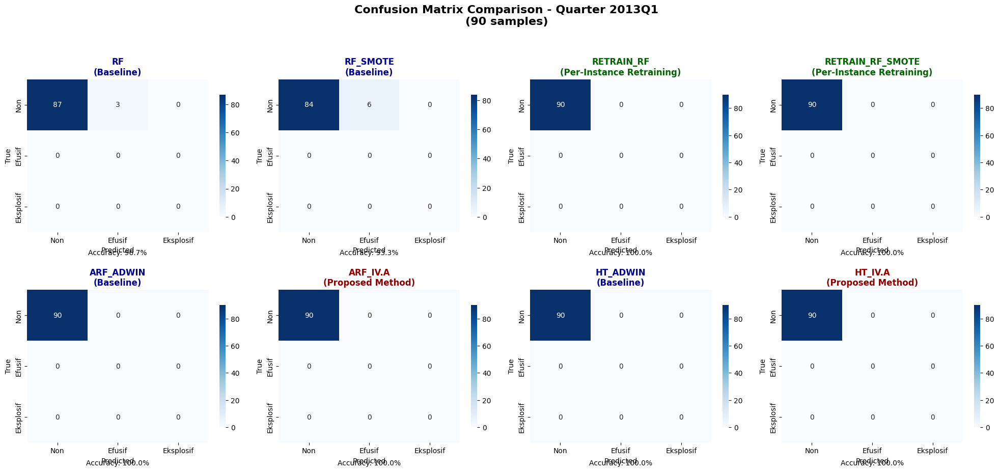


📈 Quarter 2013Q1 Summary (90 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  96.7%
RF_SMOTE             [BASELINE]      Accuracy:  93.3%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




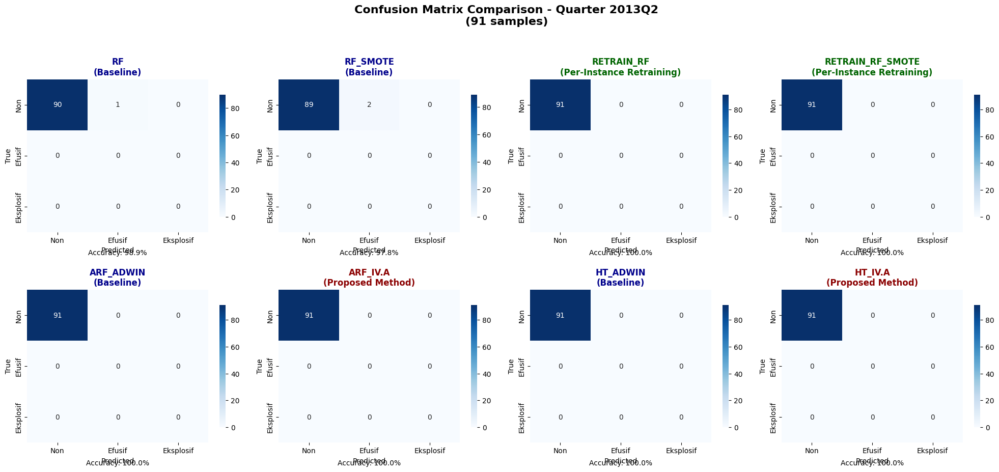


📈 Quarter 2013Q2 Summary (91 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  98.9%
RF_SMOTE             [BASELINE]      Accuracy:  97.8%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%




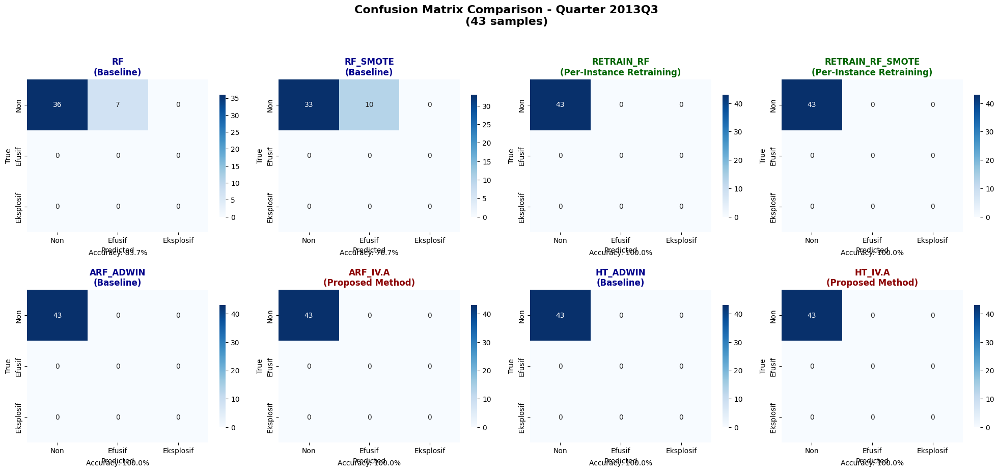


📈 Quarter 2013Q3 Summary (43 samples):
------------------------------------------------------------
RF                   [BASELINE]      Accuracy:  83.7%
RF_SMOTE             [BASELINE]      Accuracy:  76.7%
RETRAIN_RF           [RETRAINING]    Accuracy: 100.0%
RETRAIN_RF_SMOTE     [RETRAINING]    Accuracy: 100.0%
ARF_ADWIN            [BASELINE]      Accuracy: 100.0%
ARF_IV.A             [PROPOSED]      Accuracy: 100.0%
HT_ADWIN             [BASELINE]      Accuracy: 100.0%
HT_IV.A              [PROPOSED]      Accuracy: 100.0%


✅ All confusion matrices generated successfully!

📊 GENERATING OVERALL CONFUSION MATRIX SUMMARY...


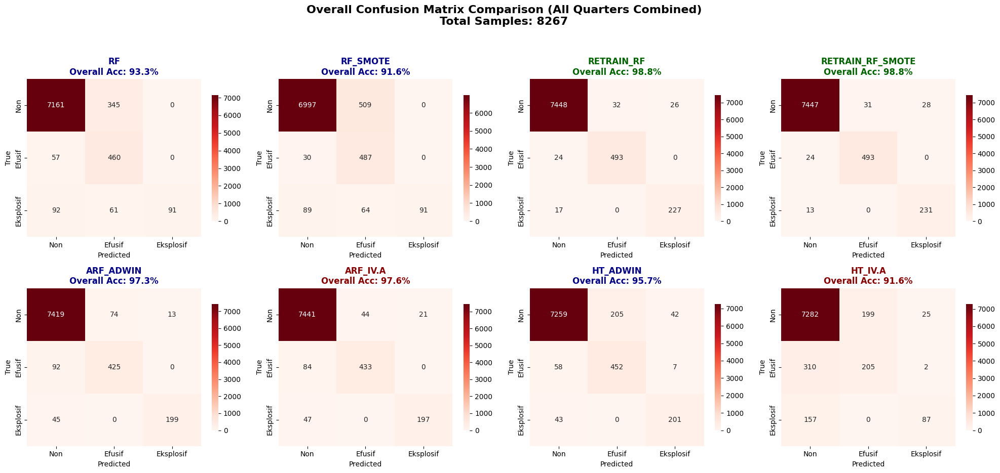

✅ Overall confusion matrix summary completed!


In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Siapkan dataframe evaluasi - INCLUDING RETRAINING MODELS
eval_df = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'RETRAIN_RF': retrain_rf_pred,  # Add retraining RF
    'RETRAIN_RF_SMOTE': retrain_rf_smote_pred,  # Add retraining RF + SMOTE
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_IV.A': arf_sel_pred,
    'HT_ADWIN': ht_adwin_pred,
    'HT_IV.A': ht_sel_pred
})

# Tambahkan kolom periodik triwulan
eval_df['Period'] = eval_df['Date'].dt.to_period('Q')

# Ambil semua period unik setelah tahun 2000
periods = sorted(eval_df[eval_df['Date'].dt.year >= 2000]['Period'].unique())

# Atur layout model dalam grid 2x4 untuk menampilkan semua 8 model
models = [
    ['RF', 'RF_SMOTE', 'RETRAIN_RF', 'RETRAIN_RF_SMOTE'],           # Row 1: Static & Retraining baselines
    ['ARF_ADWIN', 'ARF_IV.A', 'HT_ADWIN', 'HT_IV.A']               # Row 2: Incremental learning models
]
labels = ['Non', 'Efusif', 'Eksplosif']

print(f"📊 Generating confusion matrices for {len(periods)} quarters...")
print(f"🔍 Models included: 8 total (Static, Retraining, Incremental)")

# Loop tiap periode
for period in periods:
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))  # Grid 2x4 for all 8 models
    quarter_data = eval_df[eval_df['Period'] == period]
    
    # Check if quarter has data
    if quarter_data.empty:
        print(f"⚠️ No data for period {period}, skipping...")
        continue

    for row in range(2):
        for col in range(4):
            model = models[row][col]
            ax = axes[row, col]
            
            # Calculate confusion matrix
            cm = confusion_matrix(quarter_data['True'], quarter_data[model], labels=[0, 1, 2])
            
            # Create heatmap with custom styling
            sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax,
                        xticklabels=labels, yticklabels=labels,
                        cbar_kws={'shrink': 0.8})
            
            # Set titles with model type indication
            if model.startswith('RETRAIN'):
                ax.set_title(f'{model}\n(Per-Instance Retraining)', fontweight='bold', color='darkgreen')
            elif model in ['ARF_IV.A', 'HT_IV.A']:
                ax.set_title(f'{model}\n(Proposed Method)', fontweight='bold', color='darkred')
            else:
                ax.set_title(f'{model}\n(Baseline)', fontweight='bold', color='darkblue')
            
            ax.set_xlabel('Predicted')
            ax.set_ylabel('True')
            
            # Add accuracy score on each subplot
            accuracy = (cm.diagonal().sum() / cm.sum()) * 100
            ax.text(0.5, -0.15, f'Accuracy: {accuracy:.1f}%', 
                   transform=ax.transAxes, ha='center', fontsize=10)

    # Add comprehensive title
    plt.suptitle(f'Confusion Matrix Comparison - Quarter {period}\n'
                 f'({len(quarter_data)} samples)', fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    plt.show()
    
    # Print summary statistics for this quarter
    print(f"\n📈 Quarter {period} Summary ({len(quarter_data)} samples):")
    print("-" * 60)
    
    # Calculate per-model accuracy for this quarter
    for row in range(2):
        for col in range(4):
            model = models[row][col]
            cm = confusion_matrix(quarter_data['True'], quarter_data[model], labels=[0, 1, 2])
            accuracy = (cm.diagonal().sum() / cm.sum()) * 100
            
            # Model type indicator
            model_type = ""
            if model.startswith('RETRAIN'):
                model_type = "[RETRAINING]"
            elif model in ['ARF_IV.A', 'HT_IV.A']:
                model_type = "[PROPOSED]"
            else:
                model_type = "[BASELINE]"
            
            print(f"{model:20} {model_type:15} Accuracy: {accuracy:5.1f}%")
    
    print("\n" + "="*70 + "\n")

print("✅ All confusion matrices generated successfully!")

# === OPTIONAL: Generate summary comparison across all quarters ===
print("\n📊 GENERATING OVERALL CONFUSION MATRIX SUMMARY...")

# Calculate overall confusion matrices (aggregated across all quarters)
overall_cms = {}
for row in range(2):
    for col in range(4):
        model = models[row][col]
        overall_cm = confusion_matrix(eval_df['True'], eval_df[model], labels=[0, 1, 2])
        overall_cms[model] = overall_cm

# Plot overall comparison
fig, axes = plt.subplots(2, 4, figsize=(20, 10))
for row in range(2):
    for col in range(4):
        model = models[row][col]
        ax = axes[row, col]
        cm = overall_cms[model]
        
        sns.heatmap(cm, annot=True, fmt='d', cmap='Reds', ax=ax,
                    xticklabels=labels, yticklabels=labels,
                    cbar_kws={'shrink': 0.8})
        
        # Overall accuracy
        accuracy = (cm.diagonal().sum() / cm.sum()) * 100
        
        if model.startswith('RETRAIN'):
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', fontweight='bold', color='darkgreen')
        elif model in ['ARF_IV.A', 'HT_IV.A']:
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', fontweight='bold', color='darkred')
        else:
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', fontweight='bold', color='darkblue')
        
        ax.set_xlabel('Predicted')
        ax.set_ylabel('True')

plt.suptitle('Overall Confusion Matrix Comparison (All Quarters Combined)\n'
             f'Total Samples: {len(eval_df)}', fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()

print("✅ Overall confusion matrix summary completed!")

📊 Generating and saving confusion matrices for 55 quarters...
🔍 Models included: 8 total (Static, Retraining, Incremental)
💾 Saving to folder: confusion_matrices_per_quarter_with_retraining


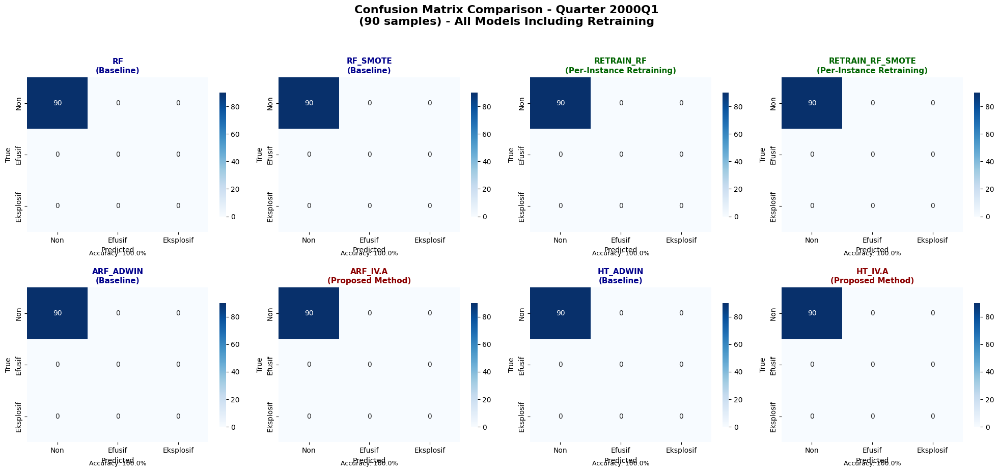


📈 Quarter 2000Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2000Q1.png



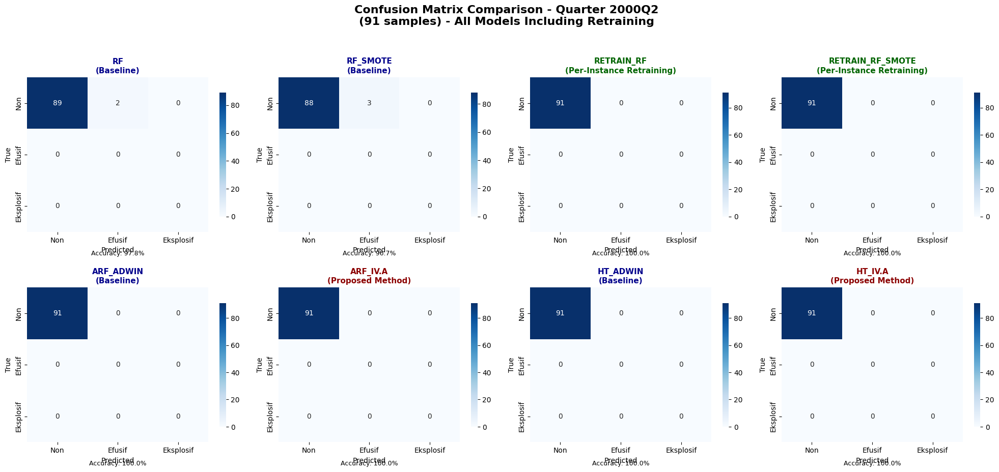


📈 Quarter 2000Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  97.8% | F1: 0.989
RF_SMOTE             [BASELINE]   Acc:  96.7% | F1: 0.983
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2000Q2.png



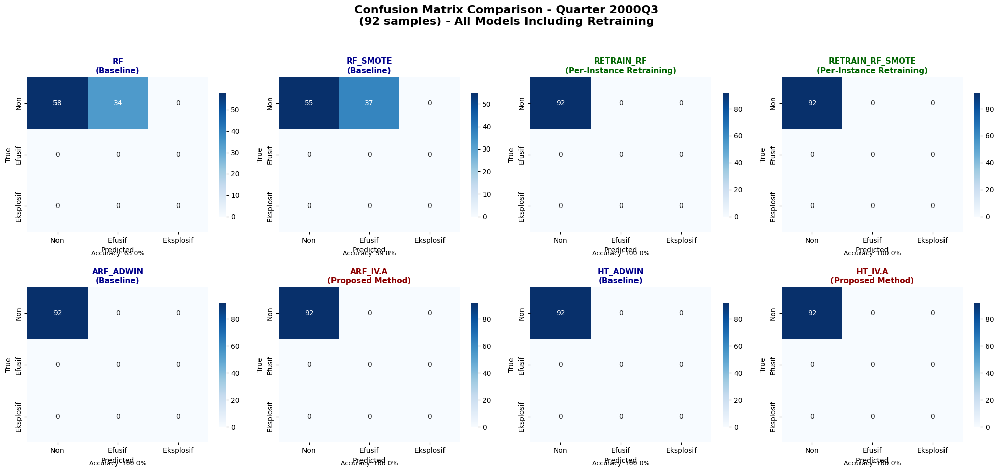


📈 Quarter 2000Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  63.0% | F1: 0.773
RF_SMOTE             [BASELINE]   Acc:  59.8% | F1: 0.748
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2000Q3.png



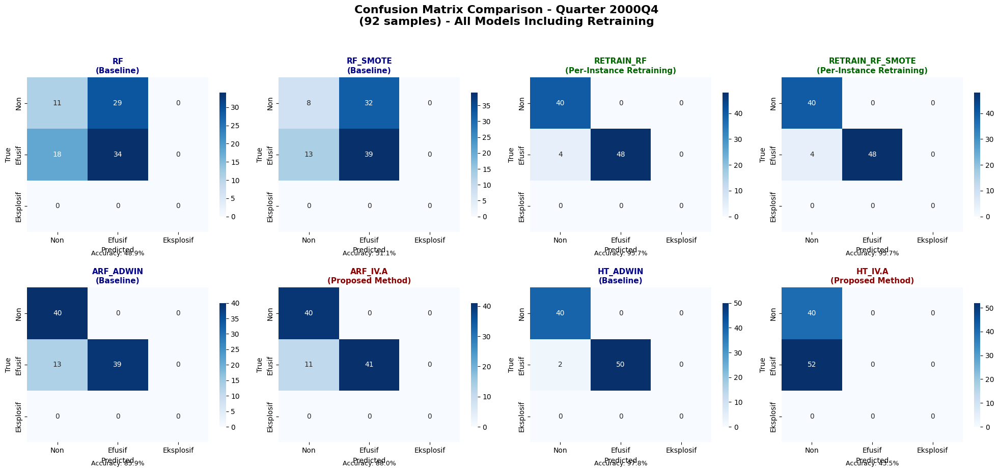


📈 Quarter 2000Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  48.9% | F1: 0.473
RF_SMOTE             [BASELINE]   Acc:  51.1% | F1: 0.472
RETRAIN_RF           [RETRAINING] Acc:  95.7% | F1: 0.957
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  95.7% | F1: 0.957
ARF_ADWIN            [BASELINE]   Acc:  85.9% | F1: 0.858
ARF_IV.A             [PROPOSED]   Acc:  88.0% | F1: 0.881
HT_ADWIN             [BASELINE]   Acc:  97.8% | F1: 0.978
HT_IV.A              [PROPOSED]   Acc:  43.5% | F1: 0.264

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2000Q4.png



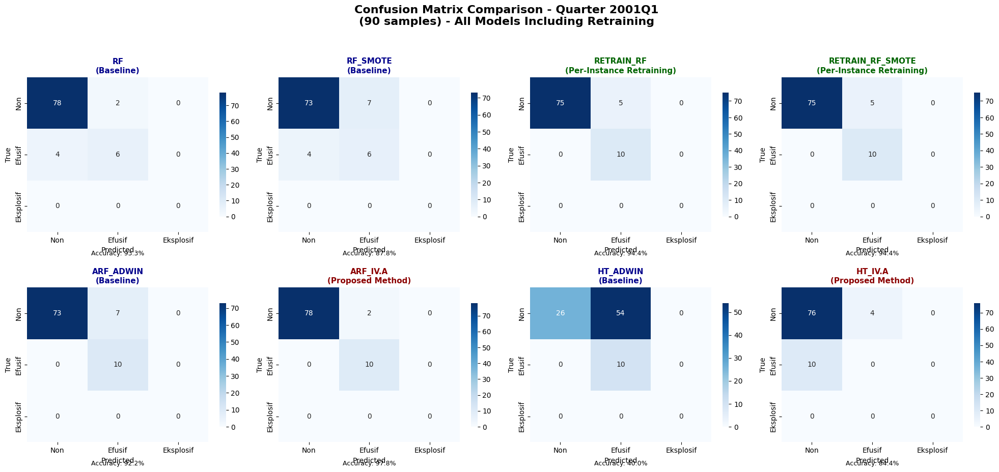


📈 Quarter 2001Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  93.3% | F1: 0.930
RF_SMOTE             [BASELINE]   Acc:  87.8% | F1: 0.885
RETRAIN_RF           [RETRAINING] Acc:  94.4% | F1: 0.949
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  94.4% | F1: 0.949
ARF_ADWIN            [BASELINE]   Acc:  92.2% | F1: 0.931
ARF_IV.A             [PROPOSED]   Acc:  97.8% | F1: 0.979
HT_ADWIN             [BASELINE]   Acc:  40.0% | F1: 0.466
HT_IV.A              [PROPOSED]   Acc:  84.4% | F1: 0.814

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2001Q1.png



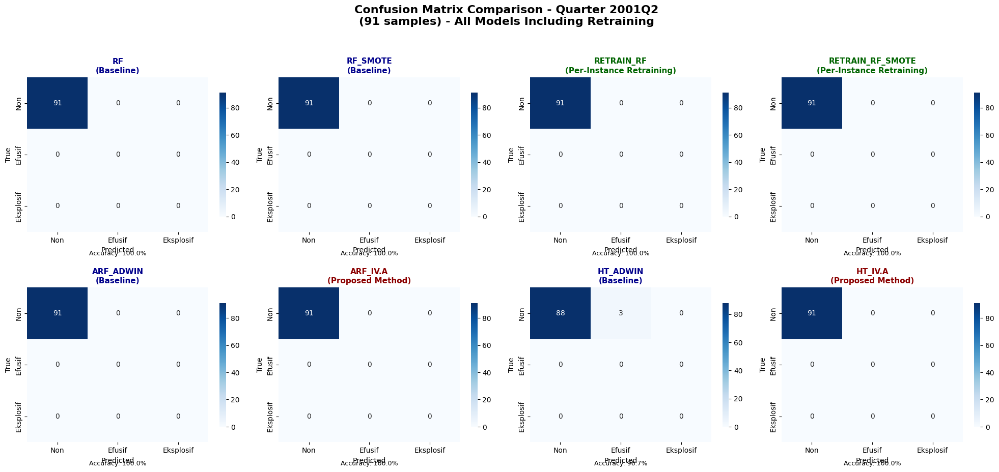


📈 Quarter 2001Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc:  96.7% | F1: 0.983
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2001Q2.png



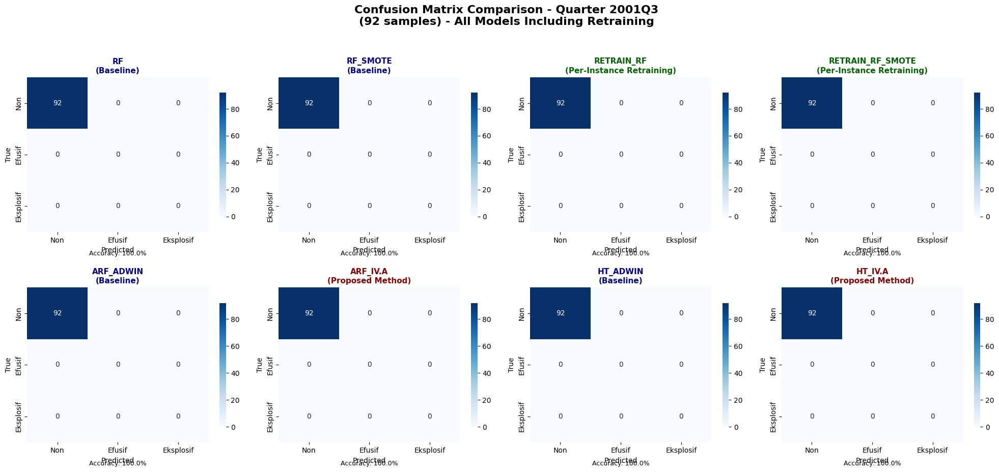


📈 Quarter 2001Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2001Q3.png



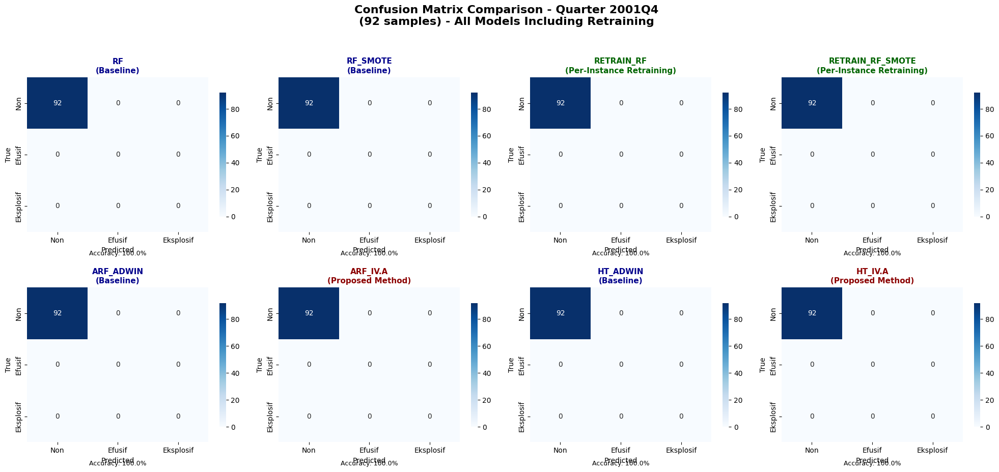


📈 Quarter 2001Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2001Q4.png



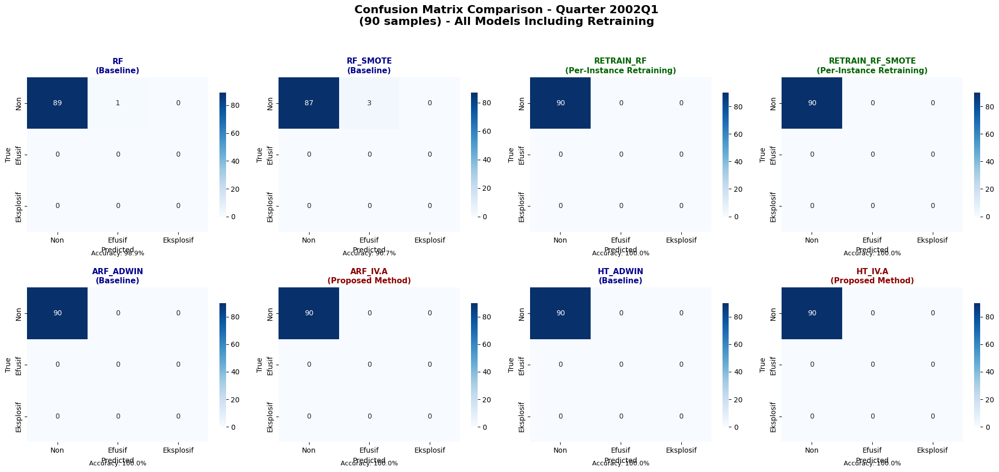


📈 Quarter 2002Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.994
RF_SMOTE             [BASELINE]   Acc:  96.7% | F1: 0.983
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2002Q1.png



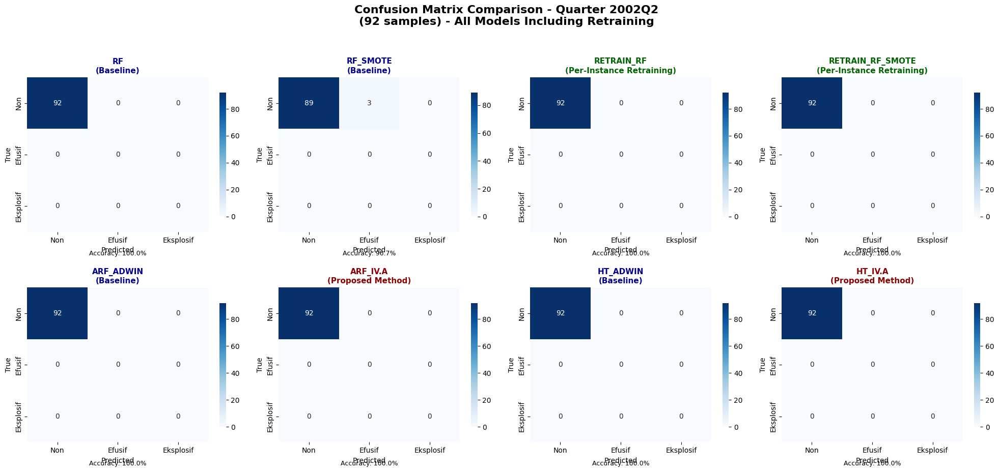


📈 Quarter 2002Q2 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  96.7% | F1: 0.983
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2002Q2.png



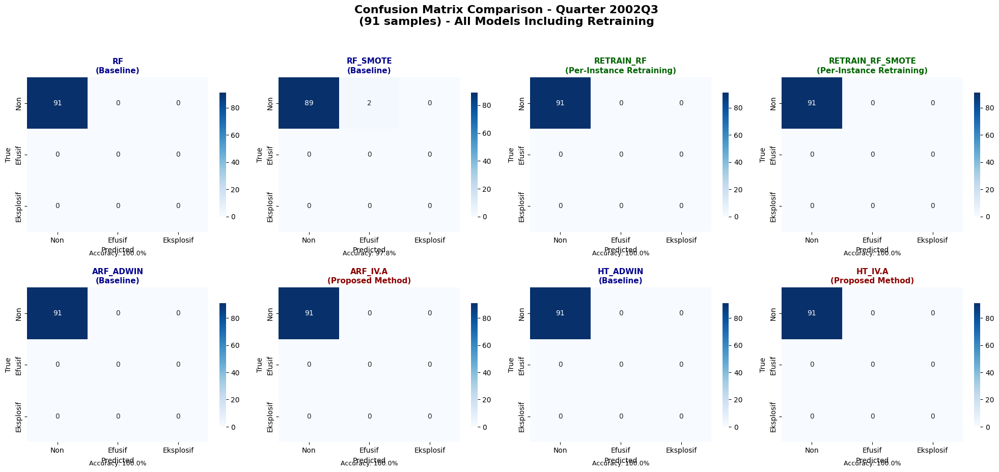


📈 Quarter 2002Q3 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2002Q3.png



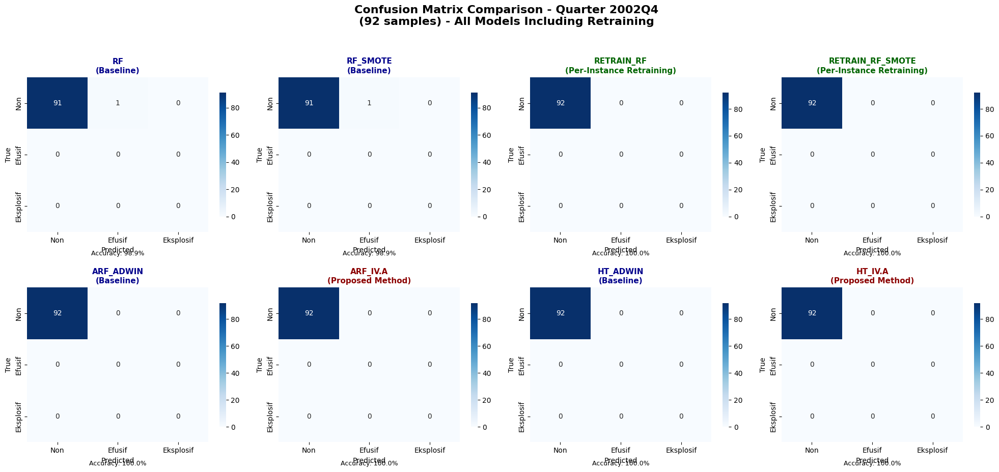


📈 Quarter 2002Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.995
RF_SMOTE             [BASELINE]   Acc:  98.9% | F1: 0.995
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2002Q4.png



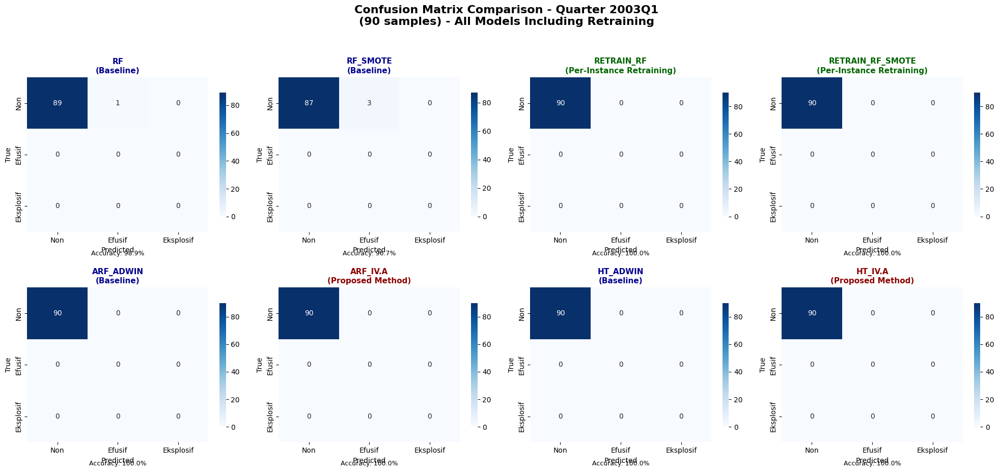


📈 Quarter 2003Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.994
RF_SMOTE             [BASELINE]   Acc:  96.7% | F1: 0.983
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2003Q1.png



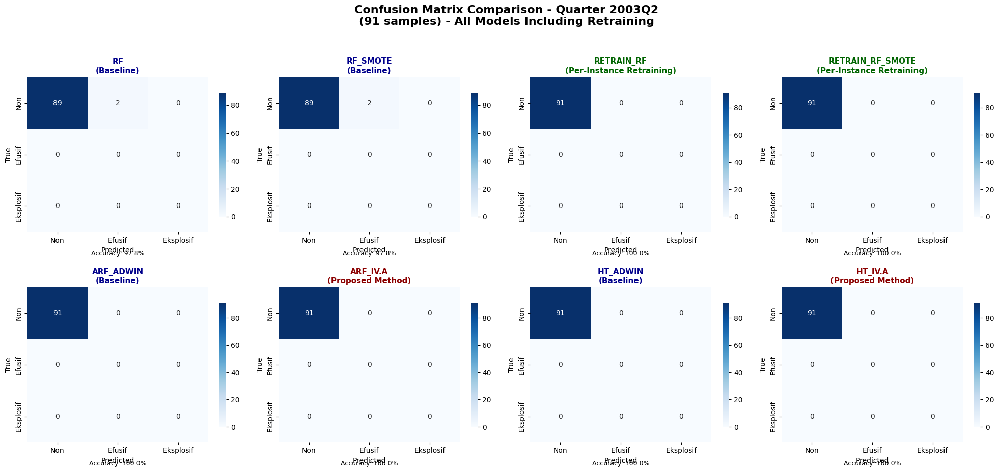


📈 Quarter 2003Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  97.8% | F1: 0.989
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2003Q2.png



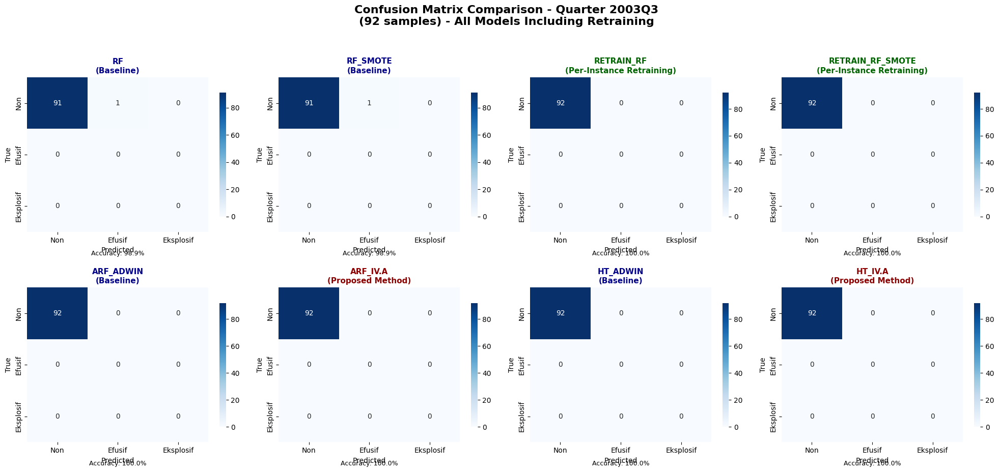


📈 Quarter 2003Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.995
RF_SMOTE             [BASELINE]   Acc:  98.9% | F1: 0.995
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2003Q3.png



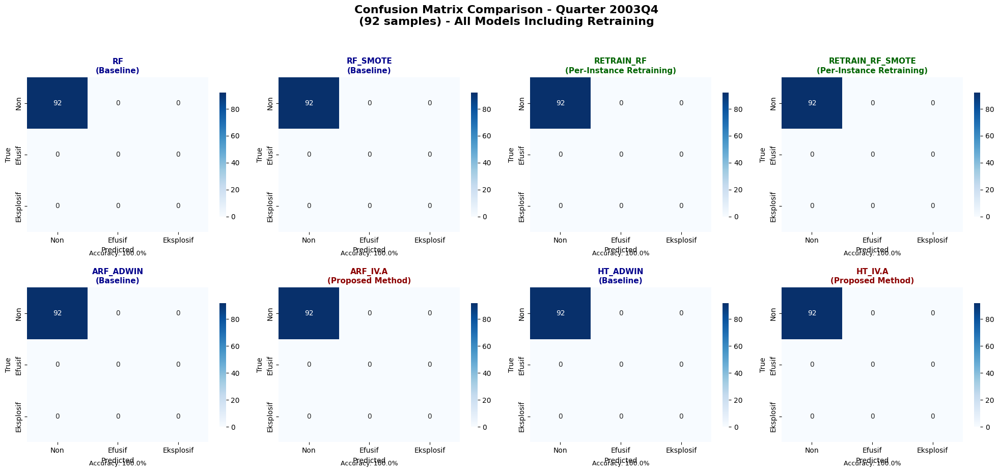


📈 Quarter 2003Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2003Q4.png



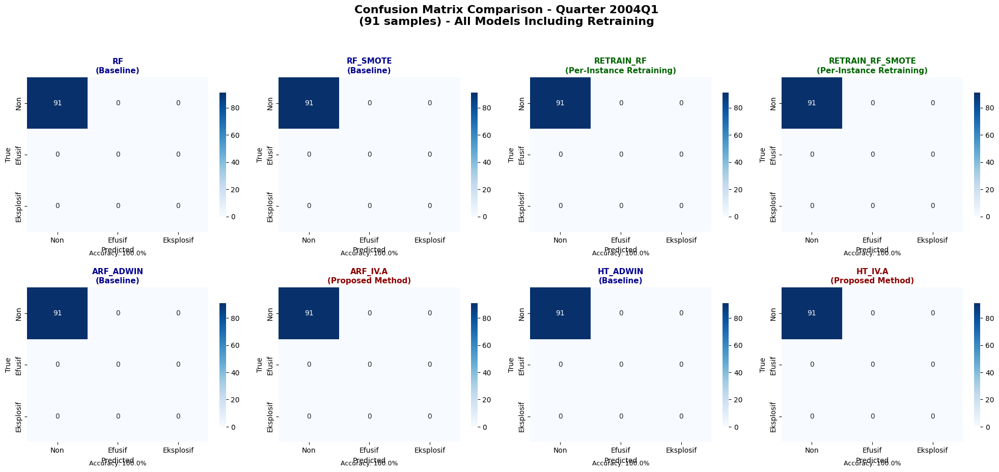


📈 Quarter 2004Q1 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2004Q1.png



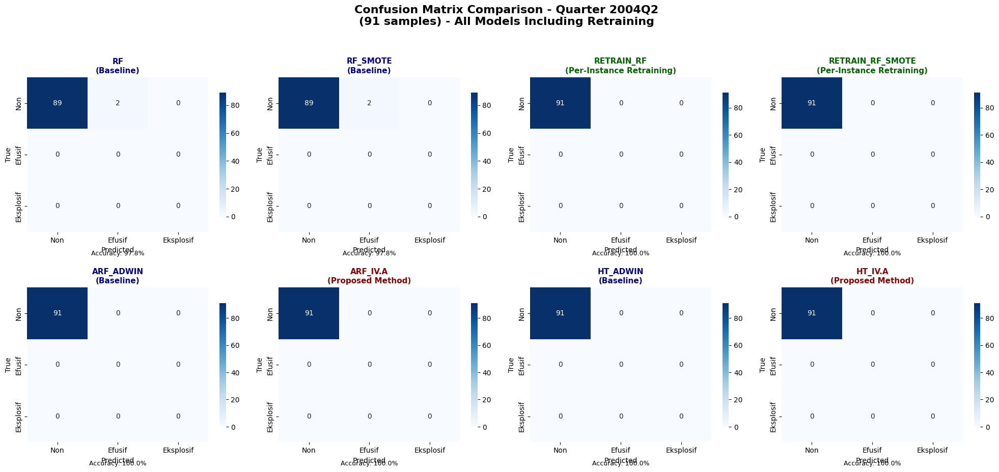


📈 Quarter 2004Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  97.8% | F1: 0.989
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2004Q2.png



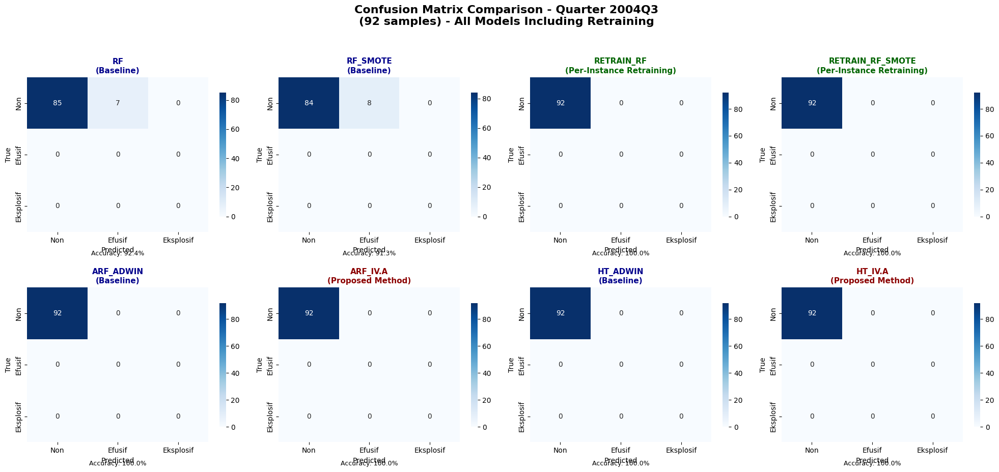


📈 Quarter 2004Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  92.4% | F1: 0.960
RF_SMOTE             [BASELINE]   Acc:  91.3% | F1: 0.955
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2004Q3.png



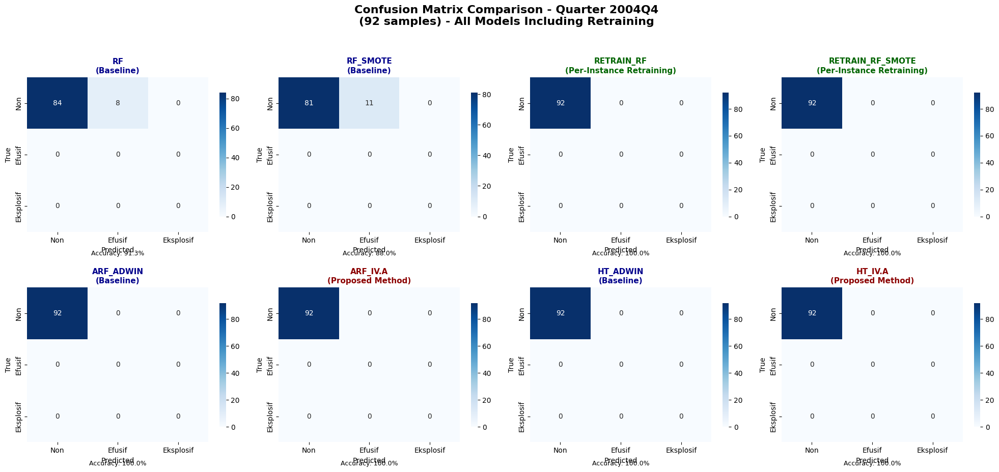


📈 Quarter 2004Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  91.3% | F1: 0.955
RF_SMOTE             [BASELINE]   Acc:  88.0% | F1: 0.936
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2004Q4.png



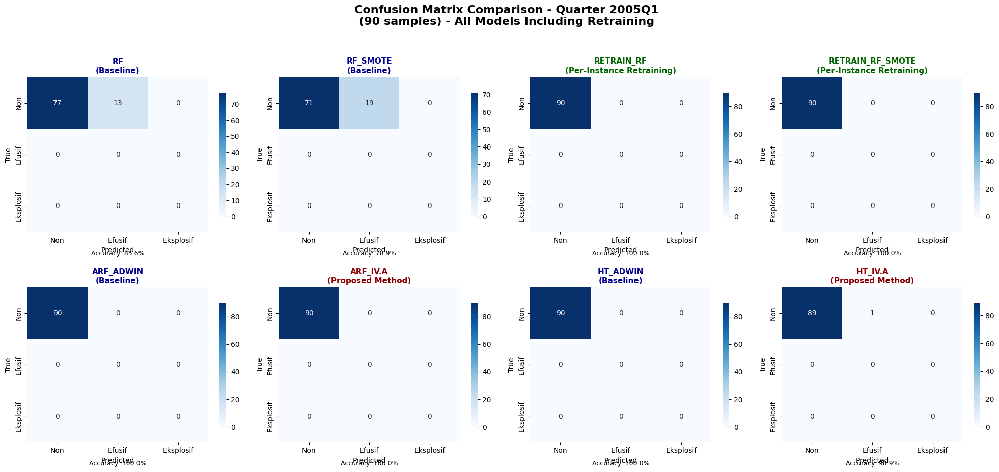


📈 Quarter 2005Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  85.6% | F1: 0.922
RF_SMOTE             [BASELINE]   Acc:  78.9% | F1: 0.882
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  98.9% | F1: 0.994

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2005Q1.png



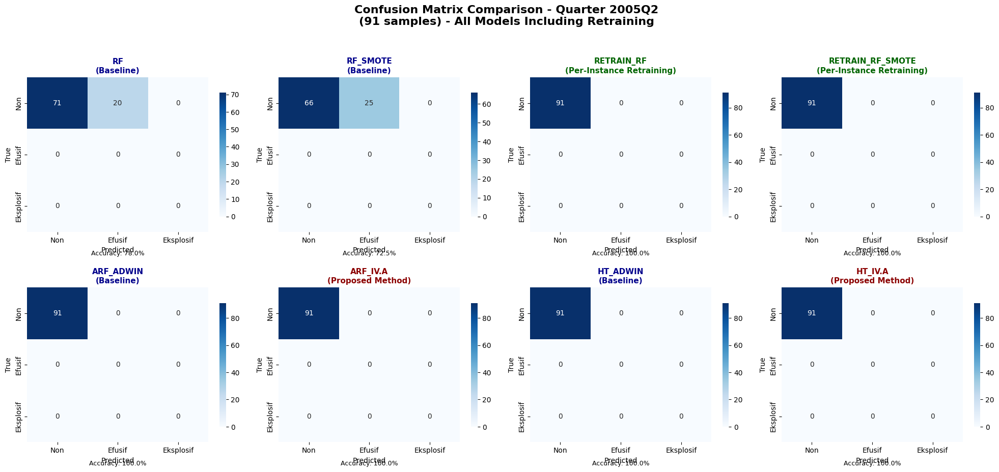


📈 Quarter 2005Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  78.0% | F1: 0.877
RF_SMOTE             [BASELINE]   Acc:  72.5% | F1: 0.841
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2005Q2.png



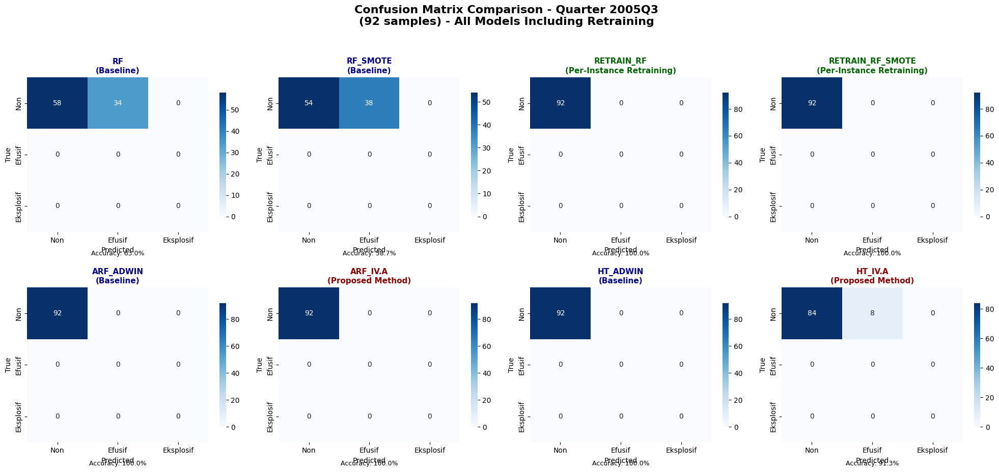


📈 Quarter 2005Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  63.0% | F1: 0.773
RF_SMOTE             [BASELINE]   Acc:  58.7% | F1: 0.740
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  91.3% | F1: 0.955

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2005Q3.png



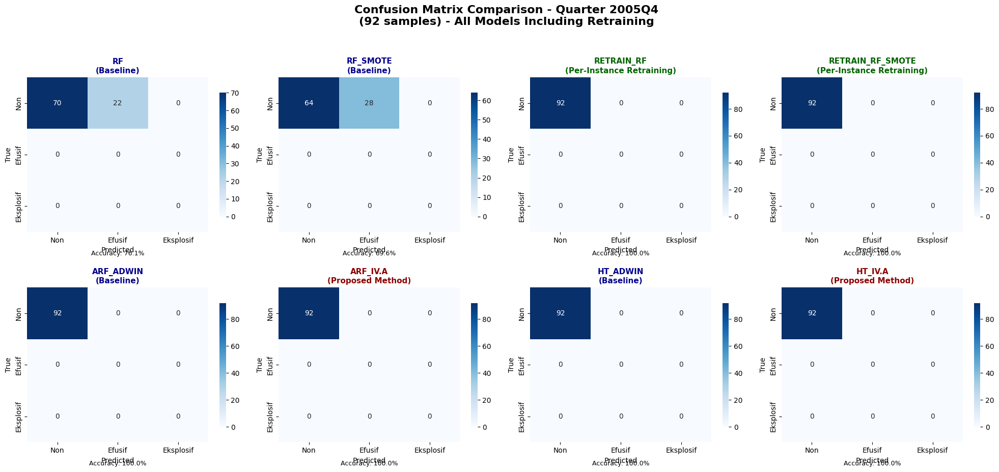


📈 Quarter 2005Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  76.1% | F1: 0.864
RF_SMOTE             [BASELINE]   Acc:  69.6% | F1: 0.821
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2005Q4.png



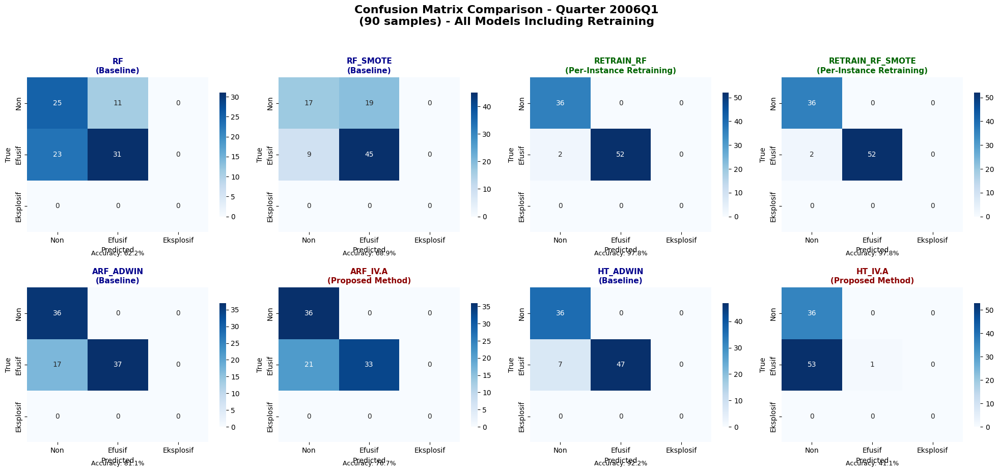


📈 Quarter 2006Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  62.2% | F1: 0.626
RF_SMOTE             [BASELINE]   Acc:  68.9% | F1: 0.677
RETRAIN_RF           [RETRAINING] Acc:  97.8% | F1: 0.978
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  97.8% | F1: 0.978
ARF_ADWIN            [BASELINE]   Acc:  81.1% | F1: 0.812
ARF_IV.A             [PROPOSED]   Acc:  76.7% | F1: 0.765
HT_ADWIN             [BASELINE]   Acc:  92.2% | F1: 0.923
HT_IV.A              [PROPOSED]   Acc:  41.1% | F1: 0.252

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2006Q1.png



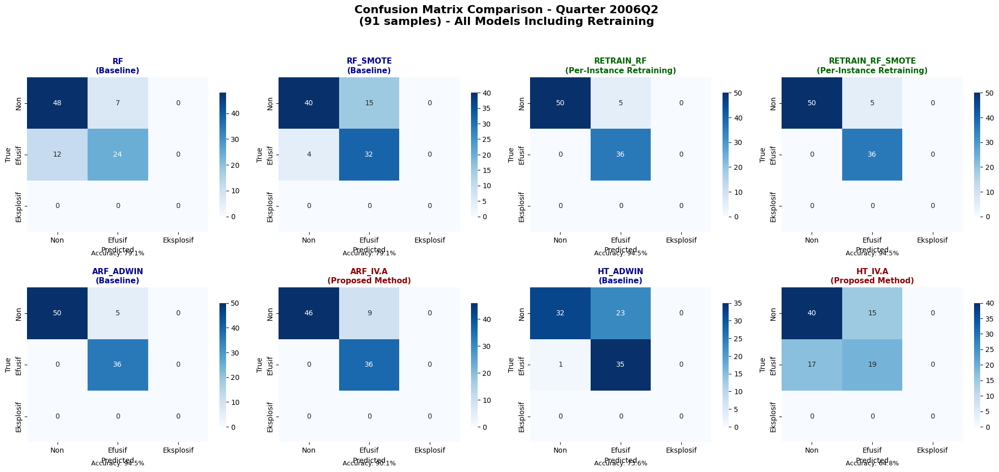


📈 Quarter 2006Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  79.1% | F1: 0.788
RF_SMOTE             [BASELINE]   Acc:  79.1% | F1: 0.793
RETRAIN_RF           [RETRAINING] Acc:  94.5% | F1: 0.946
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  94.5% | F1: 0.946
ARF_ADWIN            [BASELINE]   Acc:  94.5% | F1: 0.946
ARF_IV.A             [PROPOSED]   Acc:  90.1% | F1: 0.902
HT_ADWIN             [BASELINE]   Acc:  73.6% | F1: 0.734
HT_IV.A              [PROPOSED]   Acc:  64.8% | F1: 0.646

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2006Q2.png



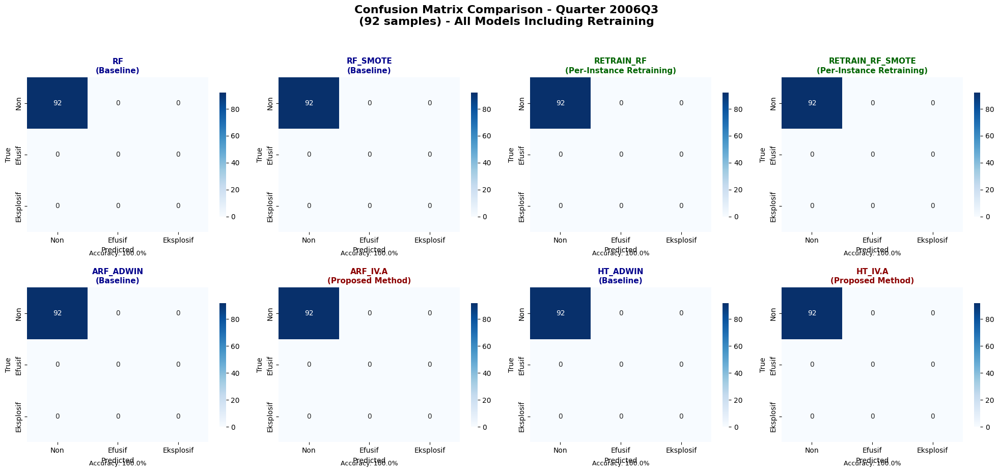


📈 Quarter 2006Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2006Q3.png



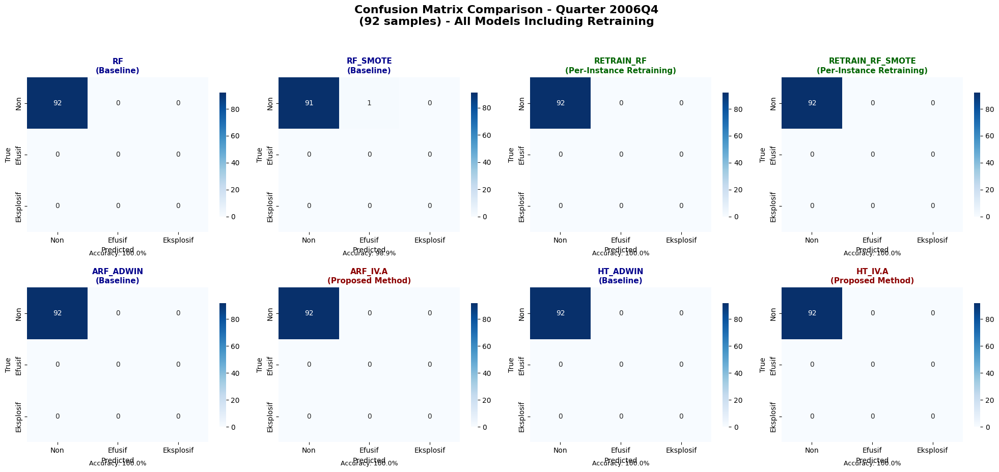


📈 Quarter 2006Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  98.9% | F1: 0.995
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2006Q4.png



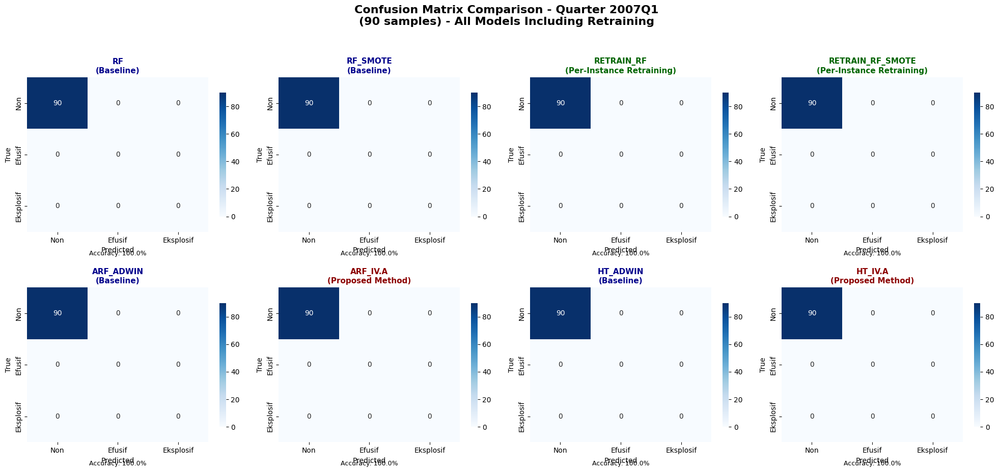


📈 Quarter 2007Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2007Q1.png



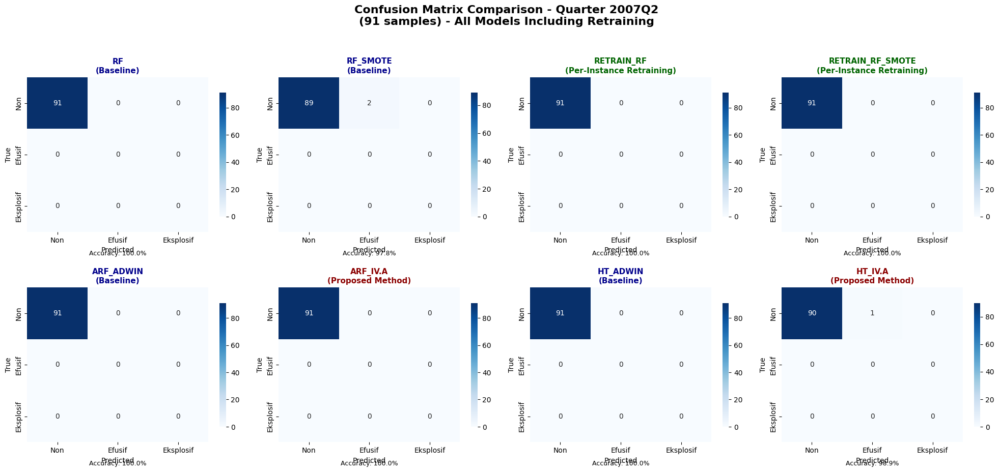


📈 Quarter 2007Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  98.9% | F1: 0.994

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2007Q2.png



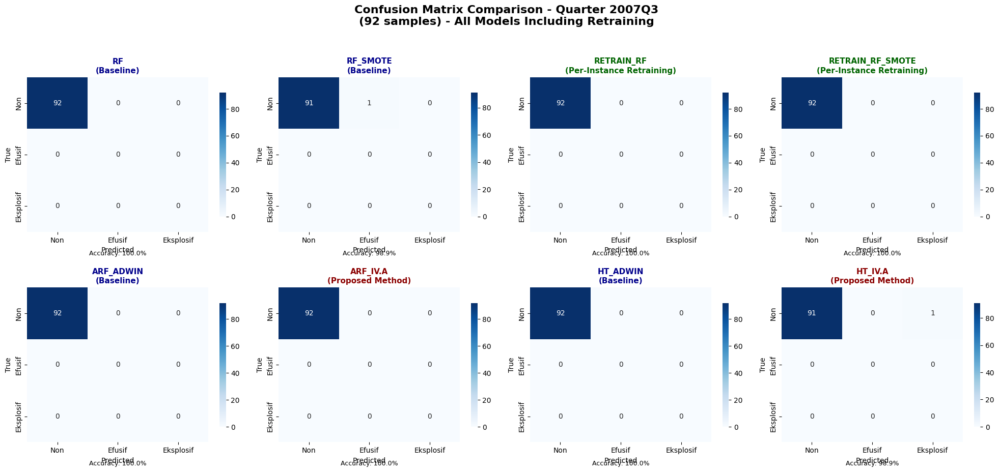


📈 Quarter 2007Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  98.9% | F1: 0.995
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  98.9% | F1: 0.995

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2007Q3.png



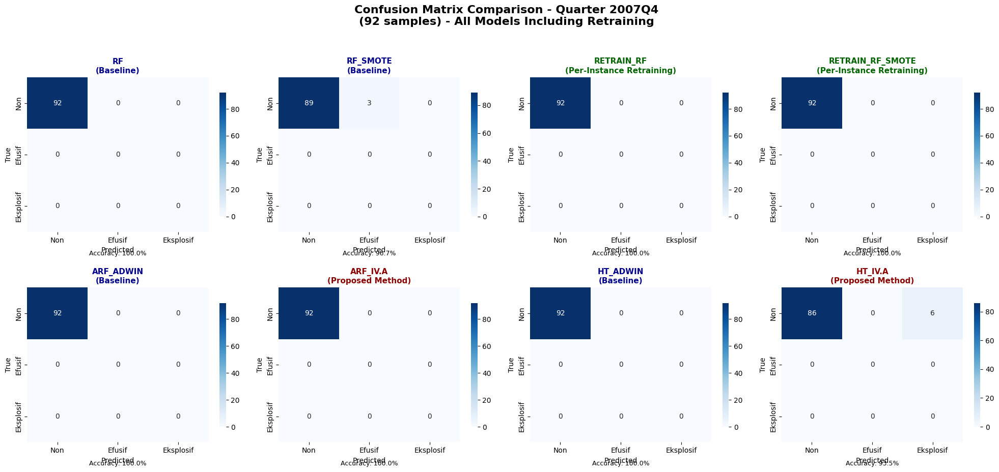


📈 Quarter 2007Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  96.7% | F1: 0.983
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  93.5% | F1: 0.966

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2007Q4.png



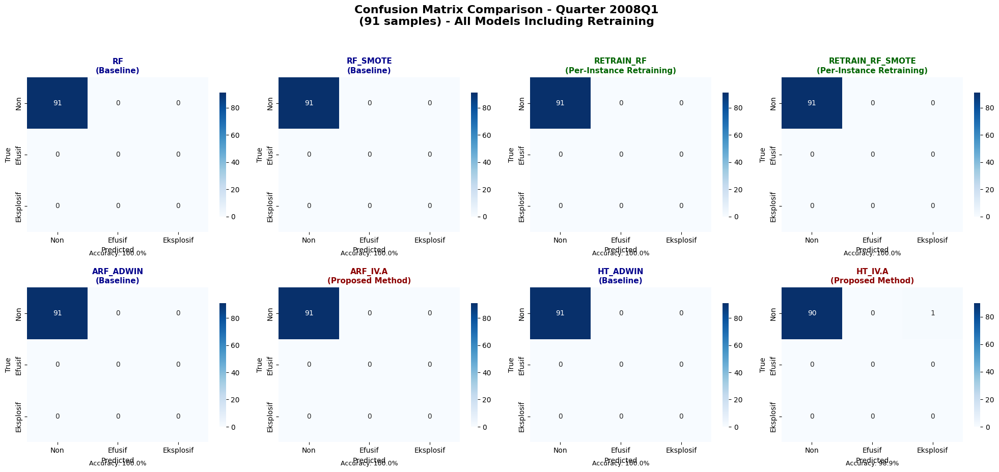


📈 Quarter 2008Q1 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  98.9% | F1: 0.994

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2008Q1.png



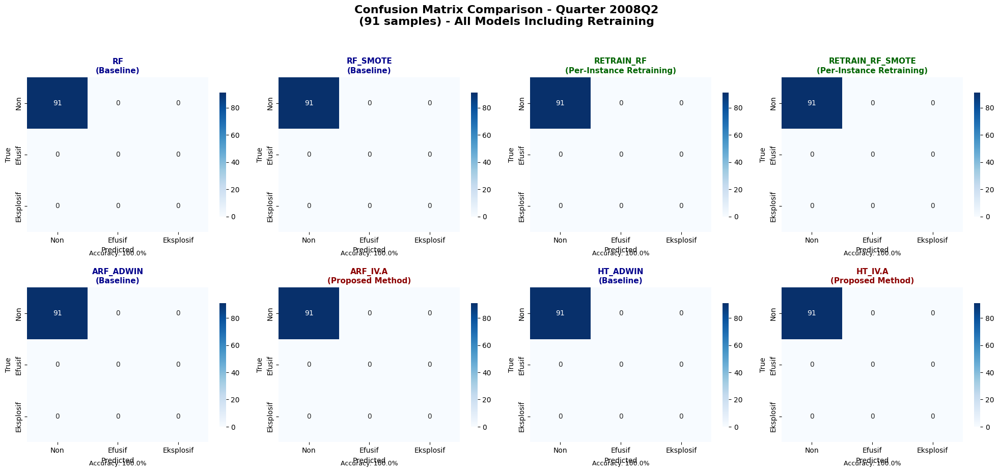


📈 Quarter 2008Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2008Q2.png



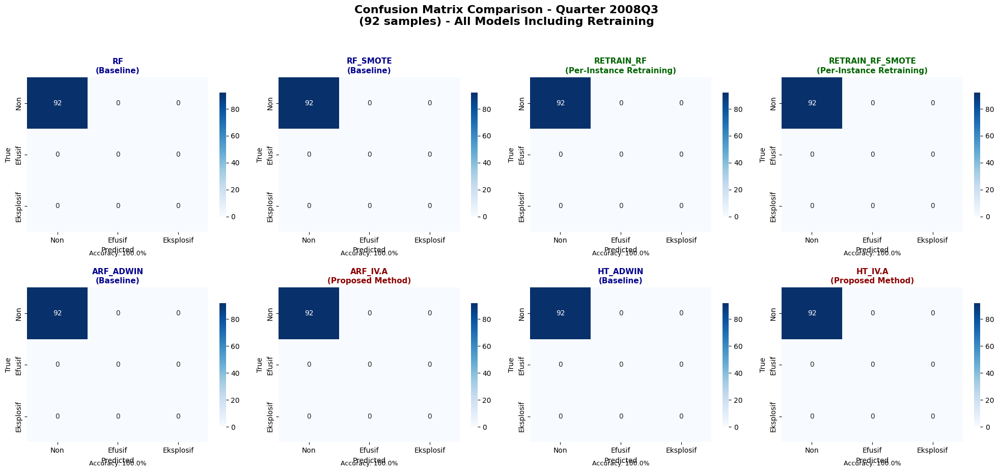


📈 Quarter 2008Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2008Q3.png



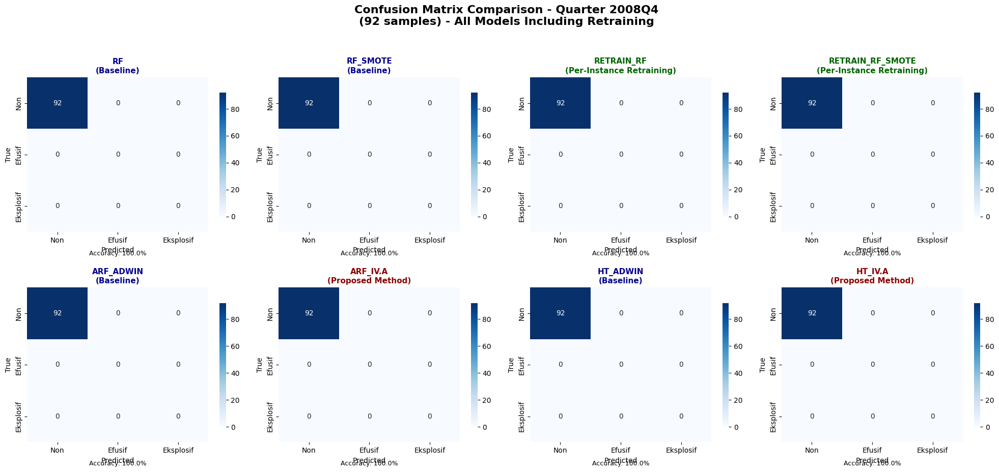


📈 Quarter 2008Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc: 100.0% | F1: 1.000
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2008Q4.png



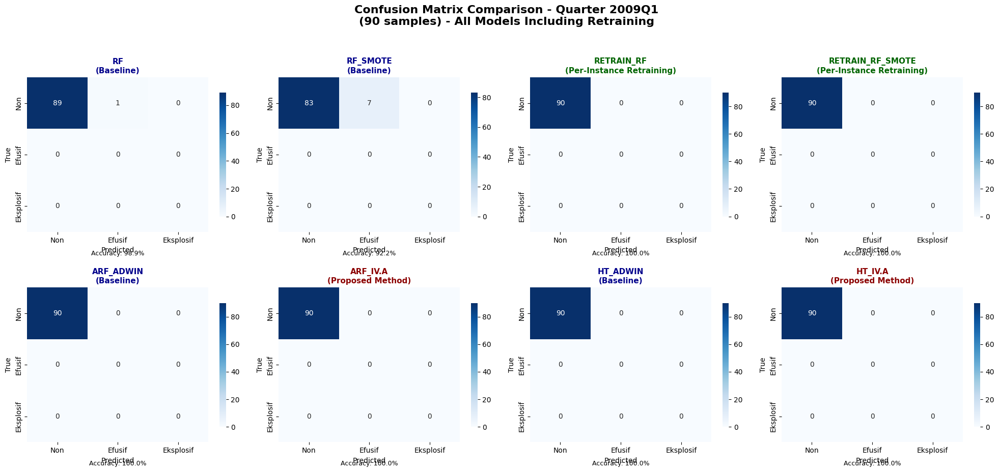


📈 Quarter 2009Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.994
RF_SMOTE             [BASELINE]   Acc:  92.2% | F1: 0.960
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2009Q1.png



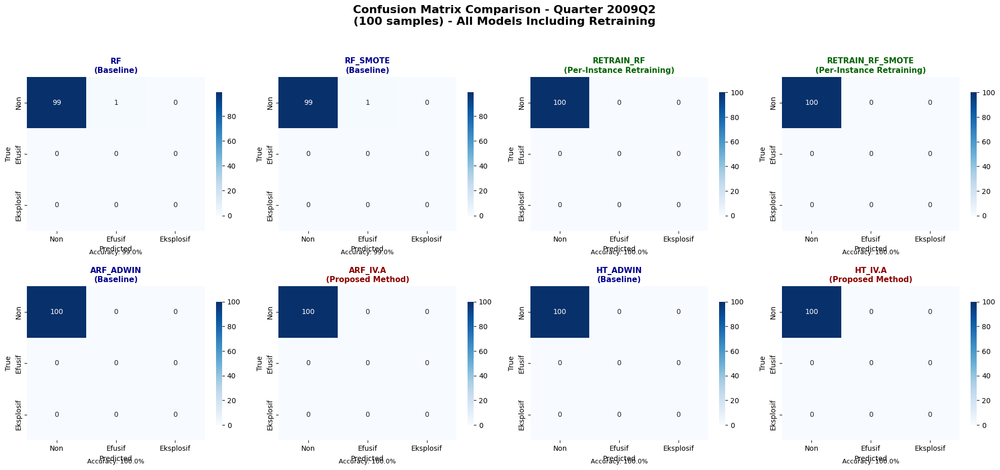


📈 Quarter 2009Q2 Summary (100 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  99.0% | F1: 0.995
RF_SMOTE             [BASELINE]   Acc:  99.0% | F1: 0.995
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2009Q2.png



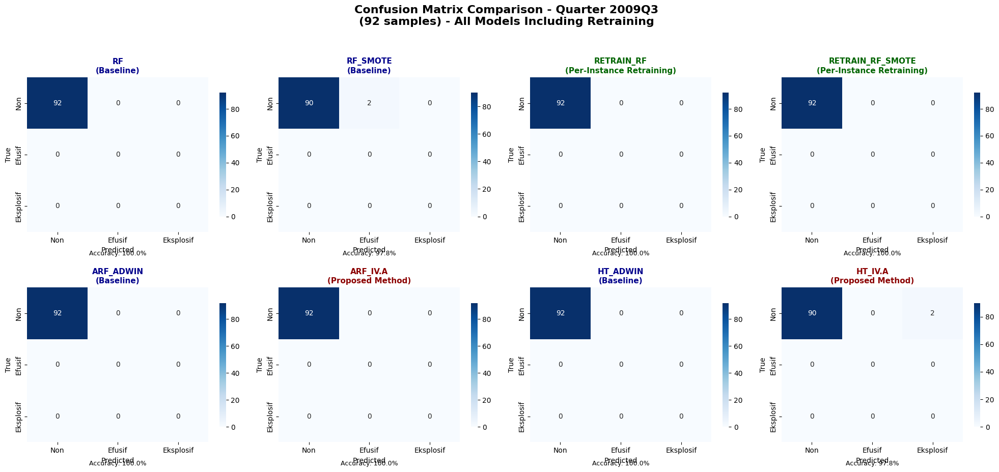


📈 Quarter 2009Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc: 100.0% | F1: 1.000
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc:  97.8% | F1: 0.989

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2009Q3.png



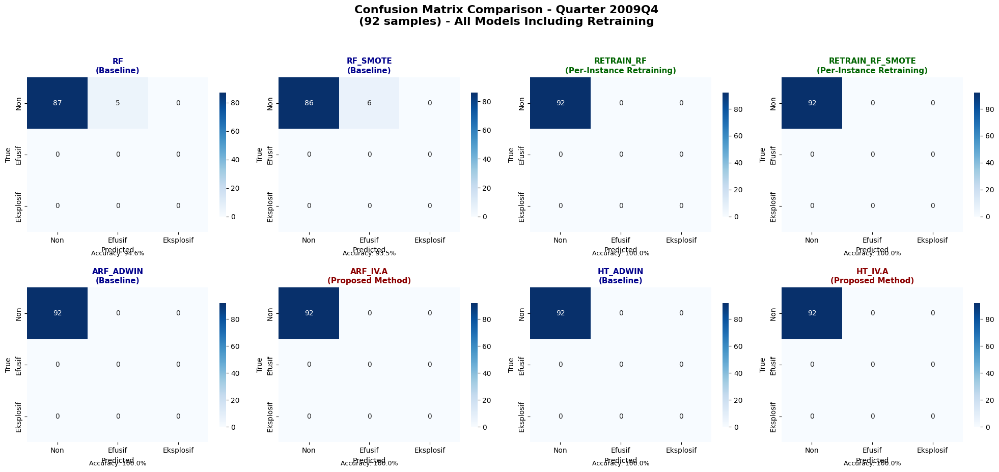


📈 Quarter 2009Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  94.6% | F1: 0.972
RF_SMOTE             [BASELINE]   Acc:  93.5% | F1: 0.966
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2009Q4.png



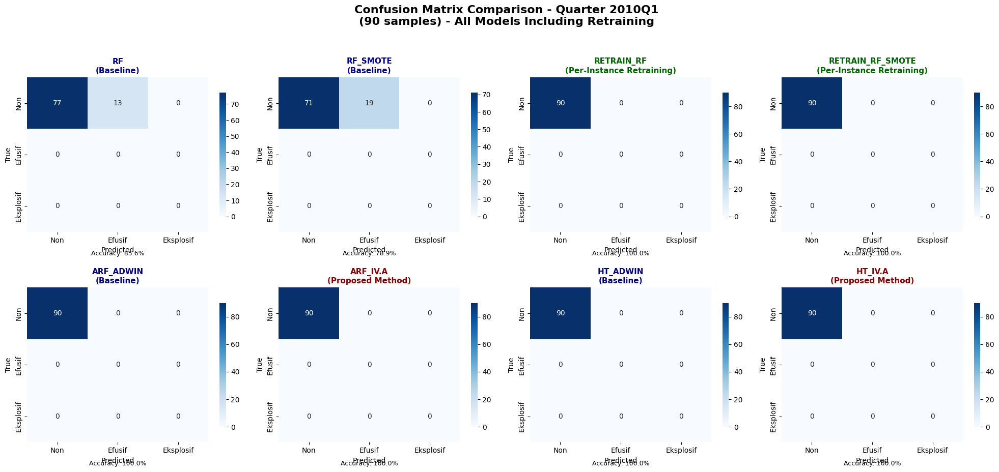


📈 Quarter 2010Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  85.6% | F1: 0.922
RF_SMOTE             [BASELINE]   Acc:  78.9% | F1: 0.882
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2010Q1.png



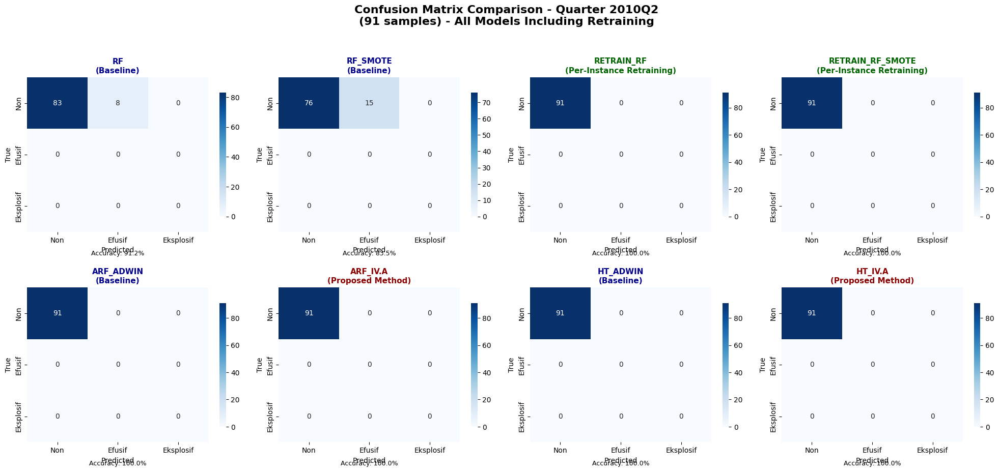


📈 Quarter 2010Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  91.2% | F1: 0.954
RF_SMOTE             [BASELINE]   Acc:  83.5% | F1: 0.910
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2010Q2.png



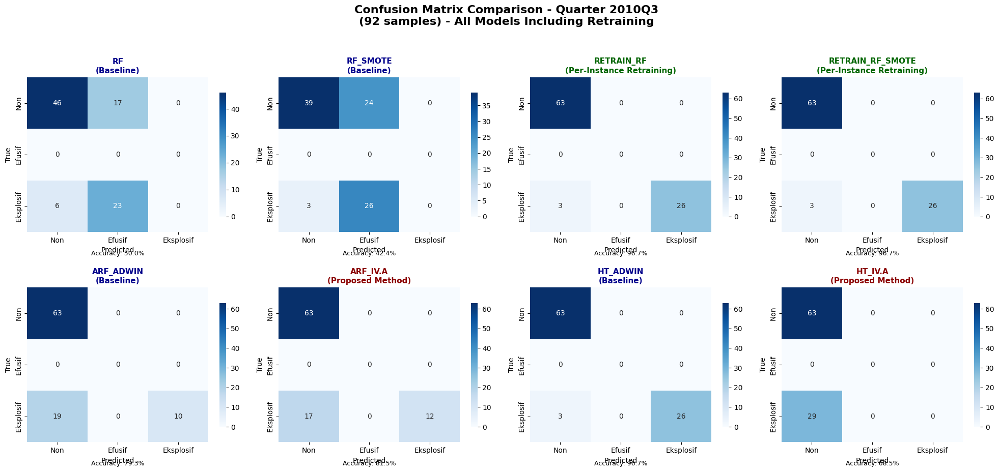


📈 Quarter 2010Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  50.0% | F1: 0.548
RF_SMOTE             [BASELINE]   Acc:  42.4% | F1: 0.509
RETRAIN_RF           [RETRAINING] Acc:  96.7% | F1: 0.967
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  96.7% | F1: 0.967
ARF_ADWIN            [BASELINE]   Acc:  79.3% | F1: 0.757
ARF_IV.A             [PROPOSED]   Acc:  81.5% | F1: 0.788
HT_ADWIN             [BASELINE]   Acc:  96.7% | F1: 0.967
HT_IV.A              [PROPOSED]   Acc:  68.5% | F1: 0.557

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2010Q3.png



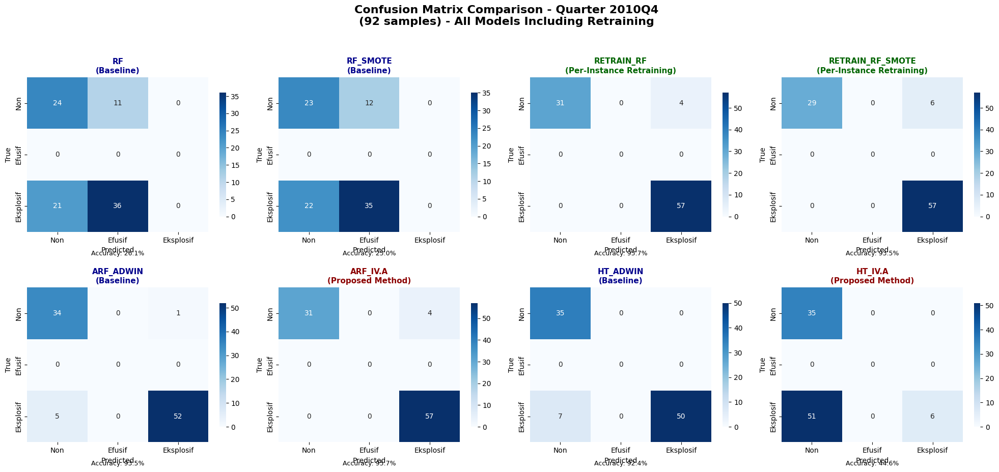


📈 Quarter 2010Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  26.1% | F1: 0.228
RF_SMOTE             [BASELINE]   Acc:  25.0% | F1: 0.219
RETRAIN_RF           [RETRAINING] Acc:  95.7% | F1: 0.956
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  93.5% | F1: 0.933
ARF_ADWIN            [BASELINE]   Acc:  93.5% | F1: 0.935
ARF_IV.A             [PROPOSED]   Acc:  95.7% | F1: 0.956
HT_ADWIN             [BASELINE]   Acc:  92.4% | F1: 0.925
HT_IV.A              [PROPOSED]   Acc:  44.6% | F1: 0.338

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2010Q4.png



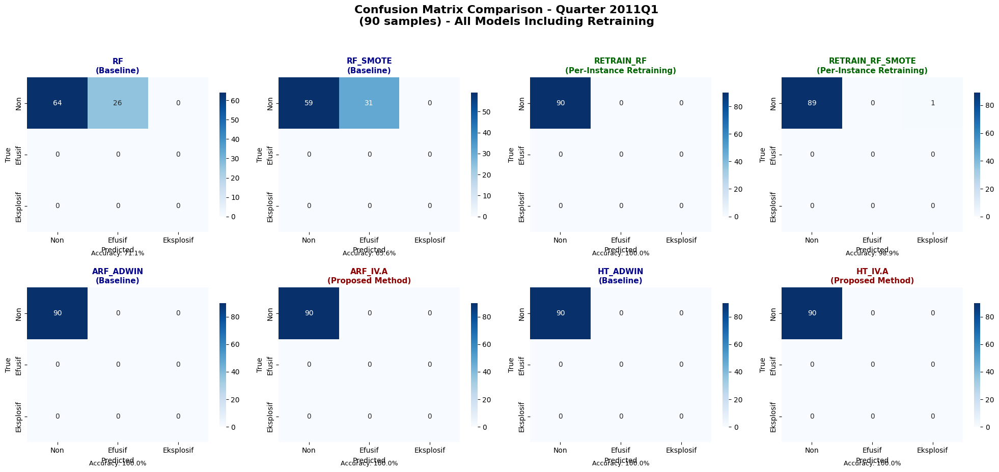


📈 Quarter 2011Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  71.1% | F1: 0.831
RF_SMOTE             [BASELINE]   Acc:  65.6% | F1: 0.792
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  98.9% | F1: 0.994
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2011Q1.png



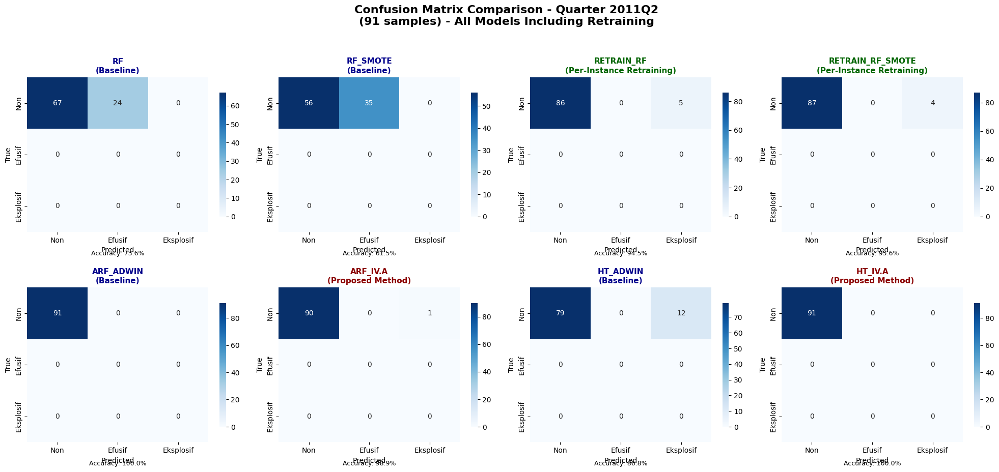


📈 Quarter 2011Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  73.6% | F1: 0.848
RF_SMOTE             [BASELINE]   Acc:  61.5% | F1: 0.762
RETRAIN_RF           [RETRAINING] Acc:  94.5% | F1: 0.972
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  95.6% | F1: 0.978
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc:  98.9% | F1: 0.994
HT_ADWIN             [BASELINE]   Acc:  86.8% | F1: 0.929
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2011Q2.png



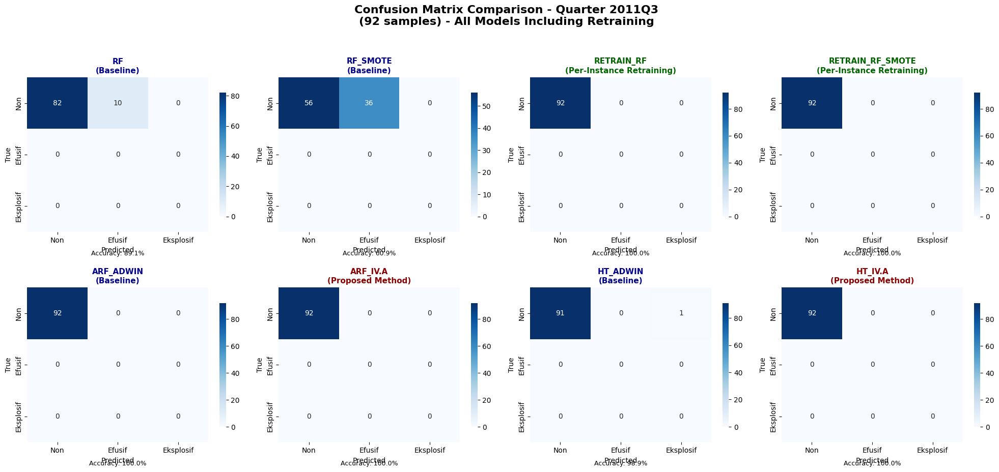


📈 Quarter 2011Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  89.1% | F1: 0.943
RF_SMOTE             [BASELINE]   Acc:  60.9% | F1: 0.757
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc:  98.9% | F1: 0.995
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2011Q3.png



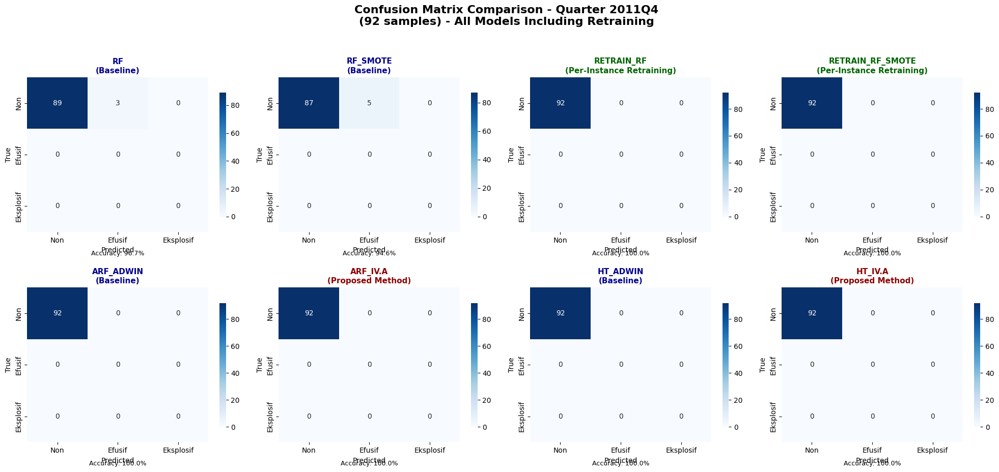


📈 Quarter 2011Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  96.7% | F1: 0.983
RF_SMOTE             [BASELINE]   Acc:  94.6% | F1: 0.972
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2011Q4.png



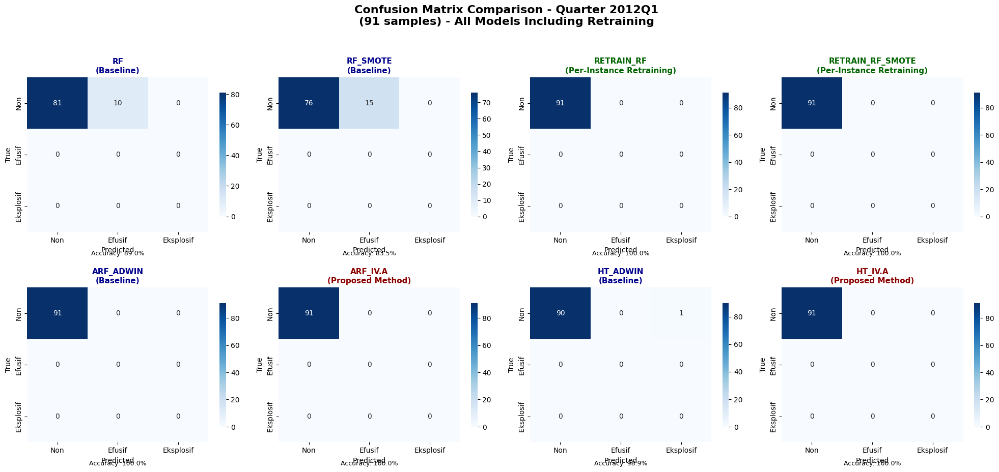


📈 Quarter 2012Q1 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  89.0% | F1: 0.942
RF_SMOTE             [BASELINE]   Acc:  83.5% | F1: 0.910
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc:  98.9% | F1: 0.994
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2012Q1.png



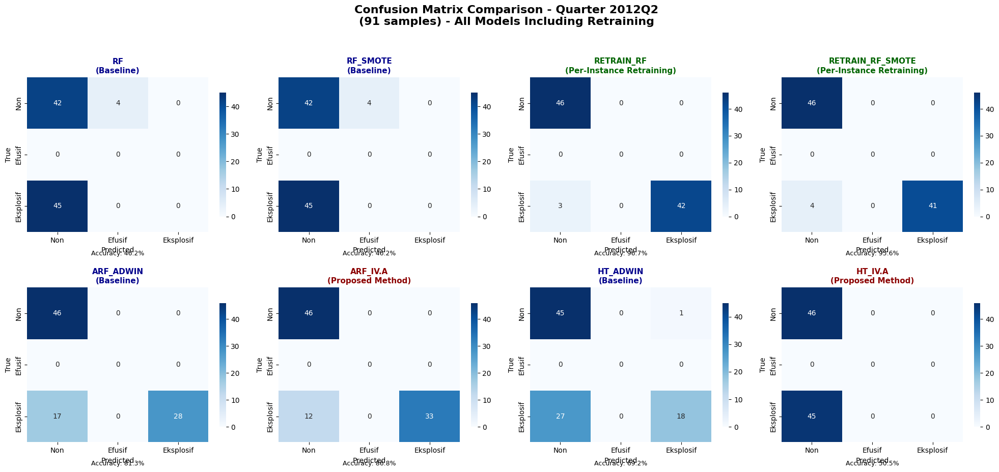


📈 Quarter 2012Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  46.2% | F1: 0.319
RF_SMOTE             [BASELINE]   Acc:  46.2% | F1: 0.319
RETRAIN_RF           [RETRAINING] Acc:  96.7% | F1: 0.967
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  95.6% | F1: 0.956
ARF_ADWIN            [BASELINE]   Acc:  81.3% | F1: 0.806
ARF_IV.A             [PROPOSED]   Acc:  86.8% | F1: 0.866
HT_ADWIN             [BASELINE]   Acc:  69.2% | F1: 0.664
HT_IV.A              [PROPOSED]   Acc:  50.5% | F1: 0.339

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2012Q2.png



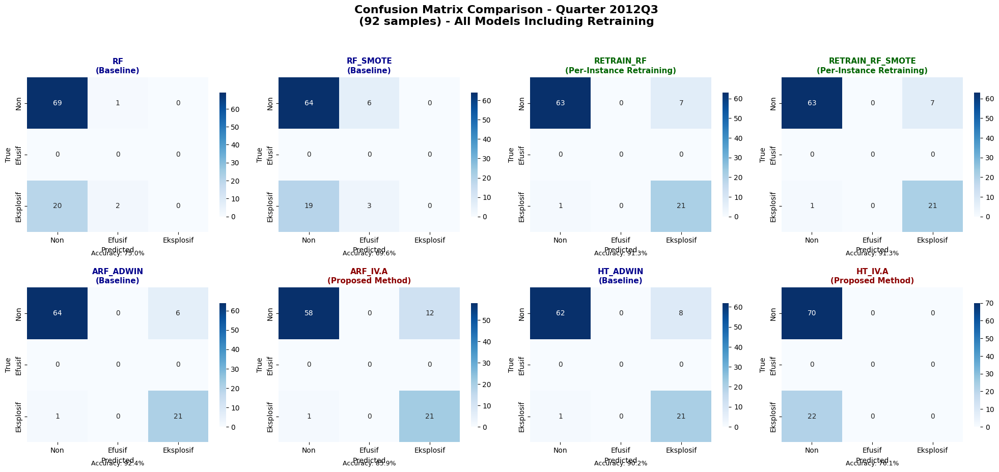


📈 Quarter 2012Q3 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  75.0% | F1: 0.660
RF_SMOTE             [BASELINE]   Acc:  69.6% | F1: 0.637
RETRAIN_RF           [RETRAINING] Acc:  91.3% | F1: 0.916
RETRAIN_RF_SMOTE     [RETRAINING] Acc:  91.3% | F1: 0.916
ARF_ADWIN            [BASELINE]   Acc:  92.4% | F1: 0.926
ARF_IV.A             [PROPOSED]   Acc:  85.9% | F1: 0.867
HT_ADWIN             [BASELINE]   Acc:  90.2% | F1: 0.906
HT_IV.A              [PROPOSED]   Acc:  76.1% | F1: 0.658

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2012Q3.png



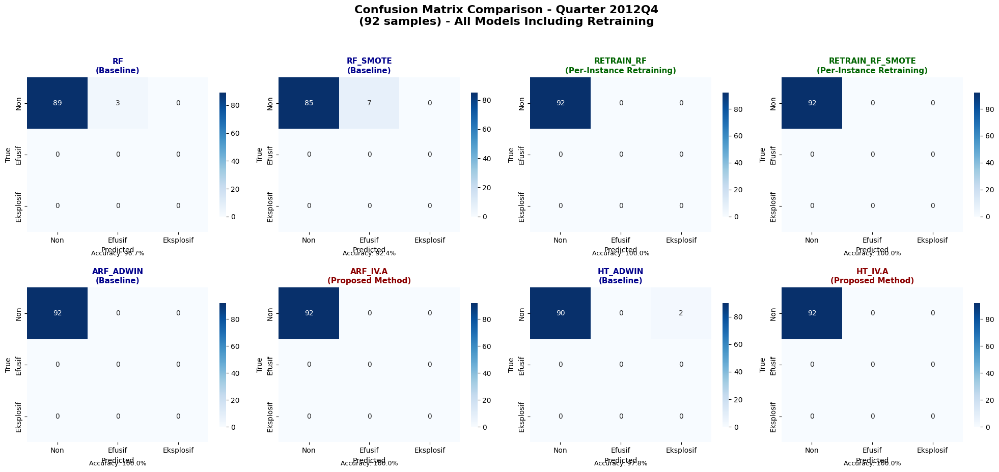


📈 Quarter 2012Q4 Summary (92 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  96.7% | F1: 0.983
RF_SMOTE             [BASELINE]   Acc:  92.4% | F1: 0.960
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc:  97.8% | F1: 0.989
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2012Q4.png



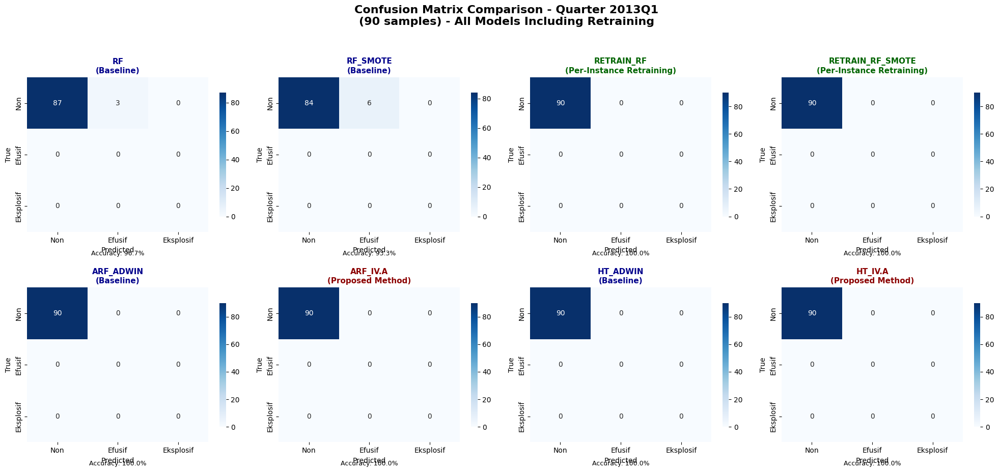


📈 Quarter 2013Q1 Summary (90 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  96.7% | F1: 0.983
RF_SMOTE             [BASELINE]   Acc:  93.3% | F1: 0.966
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2013Q1.png



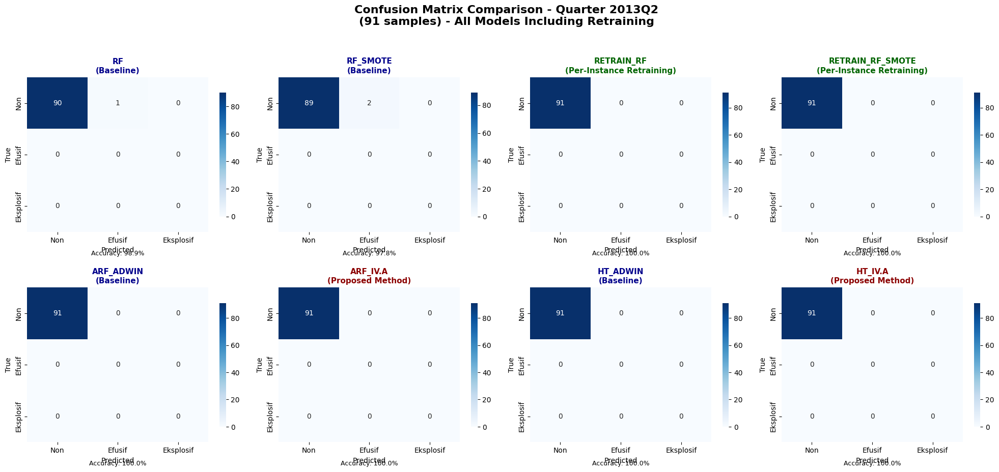


📈 Quarter 2013Q2 Summary (91 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  98.9% | F1: 0.994
RF_SMOTE             [BASELINE]   Acc:  97.8% | F1: 0.989
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2013Q2.png



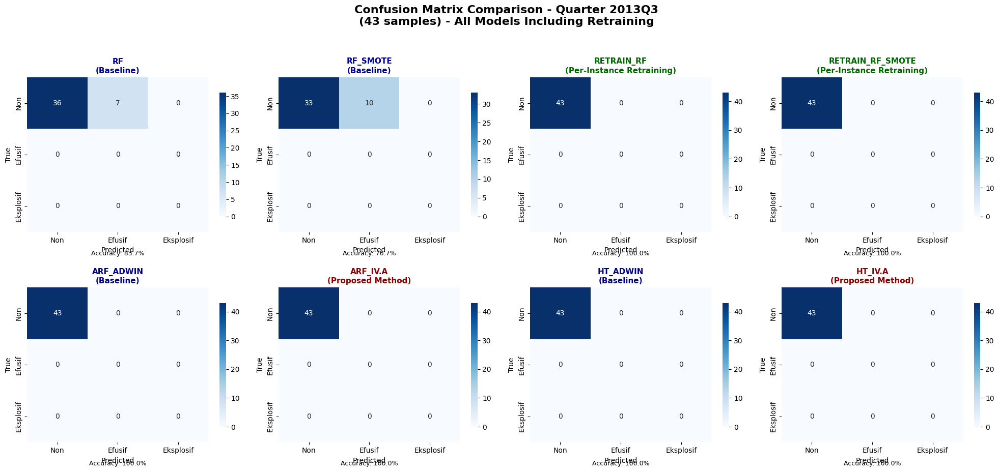


📈 Quarter 2013Q3 Summary (43 samples):
---------------------------------------------------------------------------
RF                   [BASELINE]   Acc:  83.7% | F1: 0.911
RF_SMOTE             [BASELINE]   Acc:  76.7% | F1: 0.868
RETRAIN_RF           [RETRAINING] Acc: 100.0% | F1: 1.000
RETRAIN_RF_SMOTE     [RETRAINING] Acc: 100.0% | F1: 1.000
ARF_ADWIN            [BASELINE]   Acc: 100.0% | F1: 1.000
ARF_IV.A             [PROPOSED]   Acc: 100.0% | F1: 1.000
HT_ADWIN             [BASELINE]   Acc: 100.0% | F1: 1.000
HT_IV.A              [PROPOSED]   Acc: 100.0% | F1: 1.000

✅ Saved and shown: confusion_matrices_per_quarter_with_retraining\confusion_matrix_all_models_2013Q3.png


🎉 All confusion matrices generated and saved successfully!
📁 Check folder: confusion_matrices_per_quarter_with_retraining
📊 Total files created: 55

📊 Generating overall summary confusion matrix...


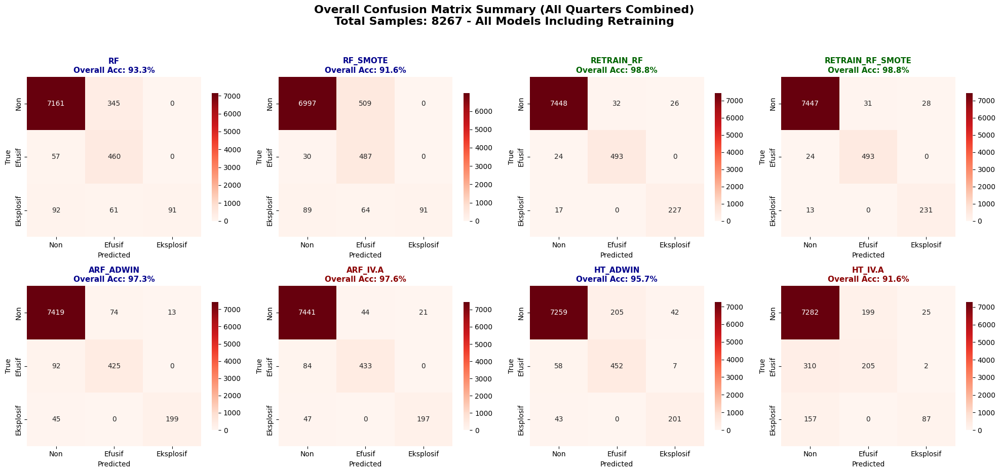

✅ Overall summary saved: confusion_matrices_per_quarter_with_retraining\confusion_matrix_overall_summary.png
🎯 Confusion matrix analysis completed!


In [15]:
import os  # Pastikan modul os telah diimpor

# Buat folder output jika belum ada
output_folder = 'confusion_matrices_per_quarter_with_retraining'
os.makedirs(output_folder, exist_ok=True)

# Update eval_df to include retraining models
eval_df = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'RETRAIN_RF': retrain_rf_pred,  # Add retraining RF
    'RETRAIN_RF_SMOTE': retrain_rf_smote_pred,  # Add retraining RF + SMOTE
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_IV.A': arf_sel_pred,
    'HT_ADWIN': ht_adwin_pred,
    'HT_IV.A': ht_sel_pred
})

# Tambahkan kolom periodik triwulan
eval_df['Period'] = eval_df['Date'].dt.to_period('Q')

# Ambil semua period unik setelah tahun 2000
periods = sorted(eval_df[eval_df['Date'].dt.year >= 2000]['Period'].unique())

# Updated model layout for 2x4 grid to include all 8 models
models = [
    ['RF', 'RF_SMOTE', 'RETRAIN_RF', 'RETRAIN_RF_SMOTE'],           # Row 1: Static & Retraining baselines
    ['ARF_ADWIN', 'ARF_IV.A', 'HT_ADWIN', 'HT_IV.A']               # Row 2: Incremental learning models
]
labels = ['Non', 'Efusif', 'Eksplosif']

print(f"📊 Generating and saving confusion matrices for {len(periods)} quarters...")
print(f"🔍 Models included: 8 total (Static, Retraining, Incremental)")
print(f"💾 Saving to folder: {output_folder}")

# Loop untuk setiap periode (kuartal)
for period in periods:
    # Buat grid 2 baris x 4 kolom untuk semua 8 model
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))
    quarter_data = eval_df[eval_df['Period'] == period]
    
    # Check if quarter has data
    if quarter_data.empty:
        print(f"⚠️ No data for period {period}, skipping...")
        continue

    # Isi masing-masing subplot dengan confusion matrix
    for row in range(2):
        for col in range(4):
            model = models[row][col]
            ax = axes[row, col]
            
            # Calculate confusion matrix
            cm = confusion_matrix(quarter_data['True'], quarter_data[model], labels=[0, 1, 2])
            
            # Create heatmap with enhanced styling
            sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax,
                        xticklabels=labels, yticklabels=labels,
                        cbar_kws={'shrink': 0.8})
            
            # Set titles with model type indication and color coding
            if model.startswith('RETRAIN'):
                ax.set_title(f'{model}\n(Per-Instance Retraining)', 
                           fontweight='bold', color='darkgreen', fontsize=11)
            elif model in ['ARF_IV.A', 'HT_IV.A']:
                ax.set_title(f'{model}\n(Proposed Method)', 
                           fontweight='bold', color='darkred', fontsize=11)
            else:
                ax.set_title(f'{model}\n(Baseline)', 
                           fontweight='bold', color='darkblue', fontsize=11)
            
            ax.set_xlabel('Predicted', fontsize=10)
            ax.set_ylabel('True', fontsize=10)
            
            # Add accuracy score on each subplot
            accuracy = (cm.diagonal().sum() / cm.sum()) * 100
            ax.text(0.5, -0.15, f'Accuracy: {accuracy:.1f}%', 
                   transform=ax.transAxes, ha='center', fontsize=9)

    # Add comprehensive title
    plt.suptitle(f'Confusion Matrix Comparison - Quarter {period}\n'
                 f'({len(quarter_data)} samples) - All Models Including Retraining', 
                 fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])

    # Simpan gambar ke file PNG dalam folder output
    filename = f'confusion_matrix_all_models_{period}.png'
    filepath = os.path.join(output_folder, filename)
    plt.savefig(filepath, dpi=300, bbox_inches='tight')  # Simpan dalam resolusi tinggi

    # Tampilkan hasil plot ke layar
    plt.show()

    # Tutup gambar untuk menghemat memori
    plt.close(fig)

    # Print detailed quarter summary
    print(f"\n📈 Quarter {period} Summary ({len(quarter_data)} samples):")
    print("-" * 75)
    
    # Calculate per-model accuracy and F1-score for this quarter
    for row in range(2):
        for col in range(4):
            model = models[row][col]
            cm = confusion_matrix(quarter_data['True'], quarter_data[model], labels=[0, 1, 2])
            accuracy = (cm.diagonal().sum() / cm.sum()) * 100
            
            # Calculate F1-score for this quarter
            from sklearn.metrics import f1_score
            f1 = f1_score(quarter_data['True'], quarter_data[model], average='weighted', zero_division=0)
            
            # Model type indicator
            model_type = ""
            if model.startswith('RETRAIN'):
                model_type = "[RETRAINING]"
            elif model in ['ARF_IV.A', 'HT_IV.A']:
                model_type = "[PROPOSED]  "
            else:
                model_type = "[BASELINE]  "
            
            print(f"{model:20} {model_type} Acc: {accuracy:5.1f}% | F1: {f1:.3f}")
    
    # Cetak konfirmasi bahwa gambar sudah disimpan
    print(f"\n✅ Saved and shown: {filepath}")
    print("=" * 75 + "\n")

print(f"\n🎉 All confusion matrices generated and saved successfully!")
print(f"📁 Check folder: {output_folder}")
print(f"📊 Total files created: {len([f for f in os.listdir(output_folder) if f.endswith('.png')])}")

# === OPTIONAL: Generate and save overall summary ===
print("\n📊 Generating overall summary confusion matrix...")

# Calculate overall confusion matrices (aggregated across all quarters)
overall_cms = {}
for row in range(2):
    for col in range(4):
        model = models[row][col]
        overall_cm = confusion_matrix(eval_df['True'], eval_df[model], labels=[0, 1, 2])
        overall_cms[model] = overall_cm

# Plot overall comparison
fig, axes = plt.subplots(2, 4, figsize=(20, 10))
for row in range(2):
    for col in range(4):
        model = models[row][col]
        ax = axes[row, col]
        cm = overall_cms[model]
        
        sns.heatmap(cm, annot=True, fmt='d', cmap='Reds', ax=ax,
                    xticklabels=labels, yticklabels=labels,
                    cbar_kws={'shrink': 0.8})
        
        # Overall accuracy
        accuracy = (cm.diagonal().sum() / cm.sum()) * 100
        
        if model.startswith('RETRAIN'):
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', 
                        fontweight='bold', color='darkgreen', fontsize=11)
        elif model in ['ARF_IV.A', 'HT_IV.A']:
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', 
                        fontweight='bold', color='darkred', fontsize=11)
        else:
            ax.set_title(f'{model}\nOverall Acc: {accuracy:.1f}%', 
                        fontweight='bold', color='darkblue', fontsize=11)
        
        ax.set_xlabel('Predicted', fontsize=10)
        ax.set_ylabel('True', fontsize=10)

plt.suptitle('Overall Confusion Matrix Summary (All Quarters Combined)\n'
             f'Total Samples: {len(eval_df)} - All Models Including Retraining', 
             fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0.05, 1, 0.95])

# Save overall summary
overall_filepath = os.path.join(output_folder, 'confusion_matrix_overall_summary.png')
plt.savefig(overall_filepath, dpi=300, bbox_inches='tight')
plt.show()
plt.close()

print(f"✅ Overall summary saved: {overall_filepath}")
print("🎯 Confusion matrix analysis completed!")

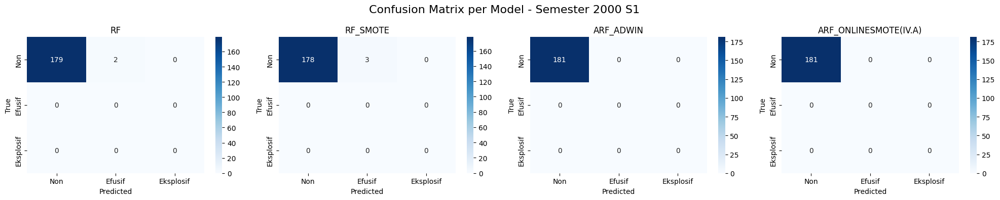

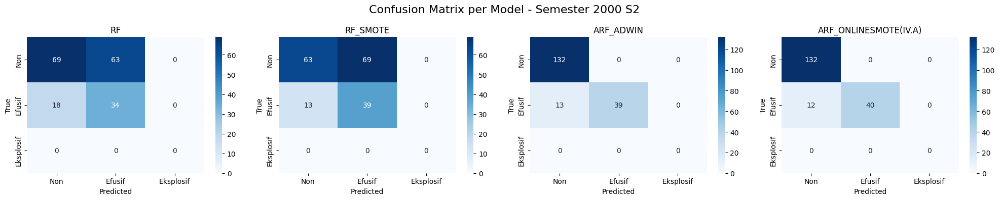

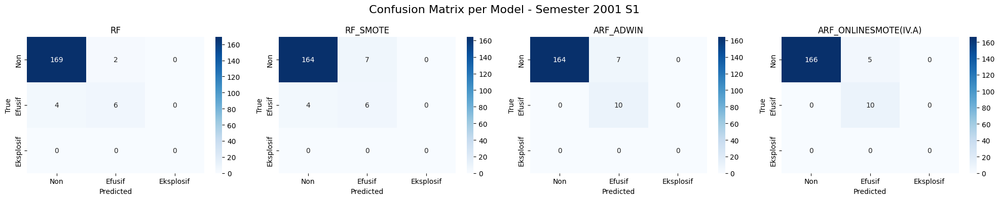

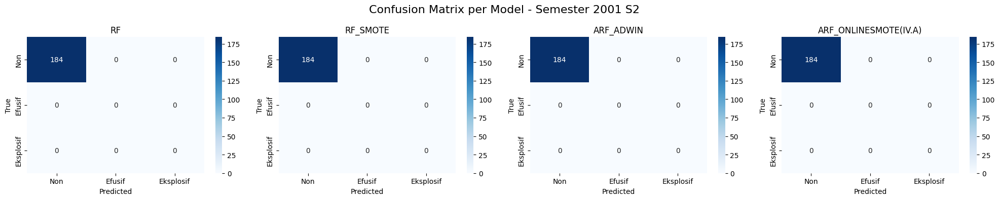

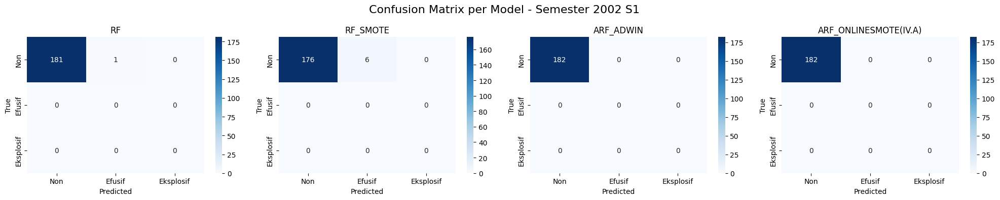

...

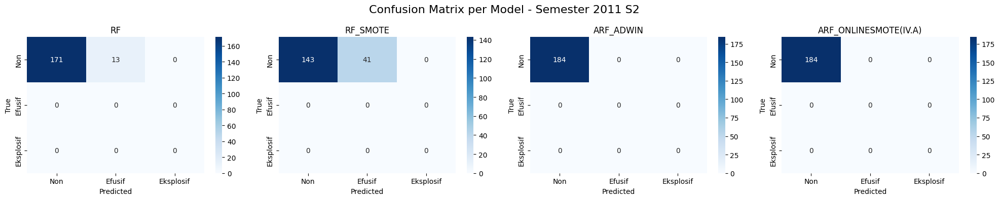

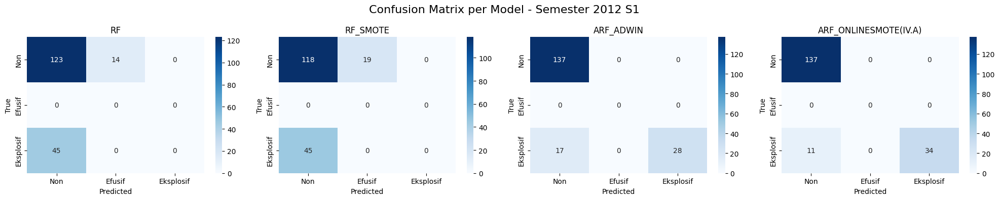

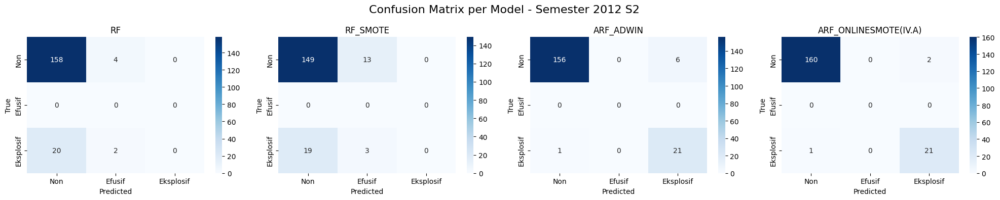

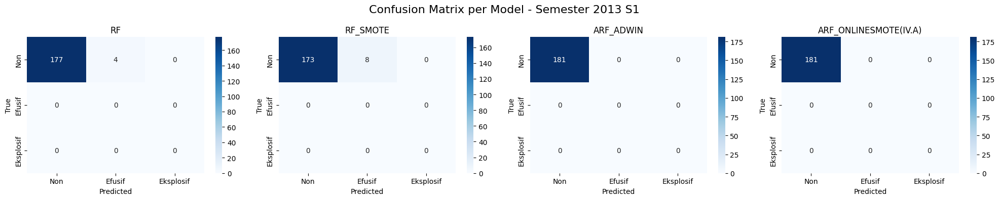

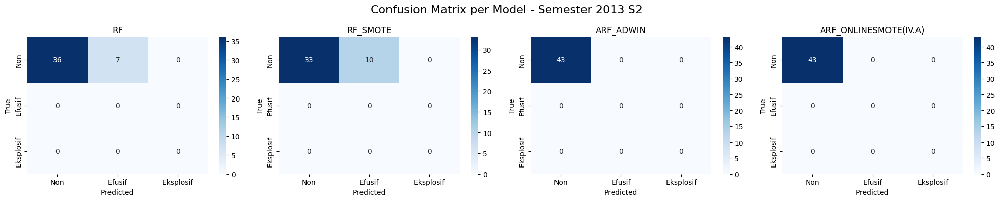

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Pastikan dataframe evaluasi tersedia
eval_df = pd.DataFrame({
    'Date': pd.to_datetime(dates_stream),
    'True': all_true,
    'RF': rf_pred,
    'RF_SMOTE': rf_smote_pred,
    'ARF_ADWIN': arf_adwin_pred,
    'ARF_ONLINESMOTE(IV.A)': arf_sel_pred
})

# Buat kolom semester
eval_df['Semester'] = eval_df['Date'].dt.year.astype(str) + ' S' + ((eval_df['Date'].dt.month - 1) // 6 + 1).astype(str)

# Buat confusion matrix per semester
semesters = sorted(eval_df[eval_df['Date'].dt.year >= 2000]['Semester'].unique())
models = ['RF', 'RF_SMOTE', 'ARF_ADWIN', 'ARF_ONLINESMOTE(IV.A)']
labels = ['Non', 'Efusif', 'Eksplosif']

# Plot 1x4 untuk setiap semester
for sem in semesters:
    fig, axes = plt.subplots(1, 4, figsize=(20, 4))
    sem_data = eval_df[eval_df['Semester'] == sem]

    for i, model in enumerate(models):
        cm = confusion_matrix(sem_data['True'], sem_data[model], labels=[0, 1, 2])
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i],
                    xticklabels=labels, yticklabels=labels)
        axes[i].set_title(f'{model}')
        axes[i].set_xlabel('Predicted')
        axes[i].set_ylabel('True')

    plt.suptitle(f'Confusion Matrix per Model - Semester {sem}', fontsize=16)
    plt.tight_layout()
    plt.show()


NameError: name 'adwin_drift_point' is not defined

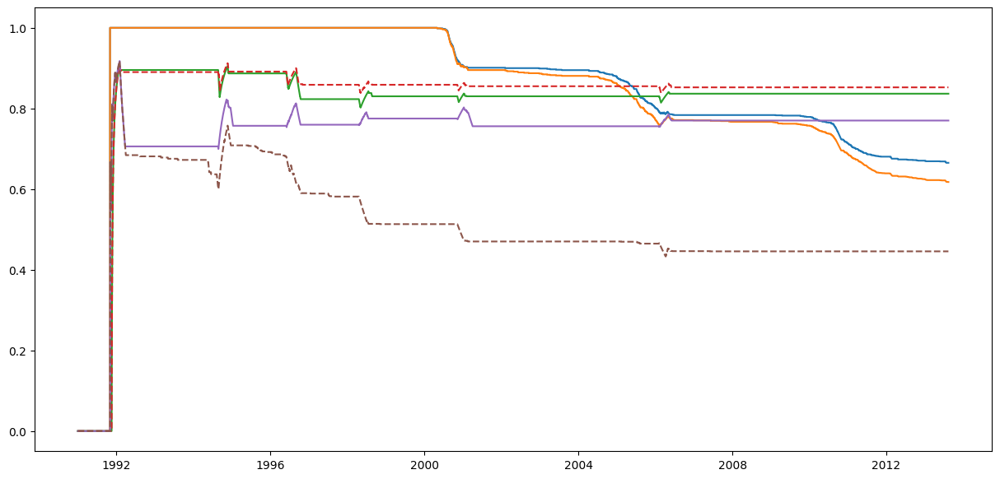

In [ ]:
import datetime

# Ensure your dates are datetime objects; if not, convert them:
threshold_date = datetime.datetime.strptime('1999-12-31', '%Y-%m-%d')

plt.figure(figsize=(15,7))
plt.plot(dates_stream, cum_f1_rf, label='Static RF (train ≤ 2000)')
plt.plot(dates_stream, cum_f1_rf_smote, label='RF + SMOTE')
plt.plot(dates_stream, cum_f1_adwin, label='ARF + ADWIN')
plt.plot(dates_stream, cum_f1_iva, label='ARF IV.A (Online SMOTE)', linestyle='--')
plt.plot(dates_stream, cum_f1_ht_adwin, label='HT + ADWIN')
plt.plot(dates_stream, cum_f1_ht_iva, label='HT IV.A (Online SMOTE)', linestyle='--')

# Plot vertical lines for drift points
for dp in adwin_drift_point:
    if dates[dp] <= threshold_date:  # only mark drift lines within xlim range
        plt.axvline(x=dates[dp], color='red', linestyle=':', alpha=0.2)

plt.xlabel('Date')
plt.ylabel('Cumulative F1-Score')
plt.title('Cumulative F1-Score per Instance Over Time')
plt.ylim(0.75, 1.05)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
